In [2]:
import cv2
from matplotlib import pyplot as plt
import numpy as np
import os
import scipy.signal as sgn

In [3]:
# Ivo's implemetation of Ellipse class

class Ellipse:

    C : np.array #homogeneous conic matrix x'*C*x=0

    def __init__( self, C : np.array ):

        self.C = C
        

    @classmethod
    def estimate_ellipsoid( cls, points : np.array ):
        """
        C = estimate_ellipsoid_2D ( points )
        ----------------------------------

        estimates a homogeneous ellipsoid C
        
        x'*C*x = 0
        
        from a number of point samples 
        (in a least squares sense)
        
        format of points

                [ x^1_1 . . . . .  x^N_1 ] 
                [  .                 .   ]
        points = [  .                 .   ]
                [  .                 .   ]
                [ x^1_n . . . . .  x^N_n ]
                [  1    . . . . .    1   ]

        where each point is element R^n
        and there are N points, the points  
        have to be in homogeneous coordinates.
        
        """

        n = points.shape[0]
        print(n)
        num_entries = int((n+1) * n/2)
        
        if points.shape[1] < num_entries-1:
            print('insufficient number of points, need at least {}'.format( num_entries-1 ) )
    
        # --------------  estimate ellipse ---------------

        # assemble linear system
        A = np.zeros( [points.shape[ 1 ], num_entries ] )

        #for all points
        for i in range( 0, points.shape[ 1 ] ):
        
            #extract point
            x = np.array([points[:, i]]).T
            #print(x)
            X  = np.matmul( x, x.T )
            #print(X)
            X2 = X.T + X - np.diag( np.diag( X ) )

            #print(X2)
            row = X2[ np.where( np.triu( np.ones( X2.shape ) ) ) ]
            #print(row)

            A[ i, : ] = row

        #print(A)

        #solve for null space 
        U,D,V = np.linalg.svd( A )

        ell = V[-1,:]


        #create conic matrix
        Cd = np.zeros( X2.shape )

        Cd[ np.where( np.triu( np.ones( X2.shape ) ) ) ] = ell

        C = Cd + Cd.T - np.diag( np.diag ( Cd ) )

        #detC =  np.linalg.det( C[0:-1,0:-1] )

        #print(detC)

        if Ellipse.is_hyperboloid( C ):
            print('Warning: result is a hyperboloid!')
        

        if Ellipse.is_paraboloid( C ):
            print('Warning: result is a paraboloid!')
        
        return C

    @classmethod
    def cov_mean_to_ellipsoid( cls, cov, mean, k ):
        """
            C = cov_mean_to_ellipsoid_homog ( Cov, Mean, k )
            ----------------------------------
        
            generates a homogeneous ellipsoid C
            
            x'*C*x = 0
        
            from covariance matrix and mean value
            of a gaussian distribution
            
            k is a confidence factor determibed by the chi^2 
            distribution. The probability that x is inside 
            the ellipsoid is P_{chi^2}(k,2). Some values 
            for k are 2.41 (70%) and k=5.99 (95%).
            
            cov  : np.array - covariance matrix (non-homogeneous)
            mean : np.array - mean value (vector)
            k : float - confidence factor, see above 

        """

        #column vector, assume we get a 1D array
        mean = np.array( [mean] ).T

        SIGMAinv = np.linalg.inv( cov )

        lastentry = np.matmul( mean.T, np.matmul( SIGMAinv, mean ) ) - k 
        C = np.vstack( [ np.hstack( [ SIGMAinv, -np.matmul(SIGMAinv, mean)] ), 
                         np.hstack( [ -np.matmul(mean.T,SIGMAinv), lastentry] ) ] )
        
        return C

    @classmethod
    def srt_to_ellipsoid( cls, S, R, T ): 
        """
         C = srt_to_ellipsoid_homog ( S, R, T )
         ----------------------------------
        
         generates a homogeneous ellipsoid C
         
         x'*C*x = 0
        
         from translation, rotation and scale parts as
        
         x'* (T^-1 * R^-1 * S^-1) ( S * R * T ) x = 0
        
         see: Ivo Ihrke: "Some Notes on Ellipses", TechReport, 2004
        """
        #function C = srt_to_ellipsoid_homog ( S, R, T )


        invT = np.linalg.inv( T )
        invR = R.T
        invS = np.linalg.inv( S )

        left  = np.matmul( invT.T, np.matmul( invR.T, invS.T ) )
        right = np.matmul( invS, np.matmul( invR, invT ) )

        C = np.matmul( left, right )
    
        return C



    @classmethod
    def decompose_ellipsoid( cls, C ):
        """
        
         [S,R,T] = decompose_ellipsoid_homog ( C )
         ----------------------------------
        
         decomposes a homogeneous ellipsoid C
         
         x'*C*x = 0
        
         into translation, rotation and scale parts
        
         x'* (T^-1 * R^-1 * S^-1) ( S * R * T ) x = 0
        
         Note that C \neq (T^-1 * R^-1 * S^-1) ( S * R * T )
         in some cases because the orientation of 
         the ellipsoid's major axis is not fixed.
         The function generates a right handed system.

        """

        #print(C)
        C_ih = C[0:-1,0:-1] 
        #print(C_ih)

        t = -np.matmul( np.linalg.pinv( C_ih ), C[0:-1,-1] )

        T = np.eye( C.shape[ 0 ] )
        T[0:-1, -1 ] = t

        U,D,V = np.linalg.svd( C_ih )

        R = np.eye( C.shape[ 0 ] )
        R[0:-1,0:-1] = V


        #S = R' * T' * C * T * R;
        S = np.matmul( R.T, np.matmul( T.T, np.matmul( C, np.matmul( T, R ) ) ) )

        S = S / S[-1,-1]

        S = np.sqrt( np.diag(1/abs(np.diag(S))))

        return S, R, T

    @classmethod
    def is_ellipsoid( cls, C ):
        """
         bool = is_ellipsoid_homog ( C )
         ----------------------------------
        
         determines whether homogeneous conic C
         
         x'*C*x = 0
         
         is an ellipsoid
        """

        #function val = conic_is_ellipsoid_homog ( C )

        detC =  np.linalg.det( C[0:-1,0:-1] )

        return detC > 0


    @classmethod
    def is_hyperboloid( cls, C ):
        """
         bool = is_hyperboloid_homog ( C )
         ----------------------------------
        
         determines whether homogeneous conic C
         
         x'*C*x = 0
         
         is a hyperboloid
        """

        
        detC =  np.linalg.det( C[0:-1,0:-1] )

        return detC < 0

    @classmethod
    def is_paraboloid( cls, C ):
        """
         bool = is_paraboloid_homog ( C )
         ----------------------------------
        
         determines whether homogeneous conic C
         
         x'*C*x = 0
         
         is a paraboloid
        """

        
        detC =  np.linalg.det( C[0:-1,0:-1] )

        #maybe with EPS ?
        return detC == 0


    def get_center( self ):
        
        S,R,T = self.decompose_ellipsoid( self.C )


        return [ T[2,0], T[2,1] ]


    def plot( self, ax, **kwargs ):
        """
        plot_ellipsoid_2D ( C, style, N )
        ----------------------------------
        
        plots a homogeneous ellipsoid C
        
        x'*C*x = 0
        
        style is a matlab plot style, e.g. 'b-' (default)
        N is the number of polygon segments to 
        approximate the ellipse
        """

        #function plot_ellipsoid_homog_2d ( C, style, N )

        if not 'style' in locals():
            style = 'b-'

        if not 'N' in locals():
            N = 100



        angles = np.linspace( -np.pi, np.pi, N )

        # generate a unit circle or a unit hyperbola
        if ( Ellipse.is_ellipsoid( self.C ) ):
            #uc  = [ cos(x); sin(x); ones(size(x)) ];
            x  = np.cos( angles )
            y  = np.sin( angles )
            w  = np.ones( angles.shape )

            uc = np.vstack([x,y,w])

        else:
            EPS = 0.1
            x   =  np.linspace( -np.pi/2+EPS, np.pi/2-EPS, int( N/2 ) )#-(pi/2-EPS):((pi-2*EPS)/(N/2)):(pi/2-EPS);
            x2  =  np.linspace( np.pi/2+EPS, 3*np.pi/2-EPS, int( N/2 ) )  #x2 =  (pi/2+EPS):((pi-2*EPS)/(N/2)):(3*pi/2-EPS);
            uc  = np.vstack( [ 1/np.cos(x), np.tan(x), np.ones( x.shape ) ] )
            uc2 = np.vstack( [ 1/np.cos(x2), np.tan(x2), np.ones( x2.shape ) ] )
        
        #decompose
        S,R,T = Ellipse.decompose_ellipsoid( self.C )

        #transform unit circle or parabola 
        transform = np.matmul( T, np.matmul( R, S ) )
        ell  =  np.matmul( transform, uc )

        if 'uc2' in locals():
            ell2  =  np.matmul( transform, uc2 )
            ax.plot( ell2[0,:], ell2[1,:], style )

   
        #plot conic
        ax.plot( ell[0,:], ell[1,:], style )

        #plot coordinate system
        tx = T[0,2]
        ty = T[1,2]
        
#         print(tx, ty)

        smin = S[0,0]
        smaj = S[1,1] 

        ax.plot( np.array( [ tx, tx+smin*R[0,0] ] ), np.array( [ ty, ty+smin*R[1,0] ] ), 'r' )
        ax.plot( np.array( [ tx, tx+smaj*R[0,1] ] ), np.array( [ ty, ty+smaj*R[1,1] ] ), 'b' )

        ax.set_aspect('equal', adjustable='box')
        return (tx, ty)

In [4]:
def fit_ellipse(path_dir_w_time, ifHull=False, date_now=""):
        """ Find and fit an ellipse in an image.
        it should be run on a normalized image I (normalization should exclude dead pixels which are artificially maximum)
        Parameters
        ----------
        path_dir_w_time : str
            _description_
        date_now : str
            _description_

        Returns
        -------
        Ellipse
            Ellipse in an image.
        """
        
        I_temp = plt.imread(path_dir_w_time)[:,:,1].astype(float)/255
        I = old_rplc_dead_px_med(I_temp)

        ellipsoid_points=[]

        if ifHull == False:
            #every Nth scanline should be sampled
            START_SCANLINE = 50 #there are some weird effects on the zero scanline that lead to detection of erroneous points
            DELTA_SCANLINE = 100

            #need to filter enough such that the big jump into and out of the disc has indeed the largest magnitude derivative
            FILTERWIDTH=250
            x=np.linspace(-4,4,FILTERWIDTH)
            gauss=np.exp(-x**2)


            plt.figure(figsize=[18,12])

            for sl in range( START_SCANLINE, I.shape[0]-START_SCANLINE, DELTA_SCANLINE ):
                #print(f'Checking Scanline {sl} ...' )
                #line = self.I[sl]
                line = I[sl, :]

                filtered_line = sgn.convolve(line,gauss,mode='same')
                #crude filter for line intersecting the ring structure
                if np.amax(filtered_line) > 0.9:
                    #print("- scanline intersection ")

                    filtered_deriv = np.diff( filtered_line )

                    #crude extraction - this will probably need improvement
                    max_pos = np.argmax( filtered_deriv )
                    min_pos = np.argmin( filtered_deriv )
                    ellipsoid_points.append([max_pos,sl])
                    ellipsoid_points.append([min_pos,sl]) #add two points on perimeter

                else:
                    #print("- no intersection ")

                    pass
            print(ellipsoid_points)


        else:
            img = np.array(I*255, dtype=np.uint8)
            cnt_img, final_cnt = contour_points(img)

            if final_cnt is None:
                return None, None
            elif final_cnt.shape[0] < 5:
                return None, None
            else:
                ellipsoid_points = np.array(final_cnt).reshape([-1, 2])
        
#         print(ellipsoid_points)
        ellipsoid_points = np.array(ellipsoid_points).astype('float').T
        ellipsoid_points = np.vstack( [ellipsoid_points, np.ones(ellipsoid_points.shape[1])] )
        print(ellipsoid_points)

        #plt.clf()
        #plt.imshow(self.I)
        #plt.show()

        for i in range( 0, ellipsoid_points.shape[1] ):
            plt.plot(ellipsoid_points[0,i],ellipsoid_points[1,i],'rx')

        E = Ellipse( Ellipse.estimate_ellipsoid( ellipsoid_points ) )
        S,R,T=Ellipse.decompose_ellipsoid(E.C)

        plt.plot(T[0,2],T[1,2],'gx')

        plt.imshow(I)
        center = E.plot(plt.gca())
        plt.title(f'ellipsoide fit {1}')
#         plt.savefig(f"{path_dir_w_time}/{date_now}_ledpos_{self.x_pos}_{self.y_pos}_{self.channel}_ellipsoide_fit.png")

        return E, center

def old_rplc_dead_px_med(I_temp):
        """Replace dead pixels by median

        Parameters
        ----------
        I_temp : ndarray
            image to be processed

        Returns
        -------
        ndarray
            clean image where dead pixels are replaced by median 
        """

        Imed = sgn.medfilt2d( I_temp, kernel_size=5 )
        maxI = np.amax( Imed ) #normalize robustly
        I_temp = I_temp / maxI
        #replace dead pixels by median filtered values
        I_temp[ I_temp > 1 ] = Imed[ I_temp > 1 ]

        return I_temp

In [5]:
def contour_points(g_img):

    kernel = np.ones((3, 3), np.uint8)
    gradient = cv2.morphologyEx(g_img, cv2.MORPH_GRADIENT, kernel)

    blur = cv2.GaussianBlur(gradient, (3, 3), 0)
    ret3, th3 = cv2.threshold(blur, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

    gradient_img = np.zeros_like(g_img, dtype=np.uint8)

    contours, _ = cv2.findContours(th3, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    if len(contours) < 2:
        return None, None
    
    cv2.drawContours(gradient_img, contours, -1, 255, 2)

    kernel = np.ones((5, 5), np.uint8)
    cv2.dilate(gradient_img, kernel, iterations = 1)


    hull_img = np.zeros_like(g_img, dtype=np.uint8)

    blur = cv2.GaussianBlur(g_img, (3, 3), 0)
    ret3, th3 = cv2.threshold(blur, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

    contours, _ = cv2.findContours(th3, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    
    if len(contours) < 2:
        return None, None
    
    area_cntrs = [cv2.contourArea(cnt) for cnt in contours]
    max_cntr_index = np.argmax(area_cntrs)
    cnt = contours[max_cntr_index]

    hull = cv2.convexHull(cnt)
    cv2.drawContours(hull_img, [hull], 0, 125, 2)

    op = np.logical_and(gradient_img, hull_img).astype(np.uint8)*255

    op[:10, :] = 0
    op[-10:, :] = 0

    kernel = np.ones((3, 3), np.uint8)
    opening = cv2.morphologyEx(op, cv2.MORPH_OPEN, kernel)
    
    x, y = np.where(opening > 1)
    final_cnt = np.vstack([y, x]).T
#     final_cnt = np.take(final_cnt, list(set(np.random.randint(0, final_cnt.shape[0], size=int(final_cnt.shape[0]/10)))), axis=0)
    imgs = np.hstack([gradient_img, hull_img, opening])
    
    if final_cnt.shape[0] > 4:
        return opening, final_cnt
    
    else:
        return None, None

## Problem with Preprocessing: Demo

In [233]:
dir_path = "Z:/CSE/CSE-Research/Microscopy3D/CV_CSE_Collaboration/Results/CV_CSE/fpm_capture/output/2023_08_25/2023_08_25_09_31_25/"
file_path = "2023_08_25_09_31_25_img_iso_100_shutter_2_x_16_y_16_r_0_g_1_b_0.tiff"

img = cv2.imread(dir_path + file_path)

_, g_img, _ = cv2.split(img)

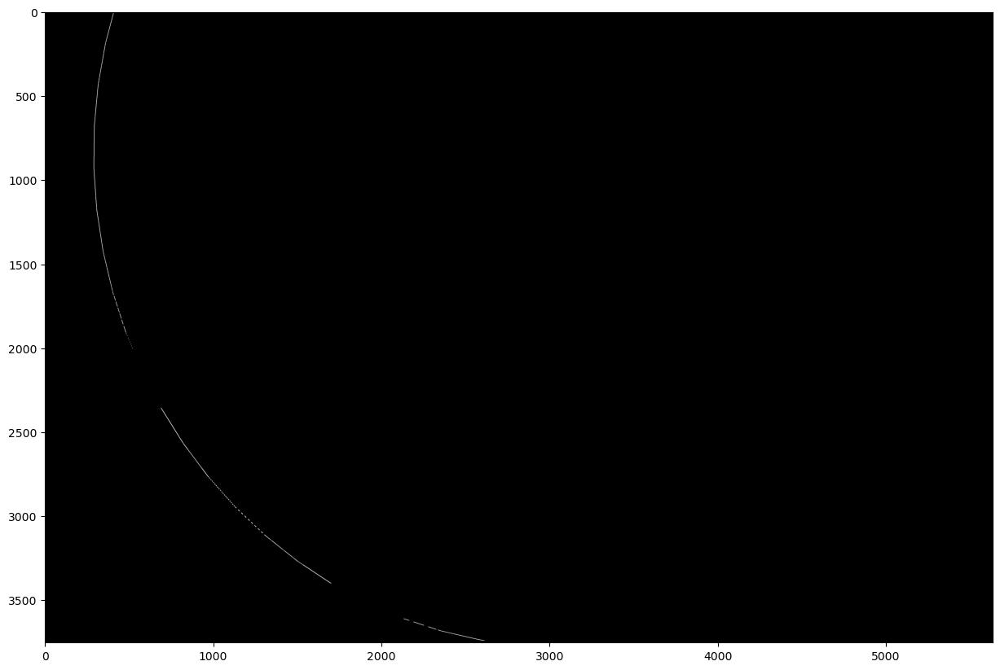

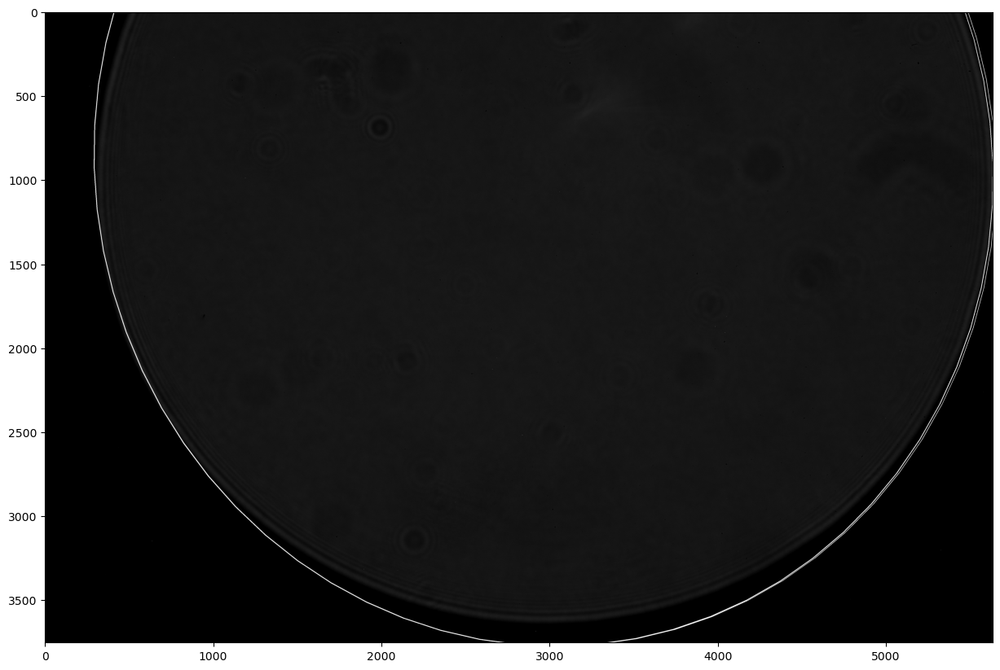

((2971.643798828125, 913.9298095703125), (5347.255859375, 5739.8564453125), 169.41822814941406)


In [238]:
imgs, cnt = contour_points(g_img)

kernel = np.ones((25, 25),np.uint8)
cv2.dilate(imgs, kernel, iterations = 1)

fig, ax = plt.subplots(1, 1, figsize=(15, 15))
plt.imshow(imgs, cmap='gray')
plt.show()

ellipse = cv2.fitEllipse(cnt)
cv2.ellipse(g_img, ellipse, 255, 2)
fig, ax = plt.subplots(1, 1, figsize=(15, 15))
ax.imshow(g_img, cmap='gray')
plt.show()

print(ellipse)

## Preprocessing problem fixed: Demo

In [652]:
dir_path = "Z:/CSE\CSE-Research/Microscopy3D/CV_CSE_Collaboration/Results/CV_CSE/fpm_capture/output/2023_03_15/2023_03_15_16_02_07/"
file_path = "2023_03_15_16_02_07_img_shutter_05_x_13_y_14_r_0_g_1_b_0.tiff"

# dir_path = "Z:/CSE/CSE-Research/Microscopy3D/CV_CSE_Collaboration/Results/CV_CSE/fpm_capture/output/2023_08_25/2023_08_25_09_31_25/"
# file_path = "2023_08_25_09_31_25_img_iso_100_shutter_2_x_16_y_16_r_0_g_1_b_0.tiff"

img = cv2.imread(dir_path + file_path, cv2.IMREAD_UNCHANGED)

_, g_img, _ = cv2.split(img)

In [653]:
g_img

array([[   0,    0,    0, ...,    0,    0,    0],
       [   0,    0,    0, ...,    0,    0,    0],
       [   0,    0,    0, ...,    0,    0,    0],
       ...,
       [ 887,  153, 1258, ...,    0,    0,    0],
       [1531, 1343, 2342, ...,    0,    0,    0],
       [1369, 1267, 1454, ...,    0,    0,    0]], dtype=uint16)

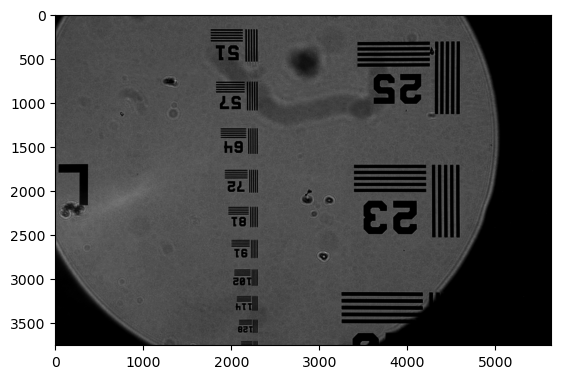

In [654]:
plt.imshow(g_img, cmap='gray')

In [655]:
g_img_8 = cv2.convertScaleAbs(g_img, alpha=(255/65535))

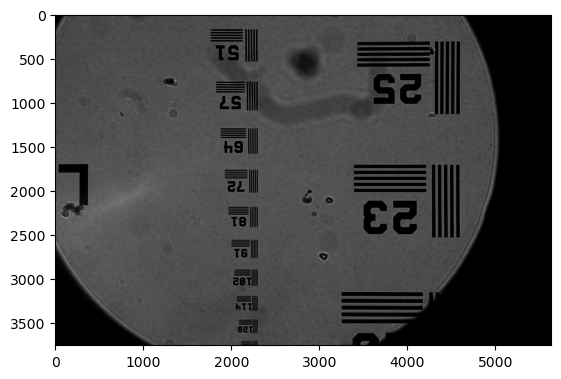

In [656]:
plt.imshow(g_img_8, cmap='gray')

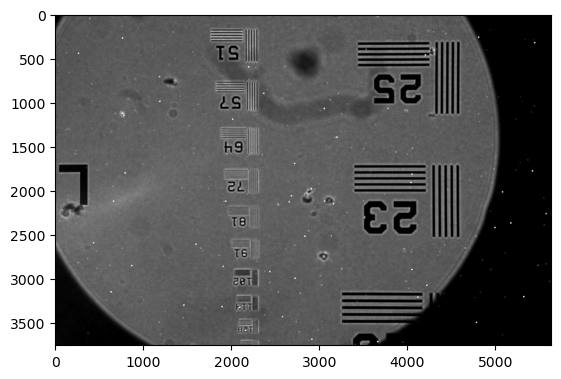

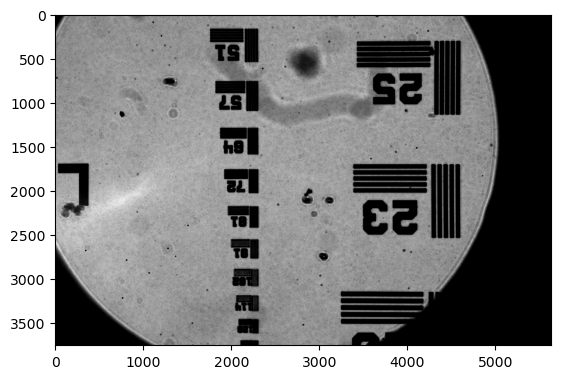

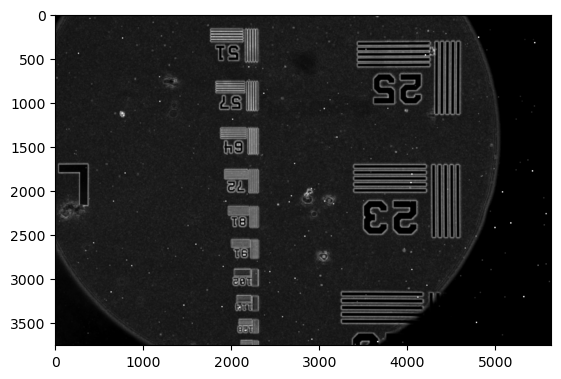

In [657]:
kernel = np.ones((15, 15), np.uint8)
dilation = cv2.dilate(g_img_8, kernel, iterations = 1)
plt.imshow(dilation, cmap='gray')
plt.show()

kernel = np.ones((15, 15), np.uint8)
erosion = cv2.erode(g_img_8, kernel, iterations = 1)
plt.imshow(erosion, cmap='gray')
plt.show()

plt.imshow((np.fabs(-erosion.astype(np.int16) + dilation.astype(np.int16))).astype(np.uint8), cmap='gray')
plt.show()

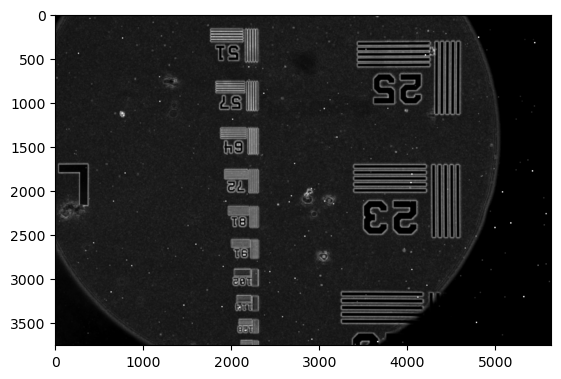

In [658]:
kernel = np.ones((15, 15), np.uint8)
gradient = cv2.morphologyEx(g_img_8, cv2.MORPH_GRADIENT, kernel)

# g_img_2 = g_img.cop
plt.imshow(gradient, cmap='gray')

In [659]:
# kernel = np.ones((25, 25), np.uint8)
# opening = cv2.morphologyEx(gradient, cv2.MORPH_OPEN, kernel)

# plt.imshow(opening, cmap='gray')

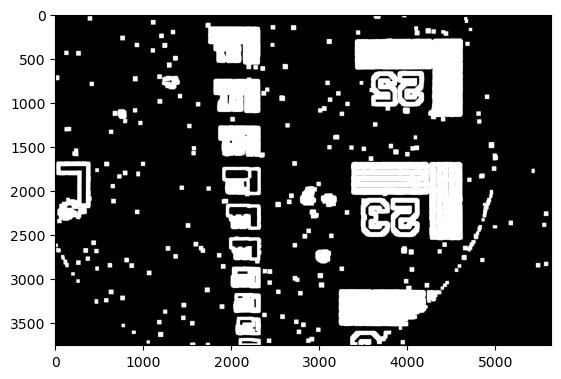

In [668]:
blur = cv2.GaussianBlur(gradient+20, (5, 5), 0)
ret3, th3 = cv2.threshold(blur, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

gradient_img = np.zeros_like(g_img, dtype=np.uint8)

contours, _ = cv2.findContours(th3, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
if len(contours) < 2:
    print("Errors")
    
cv2.drawContours(gradient_img, contours, -1, 255, 2)

kernel = np.ones((35, 35),np.uint8)
gradient_img = cv2.dilate(gradient_img, kernel, iterations = 1)

plt.imshow(gradient_img, cmap='gray')

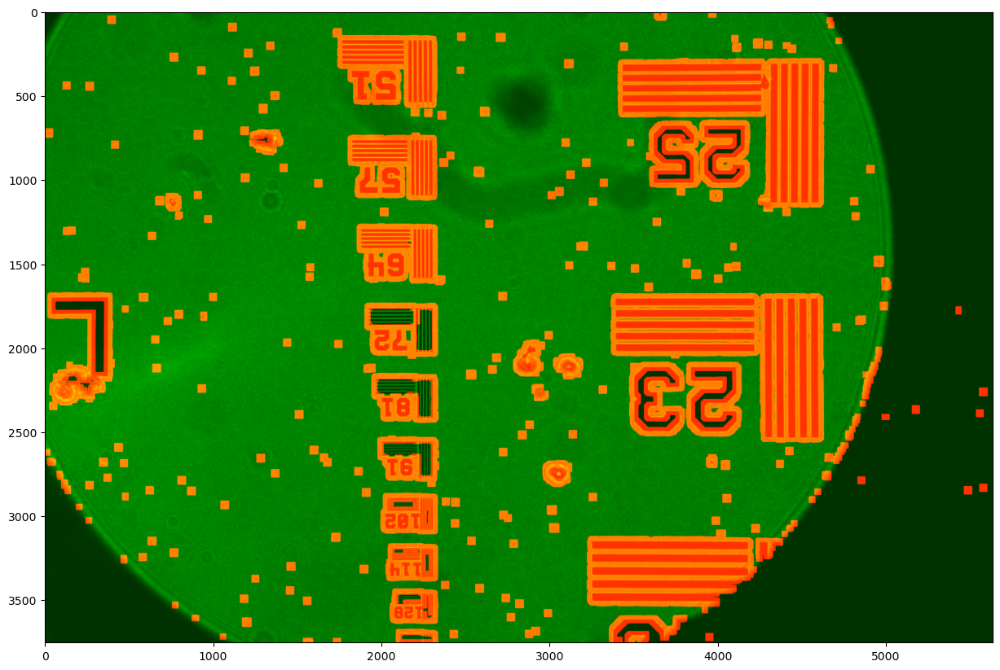

In [669]:
ch_img_1 = np.zeros_like(img, dtype=np.uint8)
ch_img_1[:, :, 0] = gradient_img

ch_img_2 = np.zeros_like(img)
ch_img_2[:, :, 1] = g_img_8+50

new_img = np.array((ch_img_1 + ch_img_2), dtype=np.uint8)

fig, ax = plt.subplots(1,1, figsize=(15, 15))
ax.imshow(new_img)
plt.show()

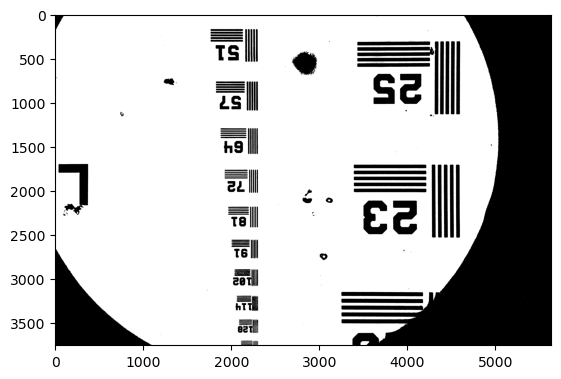

In [670]:
hull_img = np.zeros_like(g_img_8, dtype=np.uint8)

blur = cv2.GaussianBlur(g_img_8, (3, 3), 0)
ret3, th3 = cv2.threshold(blur, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

plt.imshow(th3, cmap='gray')

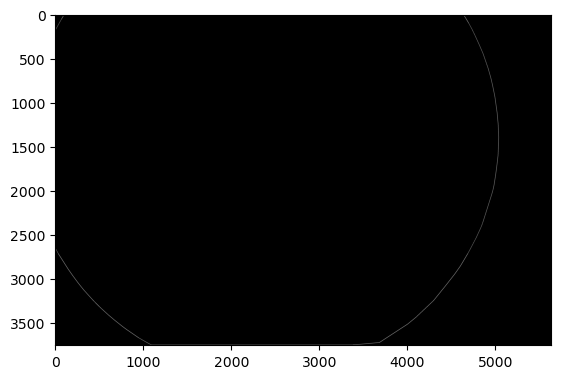

In [671]:
contours, _ = cv2.findContours(th3, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
area_cntrs = [cv2.contourArea(cnt) for cnt in contours]
max_cntr_index = np.argmax(area_cntrs)
cnt = contours[max_cntr_index]
hull = cv2.convexHull(cnt)


if len(contours) < 2:
    print("Errors")
    
cv2.drawContours(hull_img, [hull], 0, 125, 2)

plt.imshow(hull_img, cmap='gray')

In [672]:
# hull_img = np.zeros_like(g_img_8, dtype=np.uint8)

# area_cntrs = [cv2.contourArea(cnt) for cnt in contours]
# max_cntr_index = np.argmax(area_cntrs)
# cnt = contours[max_cntr_index]

# hull = cv2.convexHull(cnt)
# cv2.drawContours(hull_img, [hull], 0, 125, 2)
# plt.imshow(hull_img, cmap='gray')

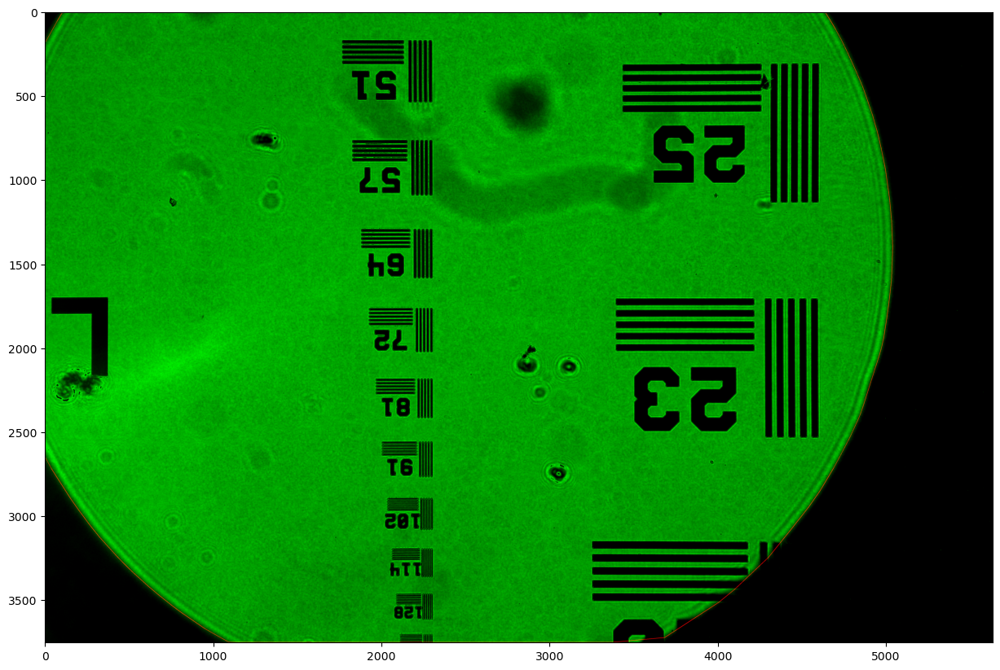

In [673]:
ch_img_1 = np.zeros_like(img, dtype=np.uint8)
ch_img_1[:, :, 0] = hull_img

ch_img_2 = np.zeros_like(img)
ch_img_2[:, :, 1] = g_img_8

new_img = np.array((ch_img_1 + ch_img_2)*2, dtype=np.uint8)

fig, ax = plt.subplots(1,1, figsize=(15, 15))
ax.imshow(new_img)
plt.show()

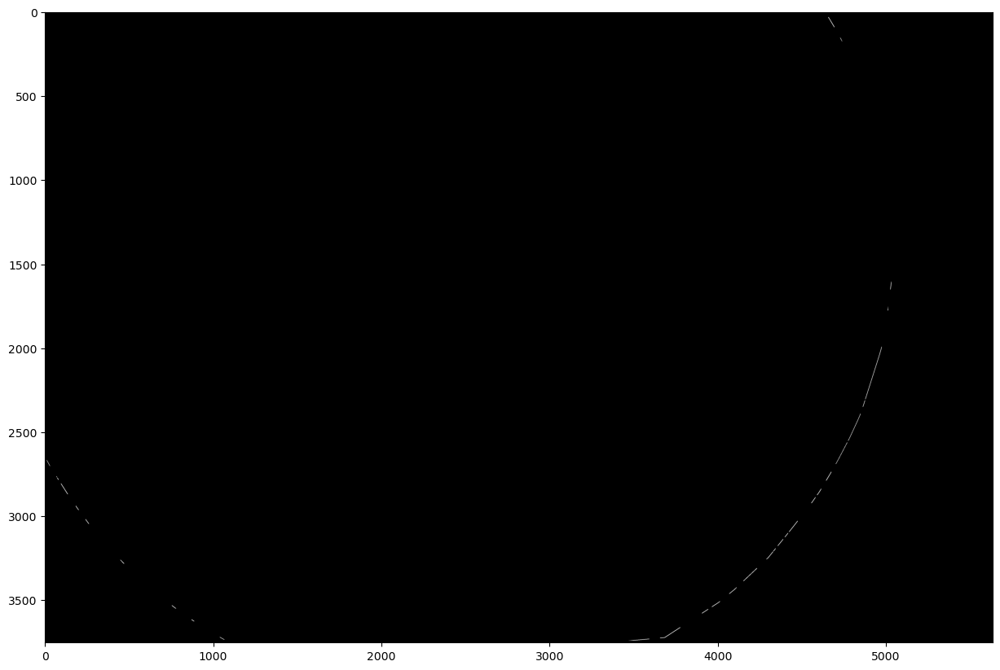

In [674]:
op = np.logical_and(gradient_img, hull_img).astype(np.uint8)*255

op[:10, :] = 0
op[-10:, :] = 0

fig, ax = plt.subplots(1,1, figsize=(15, 15))
ax.imshow(op, cmap='gray')
plt.show()

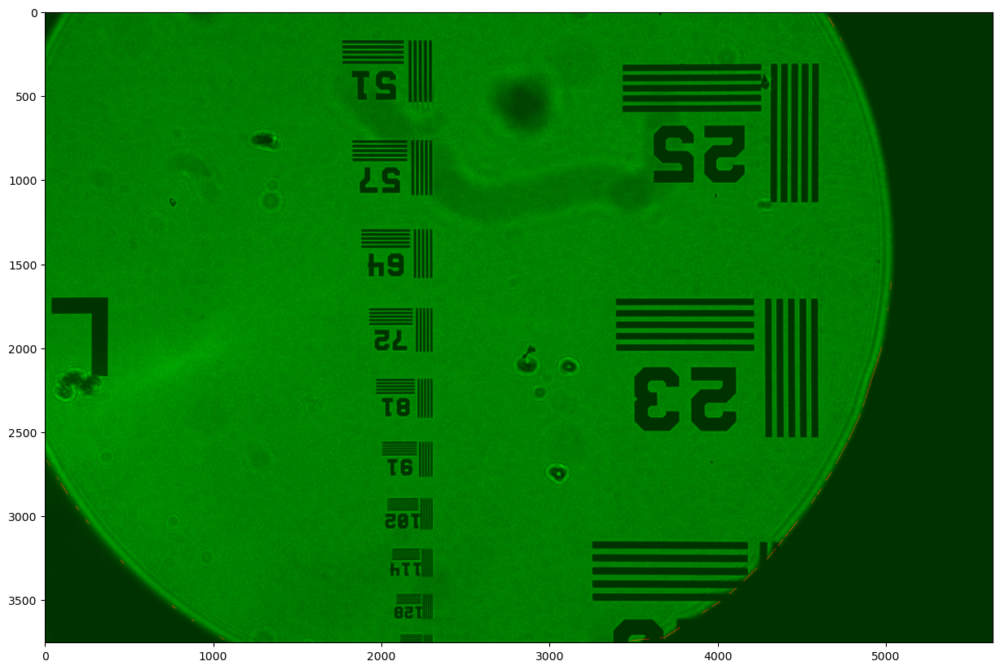

In [675]:
# op = np.logical_and(gradient_img, hull_img).astype(np.uint8)*255

# op[:10, :] = 0
# op[-10:, :] = 0

ch_img_1 = np.zeros_like(img, dtype=np.uint8)
ch_img_1[:, :, 0] = op

ch_img_2 = np.zeros_like(img)
ch_img_2[:, :, 1] = g_img_8+50

new_img = np.array((ch_img_1 + ch_img_2), dtype=np.uint8)

fig, ax = plt.subplots(1,1, figsize=(15, 15))
ax.imshow(new_img)
plt.show()

In [228]:
# ellipse fit below not terrific but not because of contour above is v. good

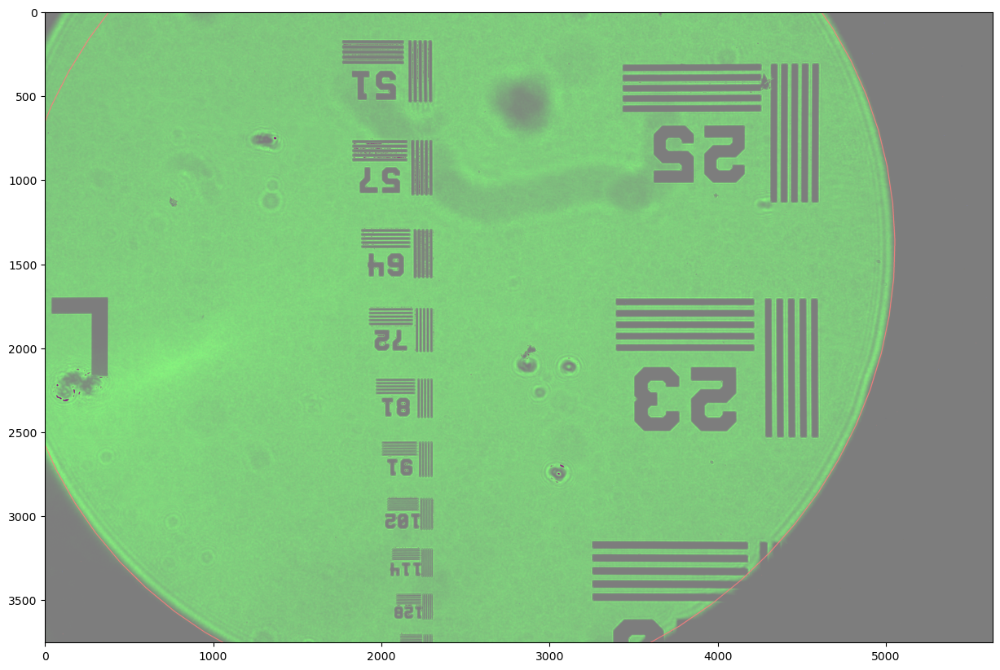

In [676]:
x, y = np.where(op > 1)
op_cnt = np.vstack([y, x]).T

ellipse = cv2.fitEllipse(op_cnt)
cv2.ellipse(img, ellipse, (2**15, 0, 0), 3)


fig, ax = plt.subplots(1,1, figsize=(15, 15))
ax.imshow(cv2.convertScaleAbs(img, alpha=(255/65535)) + 125)
plt.show()

In [230]:
ellipse

((2975.01220703125, 1009.5517578125),
 (5253.75927734375, 5340.55322265625),
 97.18701934814453)

In [231]:
min_axis_len = 5253.75927734375
maj_axis_len = 5340.55322265625

ratio = min_axis_len/maj_axis_len
ratio

0.9837481358777039

In [6]:
def contour_points_v2(g_img):

    kernel = np.ones((15, 15), np.uint8)
    gradient = cv2.morphologyEx(g_img, cv2.MORPH_GRADIENT, kernel)
    
    blur = cv2.GaussianBlur(gradient + 20, (5, 5), 0)
    ret3, th3 = cv2.threshold(blur, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

    gradient_img = np.zeros_like(g_img, dtype=np.uint8)

    contours, _ = cv2.findContours(th3, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    if len(contours) < 1:
        return None, None
    
    cv2.drawContours(gradient_img, contours, -1, 255, 2)

    kernel = np.ones((25, 25),np.uint8)
    gradient_img = cv2.dilate(gradient_img, kernel, iterations = 1)    


    hull_img = np.zeros_like(g_img, dtype=np.uint8)

    blur = cv2.GaussianBlur(g_img, (3, 3), 0)
    ret3, th3 = cv2.threshold(blur, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

    contours, _ = cv2.findContours(th3, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    
    if len(contours) < 1:
        return None, None
    
    area_cntrs = [cv2.contourArea(cnt) for cnt in contours]
    max_cntr_index = np.argmax(area_cntrs)
    cnt = contours[max_cntr_index]

    hull = cv2.convexHull(cnt)
    cv2.drawContours(hull_img, [hull], 0, 125, 2)

    op = np.logical_and(gradient_img, hull_img).astype(np.uint8)*255

#     op[:10, :] = 0
#     op[-10:, :] = 0

#     kernel = np.ones((3, 3), np.uint8)
#     opening = cv2.morphologyEx(op, cv2.MORPH_OPEN, kernel)
    
    x, y = np.where(op > 1)
    final_cnt = np.vstack([y, x]).T
#     final_cnt = np.take(final_cnt, list(set(np.random.randint(0, final_cnt.shape[0], size=int(final_cnt.shape[0]/10)))), axis=0)
#     imgs = np.hstack([gradient_img, hull_img, opening])
    
    if final_cnt.shape[0] > 4:
        return op, final_cnt
    
    else:
        return None, None

In [239]:
# now preprocessing fixed for both types of images

## Fixing ellipses' minor and major axis ratio

In [532]:
# Ivo's implemetation of Ellipse class

class Ellipse_Fixed_Ratio:

    C : np.array #homogeneous conic matrix x'*C*x=0

    def __init__( self, C : np.array ):

        self.C = C
        

    @classmethod
    def estimate_ellipsoid( cls, points : np.array ):
        """
        C = estimate_ellipsoid_2D ( points )
        ----------------------------------

        estimates a homogeneous ellipsoid C
        
        x'*C*x = 0
        
        from a number of point samples 
        (in a least squares sense)
        
        format of points

                [ x^1_1 . . . . .  x^N_1 ] 
                [  .                 .   ]
        points = [  .                 .   ]
                [  .                 .   ]
                [ x^1_n . . . . .  x^N_n ]
                [  1    . . . . .    1   ]

        where each point is element R^n
        and there are N points, the points  
        have to be in homogeneous coordinates.
        
        """

        n = points.shape[0]
#         n is 3
        num_entries = int((n+1) * n/2) - 2 # fixing ellipse maj/min axis length ratio
        
        if points.shape[1] < num_entries-1:
            print('insufficient number of points, need at least {}'.format( num_entries-1 ) )
    
        # --------------  estimate ellipse ---------------

        # assemble linear system
        A = np.zeros( [points.shape[ 1 ], num_entries ] )

        #for all points
#         print(points.shape[ 1 ])
        for i in range( 0, points.shape[ 1 ] ):
        
            #extract point
            x = np.array([points[:, i]]).T

            X  = np.matmul( x, x.T )

            X2 = X.T + X - np.diag( np.diag( X ) )

            row = X2[ np.where( np.triu( np.ones( X2.shape ) ) ) ]

            

            row[0] = row[0] + row[3]
            row = np.delete(row, 3)
            row = np.delete(row, 1)

            A[ i, : ] = row

        #solve for null space 
        U,D,V = np.linalg.svd( A )
#         print(U, D, V)

        ell = V[-1,:]
        ell = np.insert(ell, 1, 0)
        ell = np.insert(ell, 3, ell[0])
#         ell[0] = 0.9837*ell[0]
        print('Ell:', ell)

        #create conic matrix
        Cd = np.zeros( X2.shape )

        Cd[ np.where( np.triu( np.ones( X2.shape ) ) ) ] = ell

        C = Cd + Cd.T - np.diag( np.diag ( Cd ) )
        print(f'C: {C}')

        if Ellipse_Fixed_Ratio.is_hyperboloid( C ):
            print('Warning: result is a hyperboloid!')
        

        if Ellipse_Fixed_Ratio.is_paraboloid( C ):
            print('Warning: result is a paraboloid!')
        
        return C

    @classmethod
    def cov_mean_to_ellipsoid( cls, cov, mean, k ):
        """
            C = cov_mean_to_ellipsoid_homog ( Cov, Mean, k )
            ----------------------------------
        
            generates a homogeneous ellipsoid C
            
            x'*C*x = 0
        
            from covariance matrix and mean value
            of a gaussian distribution
            
            k is a confidence factor determibed by the chi^2 
            distribution. The probability that x is inside 
            the ellipsoid is P_{chi^2}(k,2). Some values 
            for k are 2.41 (70%) and k=5.99 (95%).
            
            cov  : np.array - covariance matrix (non-homogeneous)
            mean : np.array - mean value (vector)
            k : float - confidence factor, see above 

        """

        #column vector, assume we get a 1D array
        mean = np.array( [mean] ).T

        SIGMAinv = np.linalg.inv( cov )

        lastentry = np.matmul( mean.T, np.matmul( SIGMAinv, mean ) ) - k 
        C = np.vstack( [ np.hstack( [ SIGMAinv, -np.matmul(SIGMAinv, mean)] ), 
                         np.hstack( [ -np.matmul(mean.T,SIGMAinv), lastentry] ) ] )
        
        return C

    @classmethod
    def srt_to_ellipsoid( cls, S, R, T ): 
        """
         C = srt_to_ellipsoid_homog ( S, R, T )
         ----------------------------------
        
         generates a homogeneous ellipsoid C
         
         x'*C*x = 0
        
         from translation, rotation and scale parts as
        
         x'* (T^-1 * R^-1 * S^-1) ( S * R * T ) x = 0
        
         see: Ivo Ihrke: "Some Notes on Ellipses", TechReport, 2004
        """
        #function C = srt_to_ellipsoid_homog ( S, R, T )


        invT = np.linalg.inv( T )
        invR = R.T
        invS = np.linalg.inv( S )

        left  = np.matmul( invT.T, np.matmul( invR.T, invS.T ) )
        right = np.matmul( invS, np.matmul( invR, invT ) )

        C = np.matmul( left, right )
    
        return C



    @classmethod
    def decompose_ellipsoid( cls, C ):
        """
        
         [S,R,T] = decompose_ellipsoid_homog ( C )
         ----------------------------------
        
         decomposes a homogeneous ellipsoid C
         
         x'*C*x = 0
        
         into translation, rotation and scale parts
        
         x'* (T^-1 * R^-1 * S^-1) ( S * R * T ) x = 0
        
         Note that C \neq (T^-1 * R^-1 * S^-1) ( S * R * T )
         in some cases because the orientation of 
         the ellipsoid's major axis is not fixed.
         The function generates a right handed system.

        """

        #print(C)
        C_ih = C[0:-1,0:-1] 
        #print(C_ih)

        t = -np.matmul( np.linalg.pinv( C_ih ), C[0:-1,-1] )

        T = np.eye( C.shape[ 0 ] )
        T[0:-1, -1 ] = t

        U,D,V = np.linalg.svd( C_ih )

        R = np.eye( C.shape[ 0 ] )
        R[0:-1,0:-1] = V


        #S = R' * T' * C * T * R;
        S = np.matmul( R.T, np.matmul( T.T, np.matmul( C, np.matmul( T, R ) ) ) )

        S = S / S[-1,-1]

        S = np.sqrt( np.diag(1/abs(np.diag(S))))

        return S, R, T

    @classmethod
    def is_ellipsoid( cls, C ):
        """
         bool = is_ellipsoid_homog ( C )
         ----------------------------------
        
         determines whether homogeneous conic C
         
         x'*C*x = 0
         
         is an ellipsoid
        """

        #function val = conic_is_ellipsoid_homog ( C )

        detC =  np.linalg.det( C[0:-1,0:-1] )

        return detC > 0


    @classmethod
    def is_hyperboloid( cls, C ):
        """
         bool = is_hyperboloid_homog ( C )
         ----------------------------------
        
         determines whether homogeneous conic C
         
         x'*C*x = 0
         
         is a hyperboloid
        """

        
        detC =  np.linalg.det( C[0:-1,0:-1] )

        return detC < 0

    @classmethod
    def is_paraboloid( cls, C ):
        """
         bool = is_paraboloid_homog ( C )
         ----------------------------------
        
         determines whether homogeneous conic C
         
         x'*C*x = 0
         
         is a paraboloid
        """

        
        detC =  np.linalg.det( C[0:-1,0:-1] )

        #maybe with EPS ?
        return detC == 0


    def get_center( self ):
        
        S,R,T = self.decompose_ellipsoid( self.C )


        return [ T[2,0], T[2,1] ]


    def plot( self, ax, **kwargs ):
        """
        plot_ellipsoid_2D ( C, style, N )
        ----------------------------------
        
        plots a homogeneous ellipsoid C
        
        x'*C*x = 0
        
        style is a matlab plot style, e.g. 'b-' (default)
        N is the number of polygon segments to 
        approximate the ellipse
        """

        #function plot_ellipsoid_homog_2d ( C, style, N )

        if not 'style' in locals():
            style = 'b-'

        if not 'N' in locals():
            N = 100



        angles = np.linspace( -np.pi, np.pi, N )

        # generate a unit circle or a unit hyperbola
        if ( Ellipse_Fixed_Ratio.is_ellipsoid( self.C ) ):
            #uc  = [ cos(x); sin(x); ones(size(x)) ];
            x  = np.cos( angles )
            y  = np.sin( angles )
            w  = np.ones( angles.shape )

            uc = np.vstack([x,y,w])

        else:
            EPS = 0.1
            x   =  np.linspace( -np.pi/2+EPS, np.pi/2-EPS, int( N/2 ) )#-(pi/2-EPS):((pi-2*EPS)/(N/2)):(pi/2-EPS);
            x2  =  np.linspace( np.pi/2+EPS, 3*np.pi/2-EPS, int( N/2 ) )  #x2 =  (pi/2+EPS):((pi-2*EPS)/(N/2)):(3*pi/2-EPS);
            uc  = np.vstack( [ 1/np.cos(x), np.tan(x), np.ones( x.shape ) ] )
            uc2 = np.vstack( [ 1/np.cos(x2), np.tan(x2), np.ones( x2.shape ) ] )
        
        #decompose
        S,R,T = Ellipse_Fixed_Ratio.decompose_ellipsoid( self.C )

        #transform unit circle or parabola 
        transform = np.matmul( T, np.matmul( R, S ) )
        ell  =  np.matmul( transform, uc )

        if 'uc2' in locals():
            ell2  =  np.matmul( transform, uc2 )
            ax.plot( ell2[0,:], ell2[1,:], style )

   
        #plot conic
        ax.plot( ell[0,:], ell[1,:], style )

        #plot coordinate system
        tx = T[0,2]
        ty = T[1,2]
        
#         print(tx, ty)

        smin = S[0,0]
        smaj = S[1,1] 

        ax.plot( np.array( [ tx, tx+smin*R[0,0] ] ), np.array( [ ty, ty+smin*R[1,0] ] ), 'r' )
        ax.plot( np.array( [ tx, tx+smaj*R[0,1] ] ), np.array( [ ty, ty+smaj*R[1,1] ] ), 'b' )

        ax.set_aspect('equal', adjustable='box')
        return (tx, ty, smin, smaj)

In [7]:
def fit_ellipse_2(path_dir_w_time, ifHull=False, date_now=""):
        """ Find and fit an ellipse in an image.
        it should be run on a normalized image I (normalization should exclude dead pixels which are artificially maximum)
        Parameters
        ----------
        path_dir_w_time : str
            _description_
        date_now : str
            _description_

        Returns
        -------
        Ellipse
            Ellipse in an image.
        """
        
        I_temp = plt.imread(path_dir_w_time)[:,:,1].astype(float)/255
        I = old_rplc_dead_px_med(I_temp)

        ellipsoid_points=[]

        if ifHull == False:
            #every Nth scanline should be sampled
            START_SCANLINE = 50 #there are some weird effects on the zero scanline that lead to detection of erroneous points
            DELTA_SCANLINE = 100

            #need to filter enough such that the big jump into and out of the disc has indeed the largest magnitude derivative
            FILTERWIDTH=250
            x=np.linspace(-4,4,FILTERWIDTH)
            gauss=np.exp(-x**2)


            plt.figure(figsize=[18,12])

            for sl in range( START_SCANLINE, I.shape[0]-START_SCANLINE, DELTA_SCANLINE ):
                #print(f'Checking Scanline {sl} ...' )
                #line = self.I[sl]
                line = I[sl, :]

                filtered_line = sgn.convolve(line,gauss,mode='same')
                #crude filter for line intersecting the ring structure
                if np.amax(filtered_line) > 0.9:
                    #print("- scanline intersection ")

                    filtered_deriv = np.diff( filtered_line )

                    #crude extraction - this will probably need improvement
                    max_pos = np.argmax( filtered_deriv )
                    min_pos = np.argmin( filtered_deriv )
                    ellipsoid_points.append([max_pos,sl])
                    ellipsoid_points.append([min_pos,sl]) #add two points on perimeter

                else:
                    #print("- no intersection ")

                    pass
            print(ellipsoid_points)


        else:
            img = np.array(I*255, dtype=np.uint8)
            cnt_img, final_cnt = contour_points_v2(img)

            if final_cnt is None:
                return None, None
            elif final_cnt.shape[0] < 5:
                return None, None
            else:
                ellipsoid_points = np.array(final_cnt).reshape([-1, 2])
        
#         print(ellipsoid_points)
        ellipsoid_points = np.array(ellipsoid_points).astype('float').T
        ellipsoid_points = np.vstack( [ellipsoid_points, np.ones(ellipsoid_points.shape[1])] )
#         print(ellipsoid_points)

        #plt.clf()
        #plt.imshow(self.I)
        #plt.show()

        for i in range( 0, ellipsoid_points.shape[1] ):
            plt.plot(ellipsoid_points[0,i],ellipsoid_points[1,i],'rx')

        E = Ellipse_Fixed_Ratio( Ellipse_Fixed_Ratio.estimate_ellipsoid( ellipsoid_points ) )
        S,R,T=Ellipse_Fixed_Ratio.decompose_ellipsoid(E.C)
        print(f'S:{S}, \nR: {R}, \nT: {T}')

        plt.plot(T[0,2],T[1,2],'gx')

        plt.imshow(I)
        center = E.plot(plt.gca())
        plt.title(f'ellipsoide fit {1}')
#         plt.savefig(f"{path_dir_w_time}/{date_now}_ledpos_{self.x_pos}_{self.y_pos}_{self.channel}_ellipsoide_fit.png")

        return E, center

def old_rplc_dead_px_med(I_temp):
        """Replace dead pixels by median

        Parameters
        ----------
        I_temp : ndarray
            image to be processed

        Returns
        -------
        ndarray
            clean image where dead pixels are replaced by median 
        """

        Imed = sgn.medfilt2d( I_temp, kernel_size=5 )
        maxI = np.amax( Imed ) #normalize robustly
        I_temp = I_temp / maxI
        #replace dead pixels by median filtered values
        I_temp[ I_temp > 1 ] = Imed[ I_temp > 1 ]

        return I_temp

In [257]:
dir_path = "Z:/CSE\CSE-Research/Microscopy3D/CV_CSE_Collaboration/Results/CV_CSE/fpm_capture/output/2023_03_15/2023_03_15_16_02_07/"
file_path = f"2023_03_15_16_02_07_img_shutter_05_x_15_y_15_r_0_g_1_b_0.tiff"

# dir_path = "Z:/CSE/CSE-Research/Microscopy3D/CV_CSE_Collaboration/Results/CV_CSE/fpm_capture/output/2023_08_25/2023_08_25_09_31_25/"
# file_path = "2023_08_25_09_31_25_img_iso_100_shutter_2_x_15_y_15_r_0_g_1_b_0.tiff"

[[1.440e+02 1.450e+02 1.460e+02 1.440e+02 1.450e+02 1.460e+02 1.440e+02
  1.450e+02 1.460e+02 4.557e+03 4.558e+03 4.559e+03 4.556e+03 4.557e+03
  4.558e+03 4.559e+03 4.556e+03 4.557e+03 4.558e+03 4.559e+03 4.556e+03
  4.557e+03 4.558e+03 4.480e+03 4.481e+03 4.482e+03 4.480e+03 4.481e+03
  4.482e+03 4.480e+03 4.481e+03 4.482e+03 4.325e+03 4.326e+03 4.327e+03
  4.325e+03 4.326e+03 4.327e+03 4.325e+03 4.326e+03 4.327e+03 3.509e+03
  3.510e+03 3.511e+03 3.501e+03 3.502e+03 3.503e+03 3.504e+03 3.505e+03
  3.509e+03 3.510e+03 3.511e+03 3.496e+03 3.497e+03 3.498e+03 3.499e+03
  3.500e+03 3.501e+03 3.502e+03 3.503e+03 3.504e+03 3.505e+03 3.509e+03
  3.510e+03 3.511e+03 3.492e+03 3.493e+03 3.494e+03 3.495e+03 3.496e+03
  3.497e+03 3.498e+03 3.499e+03 3.500e+03 3.501e+03 3.502e+03 3.503e+03
  3.504e+03 3.505e+03 3.486e+03 3.487e+03 3.488e+03 3.492e+03 3.493e+03
  3.494e+03 3.495e+03 3.496e+03 3.497e+03 3.498e+03 3.499e+03 3.500e+03
  3.486e+03 3.487e+03 3.488e+03 3.492e+03 3.493e+03 3.494e+03 3.

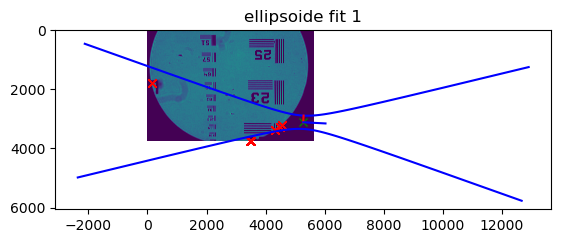

(5272.143308579376, 3112.6301639181233)


In [258]:
E, center = fit_ellipse(dir_path + file_path, ifHull=True)
plt.show()

print(center)

Ell: [ 5.23202987e-07  0.00000000e+00 -1.44310664e-03  5.14674778e-07
 -6.28543710e-04  9.99998761e-01]
C: [[ 5.23202987e-07  0.00000000e+00 -1.44310664e-03]
 [ 0.00000000e+00  5.14674778e-07 -6.28543710e-04]
 [-1.44310664e-03 -6.28543710e-04  9.99998761e-01]]
S:[[2.67648633e+03 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 2.69857004e+03 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]], 
R: [[1. 0. 0.]
 [0. 1. 0.]
 [0. 0. 1.]], 
T: [[1.00000000e+00 0.00000000e+00 2.75821559e+03]
 [0.00000000e+00 1.00000000e+00 1.22124444e+03]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]


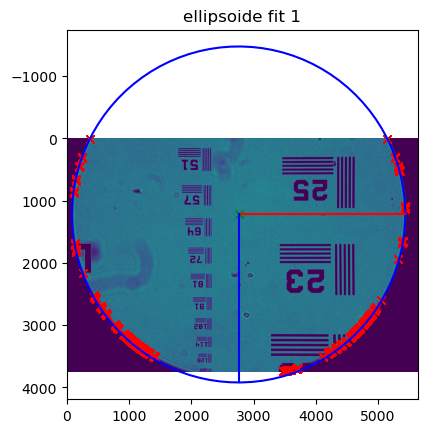

(2758.2155895125884, 1221.2444375066455, 2676.486329255531, 2698.5700358857857)


In [259]:
E, center = fit_ellipse_2(dir_path + file_path, ifHull=True)
plt.show()

print(center)

In [260]:
center[2]/center[3]

0.9918165152889924

## Compare multiple images to confirm if there is geometric distrotion

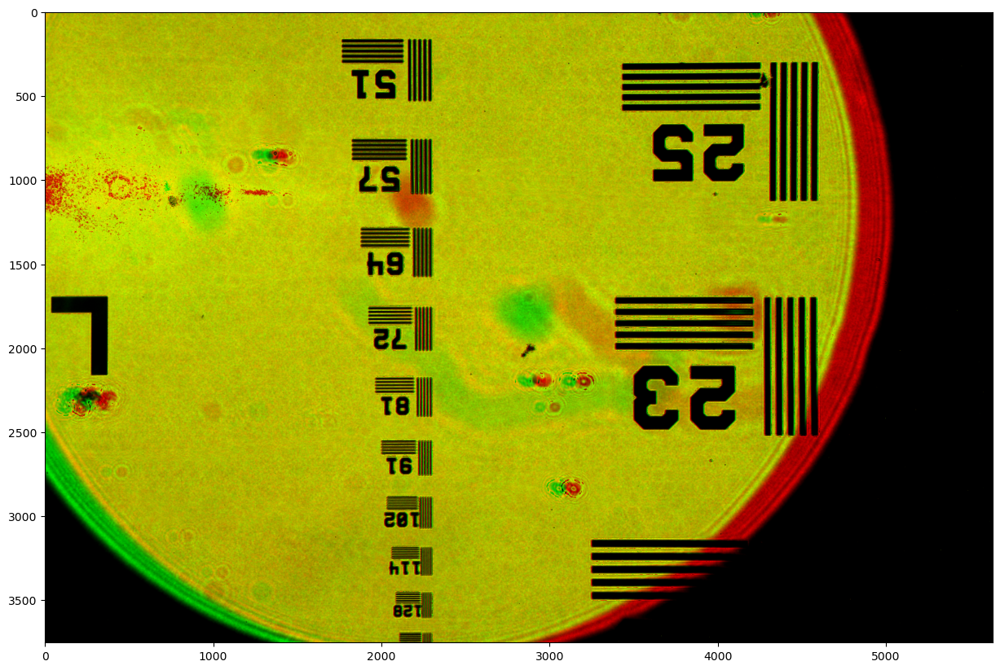

In [331]:
dir_path = "Z:/CSE\CSE-Research/Microscopy3D/CV_CSE_Collaboration/Results/CV_CSE/fpm_capture/output/2023_03_15/2023_03_15_16_02_07/"
file_path = "2023_03_15_16_02_07_img_shutter_05_x_13_y_15_r_0_g_1_b_0.tiff"

img = cv2.imread(dir_path + file_path)

_, g_img, _ = cv2.split(img)

dir_path = "Z:/CSE\CSE-Research/Microscopy3D/CV_CSE_Collaboration/Results/CV_CSE/fpm_capture/output/2023_03_15/2023_03_15_16_02_07/"
file_path = "2023_03_15_16_02_07_img_shutter_05_x_12_y_15_r_0_g_1_b_0.tiff"

img = cv2.imread(dir_path + file_path)

_, g_img_2, _ = cv2.split(img)

ch_img_1 = np.zeros_like(img)
ch_img_1[:, :, 0] = g_img

ch_img_2 = np.zeros_like(img)
ch_img_2[:, :, 1] = g_img_2

new_img = np.array((ch_img_1 + ch_img_2)*2, dtype=np.uint8)

fig, ax = plt.subplots(1,1, figsize=(15, 15))
ax.imshow(new_img)
plt.show()

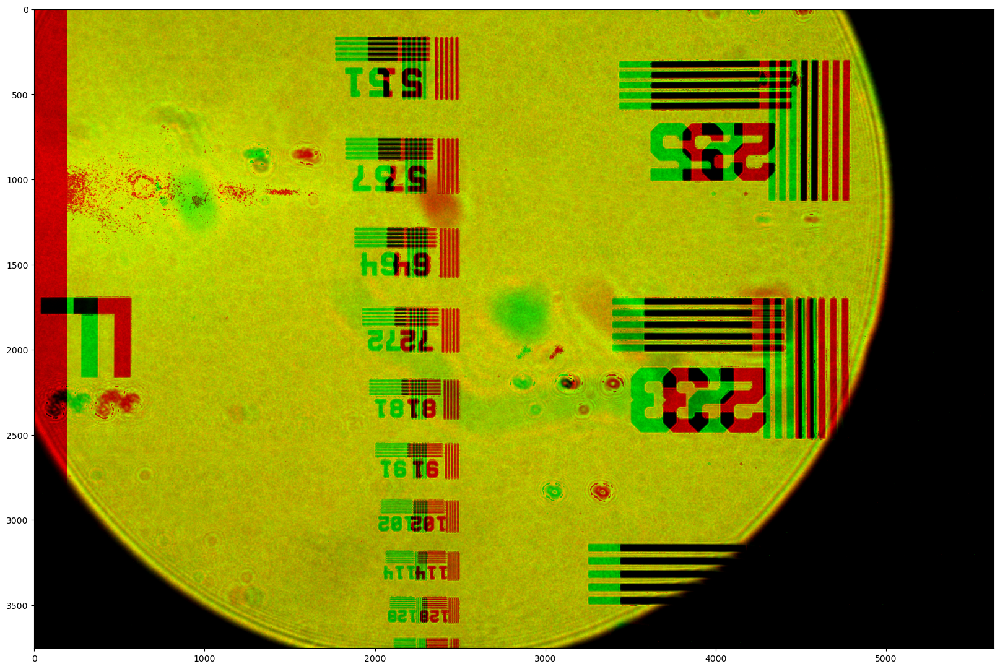

In [336]:
ch_img_1 = np.zeros_like(img)
ch_img_1[:, :, 0] = g_img

ch_img_2 = np.zeros_like(img)
ch_img_2[:, :, 1] = g_img_2

new_img = np.array((ch_img_1 + np.roll(ch_img_2, 195, axis=1))*2, dtype=np.uint8)

fig, ax = plt.subplots(1,1, figsize=(20, 20))
ax.imshow(new_img)
plt.show()

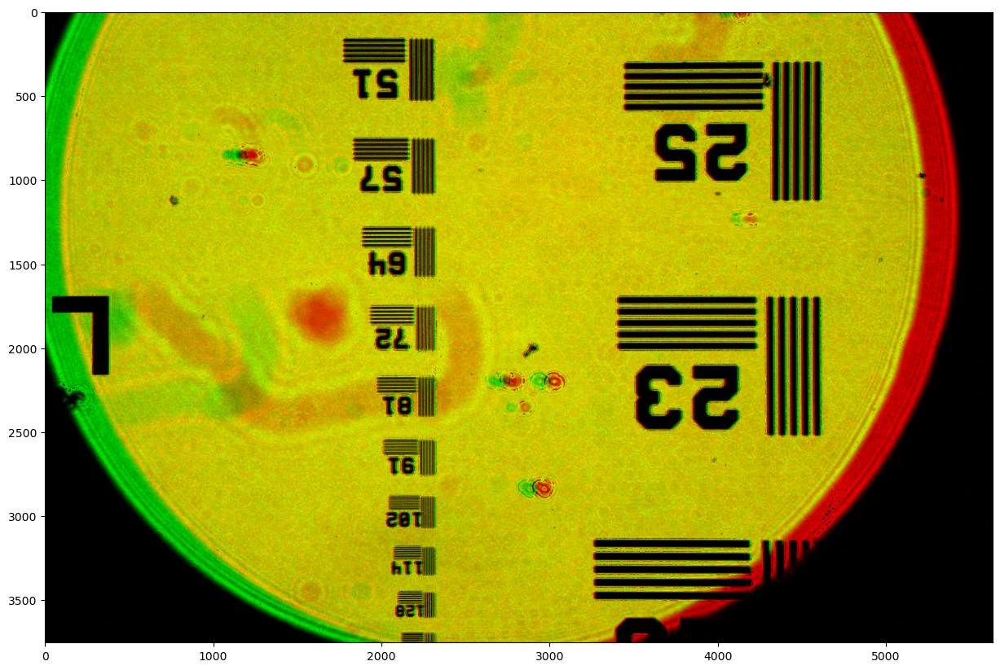

In [337]:
dir_path = "Z:/CSE\CSE-Research/Microscopy3D/CV_CSE_Collaboration/Results/CV_CSE/fpm_capture/output/2023_03_15/2023_03_15_16_02_07/"
file_path = "2023_03_15_16_02_07_img_shutter_05_x_15_y_15_r_0_g_1_b_0.tiff"

img = cv2.imread(dir_path + file_path)

_, g_img, _ = cv2.split(img)

dir_path = "Z:/CSE\CSE-Research/Microscopy3D/CV_CSE_Collaboration/Results/CV_CSE/fpm_capture/output/2023_03_15/2023_03_15_16_02_07/"
file_path = "2023_03_15_16_02_07_img_shutter_05_x_14_y_15_r_0_g_1_b_0.tiff"

img = cv2.imread(dir_path + file_path)

_, g_img_2, _ = cv2.split(img)

ch_img_1 = np.zeros_like(img)
ch_img_1[:, :, 0] = g_img

ch_img_2 = np.zeros_like(img)
ch_img_2[:, :, 1] = g_img_2

new_img = np.array((ch_img_1 + ch_img_2)*2, dtype=np.uint8)

fig, ax = plt.subplots(1,1, figsize=(15, 15))
ax.imshow(new_img)
plt.show()

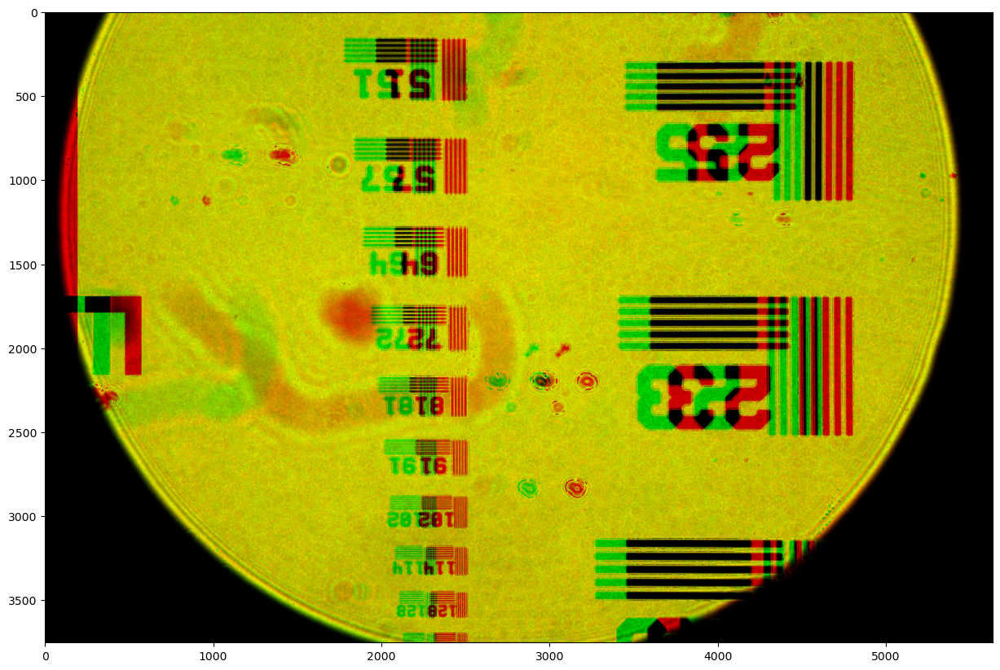

In [340]:
ch_img_1 = np.zeros_like(img)
ch_img_1[:, :, 0] = g_img

ch_img_2 = np.zeros_like(img)
ch_img_2[:, :, 1] = g_img_2

new_img = np.array((ch_img_1 + np.roll(ch_img_2, (195, 0), axis=(1, 0)))*2, dtype=np.uint8)

fig, ax = plt.subplots(1,1, figsize=(15, 15))
ax.imshow(new_img)
plt.show()

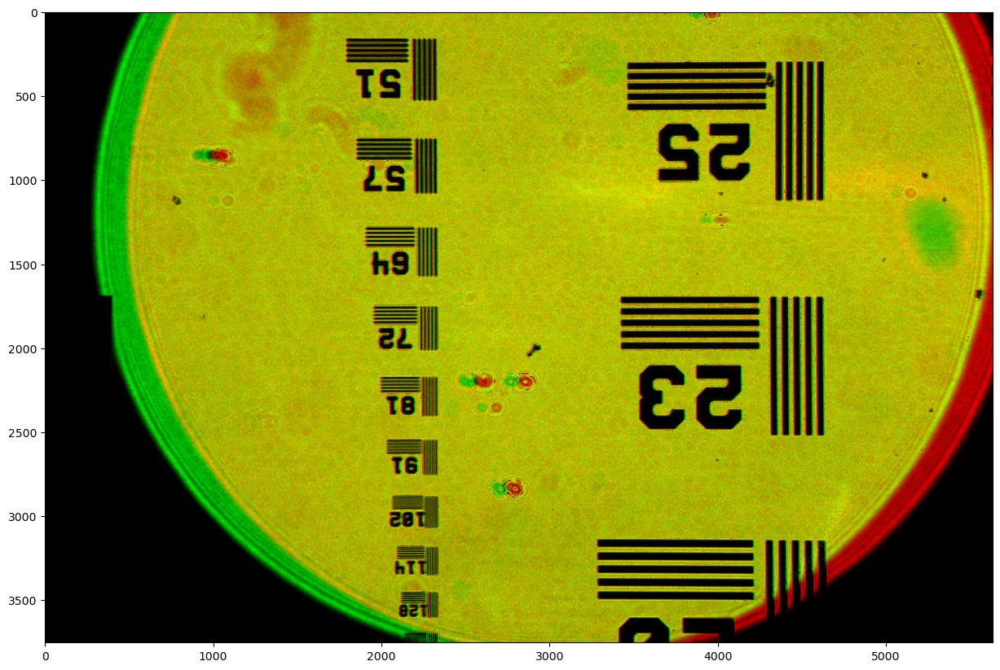

In [346]:
dir_path = "Z:/CSE\CSE-Research/Microscopy3D/CV_CSE_Collaboration/Results/CV_CSE/fpm_capture/output/2023_03_15/2023_03_15_16_02_07/"
file_path = "2023_03_15_16_02_07_img_shutter_05_x_17_y_15_r_0_g_1_b_0.tiff"

img = cv2.imread(dir_path + file_path)

_, g_img, _ = cv2.split(img)

dir_path = "Z:/CSE\CSE-Research/Microscopy3D/CV_CSE_Collaboration/Results/CV_CSE/fpm_capture/output/2023_03_15/2023_03_15_16_02_07/"
file_path = "2023_03_15_16_02_07_img_shutter_05_x_16_y_15_r_0_g_1_b_0.tiff"

img = cv2.imread(dir_path + file_path)

_, g_img_2, _ = cv2.split(img)

ch_img_1 = np.zeros_like(img)
ch_img_1[:, :, 0] = g_img

ch_img_2 = np.zeros_like(img)
ch_img_2[:, :, 1] = g_img_2

new_img = np.array((ch_img_1 + ch_img_2)*2, dtype=np.uint8)

fig, ax = plt.subplots(1,1, figsize=(15, 15))
ax.imshow(new_img)
plt.show()

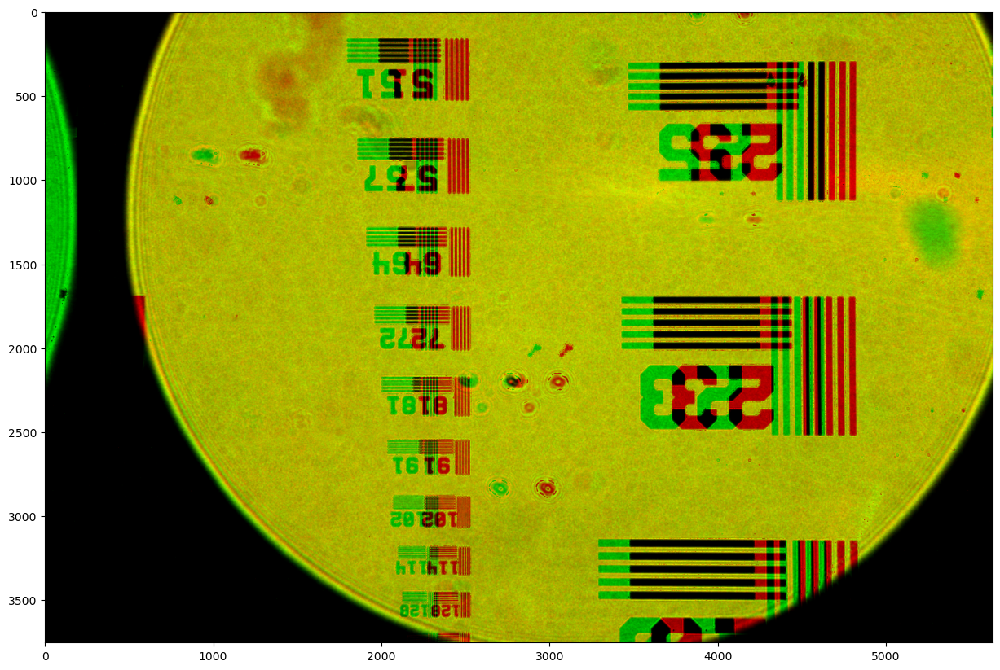

In [347]:
ch_img_1 = np.zeros_like(img)
ch_img_1[:, :, 0] = g_img

ch_img_2 = np.zeros_like(img)
ch_img_2[:, :, 1] = g_img_2

new_img = np.array((ch_img_1 + np.roll(ch_img_2, (195, 0), axis=(1, 0)))*2, dtype=np.uint8)

fig, ax = plt.subplots(1,1, figsize=(15, 15))
ax.imshow(new_img)
plt.show()

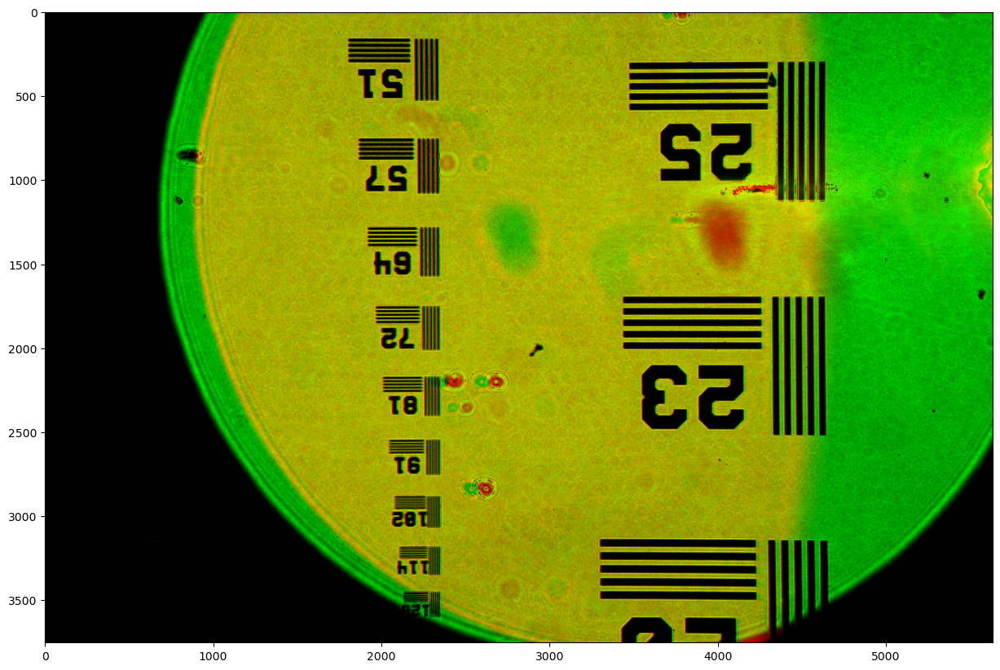

In [348]:
dir_path = "Z:/CSE\CSE-Research/Microscopy3D/CV_CSE_Collaboration/Results/CV_CSE/fpm_capture/output/2023_03_15/2023_03_15_16_02_07/"
file_path = "2023_03_15_16_02_07_img_shutter_05_x_19_y_15_r_0_g_1_b_0.tiff"

img = cv2.imread(dir_path + file_path)

_, g_img, _ = cv2.split(img)

dir_path = "Z:/CSE\CSE-Research/Microscopy3D/CV_CSE_Collaboration/Results/CV_CSE/fpm_capture/output/2023_03_15/2023_03_15_16_02_07/"
file_path = "2023_03_15_16_02_07_img_shutter_05_x_18_y_15_r_0_g_1_b_0.tiff"

img = cv2.imread(dir_path + file_path)

_, g_img_2, _ = cv2.split(img)

ch_img_1 = np.zeros_like(img)
ch_img_1[:, :, 0] = g_img

ch_img_2 = np.zeros_like(img)
ch_img_2[:, :, 1] = g_img_2

new_img = np.array((ch_img_1 + ch_img_2)*2, dtype=np.uint8)

fig, ax = plt.subplots(1,1, figsize=(15, 15))
ax.imshow(new_img)
plt.show()

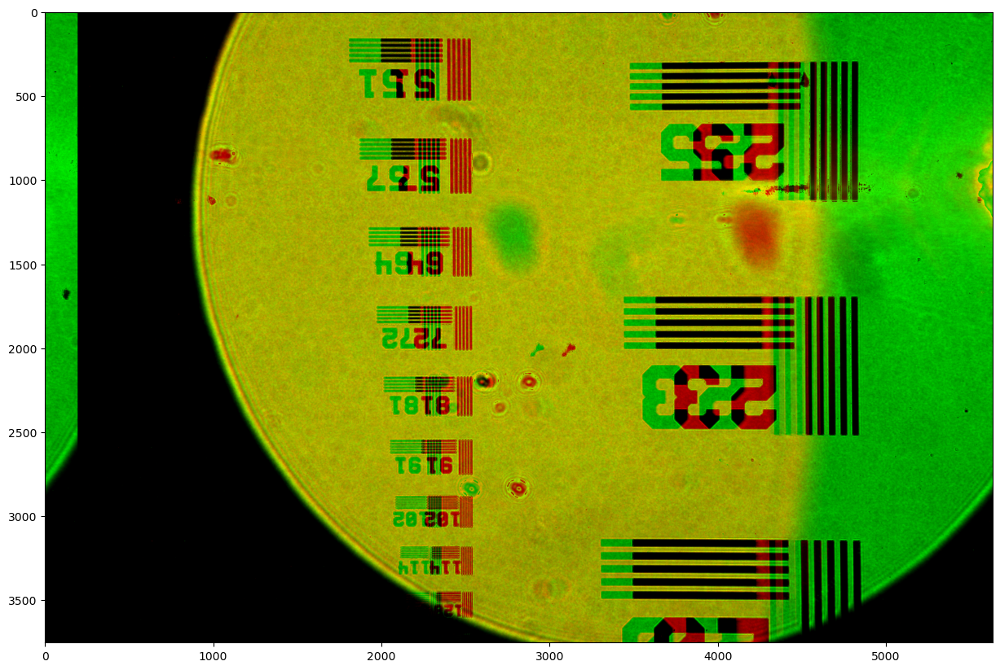

In [349]:
ch_img_1 = np.zeros_like(img)
ch_img_1[:, :, 0] = g_img

ch_img_2 = np.zeros_like(img)
ch_img_2[:, :, 1] = g_img_2

new_img = np.array((ch_img_1 + np.roll(ch_img_2, (195, 0), axis=(1, 0)))*2, dtype=np.uint8)

fig, ax = plt.subplots(1,1, figsize=(15, 15))
ax.imshow(new_img)
plt.show()

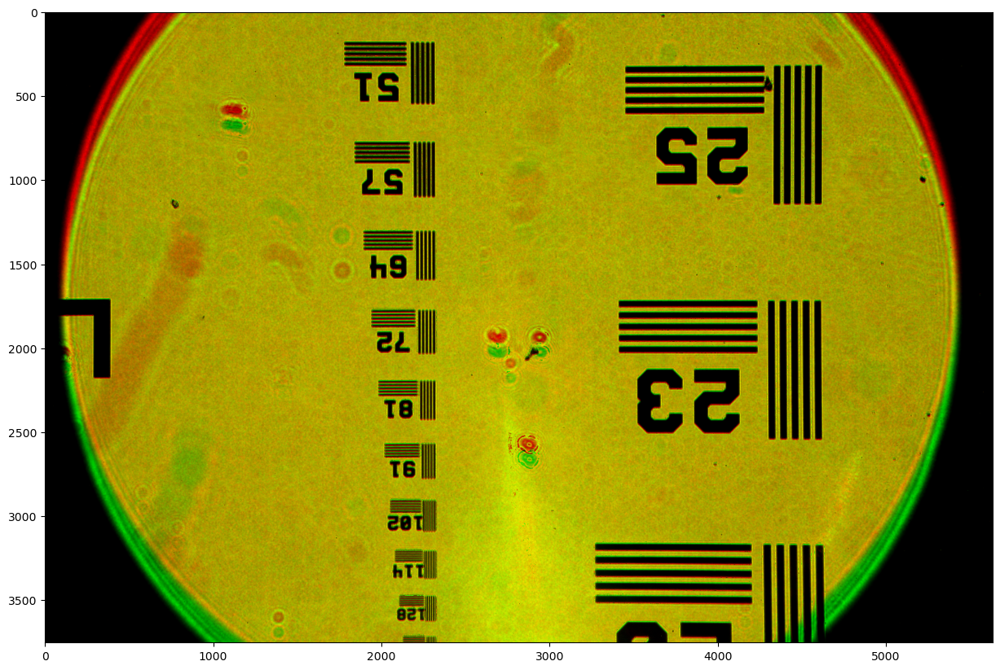

In [350]:
dir_path = "Z:/CSE\CSE-Research/Microscopy3D/CV_CSE_Collaboration/Results/CV_CSE/fpm_capture/output/2023_03_15/2023_03_15_16_02_07/"
file_path = "2023_03_15_16_02_07_img_shutter_05_x_15_y_13_r_0_g_1_b_0.tiff"

img = cv2.imread(dir_path + file_path)

_, g_img, _ = cv2.split(img)

dir_path = "Z:/CSE\CSE-Research/Microscopy3D/CV_CSE_Collaboration/Results/CV_CSE/fpm_capture/output/2023_03_15/2023_03_15_16_02_07/"
file_path = "2023_03_15_16_02_07_img_shutter_05_x_15_y_12_r_0_g_1_b_0.tiff"

img = cv2.imread(dir_path + file_path)

_, g_img_2, _ = cv2.split(img)

ch_img_1 = np.zeros_like(img)
ch_img_1[:, :, 0] = g_img

ch_img_2 = np.zeros_like(img)
ch_img_2[:, :, 1] = g_img_2

new_img = np.array((ch_img_1 + ch_img_2)*2, dtype=np.uint8)

fig, ax = plt.subplots(1,1, figsize=(15, 15))
ax.imshow(new_img)
plt.show()

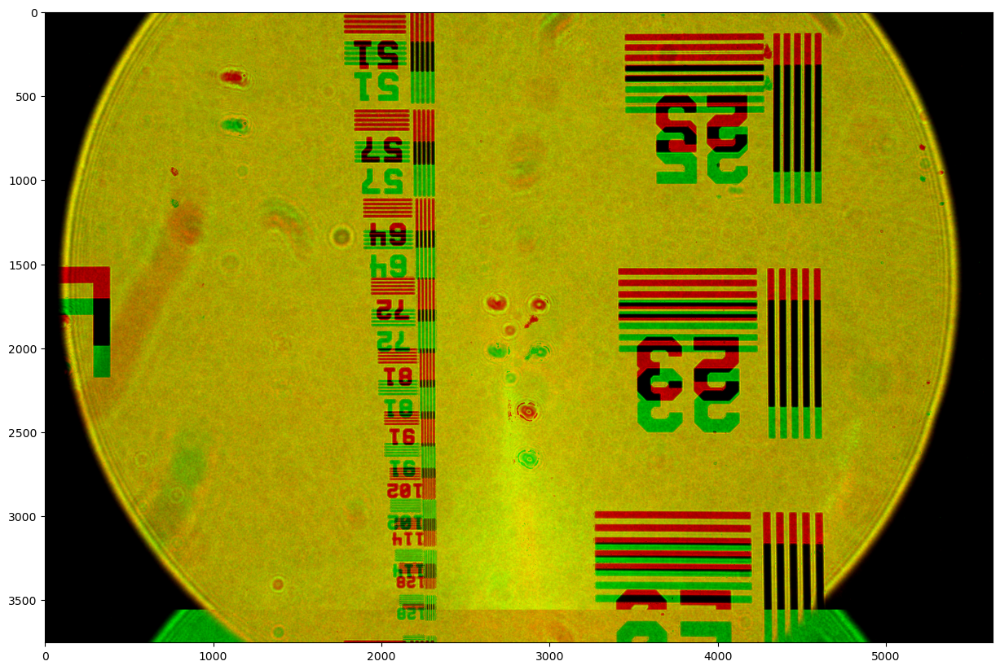

In [355]:
ch_img_1 = np.zeros_like(img)
ch_img_1[:, :, 0] = g_img

ch_img_2 = np.zeros_like(img)
ch_img_2[:, :, 1] = g_img_2

new_img = np.array((ch_img_1 + np.roll(ch_img_2, (-3, -195), axis=(1, 0)))*2, dtype=np.uint8)

fig, ax = plt.subplots(1,1, figsize=(15, 15))
ax.imshow(new_img)
plt.show()

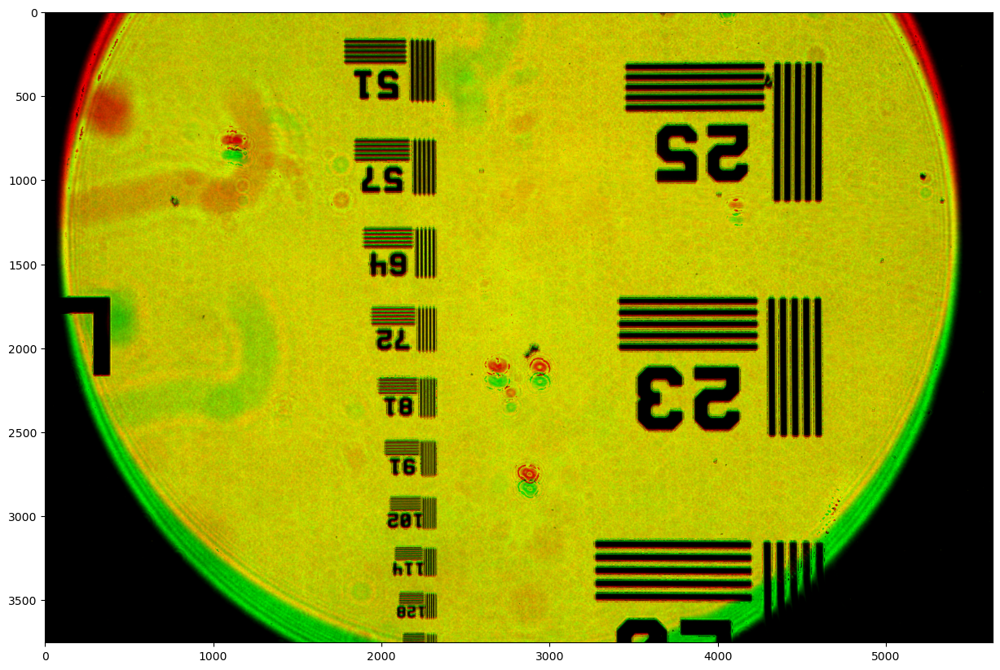

In [356]:
dir_path = "Z:/CSE\CSE-Research/Microscopy3D/CV_CSE_Collaboration/Results/CV_CSE/fpm_capture/output/2023_03_15/2023_03_15_16_02_07/"
file_path = "2023_03_15_16_02_07_img_shutter_05_x_15_y_15_r_0_g_1_b_0.tiff"

img = cv2.imread(dir_path + file_path)

_, g_img, _ = cv2.split(img)

dir_path = "Z:/CSE\CSE-Research/Microscopy3D/CV_CSE_Collaboration/Results/CV_CSE/fpm_capture/output/2023_03_15/2023_03_15_16_02_07/"
file_path = "2023_03_15_16_02_07_img_shutter_05_x_15_y_14_r_0_g_1_b_0.tiff"

img = cv2.imread(dir_path + file_path)

_, g_img_2, _ = cv2.split(img)

ch_img_1 = np.zeros_like(img)
ch_img_1[:, :, 0] = g_img

ch_img_2 = np.zeros_like(img)
ch_img_2[:, :, 1] = g_img_2

new_img = np.array((ch_img_1 + ch_img_2)*2, dtype=np.uint8)

fig, ax = plt.subplots(1,1, figsize=(15, 15))
ax.imshow(new_img)
plt.show()

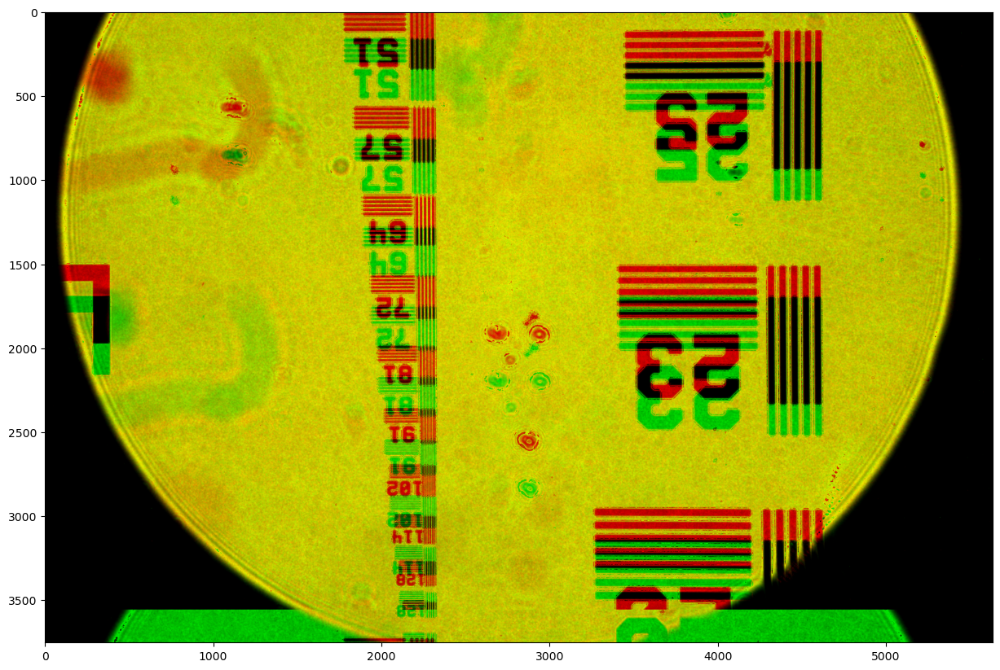

In [357]:
ch_img_1 = np.zeros_like(img)
ch_img_1[:, :, 0] = g_img

ch_img_2 = np.zeros_like(img)
ch_img_2[:, :, 1] = g_img_2

new_img = np.array((ch_img_1 + np.roll(ch_img_2, (-3, -195), axis=(1, 0)))*2, dtype=np.uint8)

fig, ax = plt.subplots(1,1, figsize=(15, 15))
ax.imshow(new_img)
plt.show()

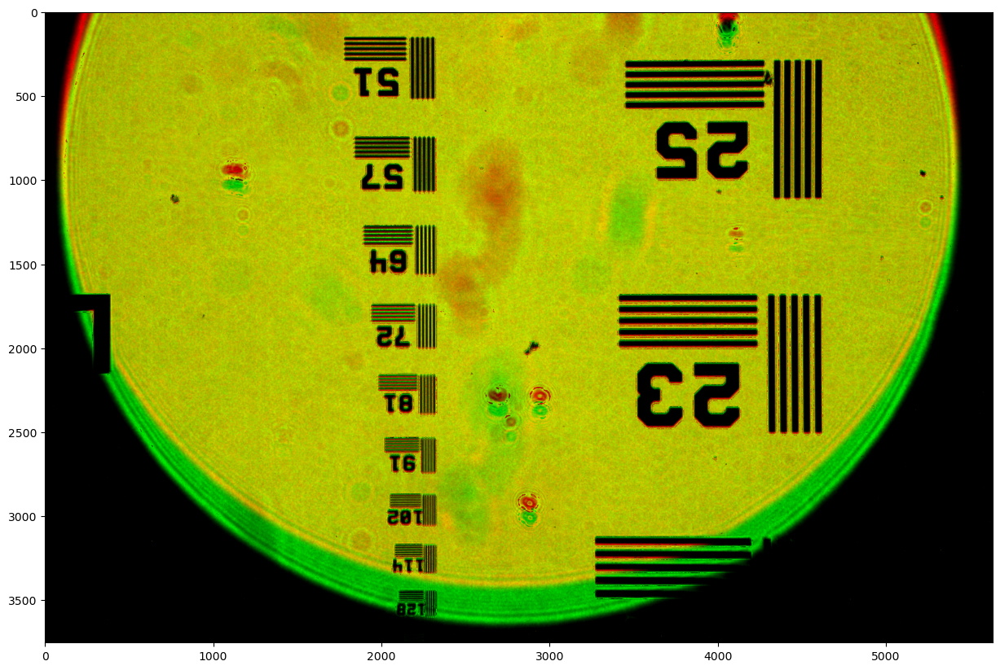

In [358]:
dir_path = "Z:/CSE\CSE-Research/Microscopy3D/CV_CSE_Collaboration/Results/CV_CSE/fpm_capture/output/2023_03_15/2023_03_15_16_02_07/"
file_path = "2023_03_15_16_02_07_img_shutter_05_x_15_y_17_r_0_g_1_b_0.tiff"

img = cv2.imread(dir_path + file_path)

_, g_img, _ = cv2.split(img)

dir_path = "Z:/CSE\CSE-Research/Microscopy3D/CV_CSE_Collaboration/Results/CV_CSE/fpm_capture/output/2023_03_15/2023_03_15_16_02_07/"
file_path = "2023_03_15_16_02_07_img_shutter_05_x_15_y_16_r_0_g_1_b_0.tiff"

img = cv2.imread(dir_path + file_path)

_, g_img_2, _ = cv2.split(img)

ch_img_1 = np.zeros_like(img)
ch_img_1[:, :, 0] = g_img

ch_img_2 = np.zeros_like(img)
ch_img_2[:, :, 1] = g_img_2

new_img = np.array((ch_img_1 + ch_img_2)*2, dtype=np.uint8)

fig, ax = plt.subplots(1,1, figsize=(15, 15))
ax.imshow(new_img)
plt.show()

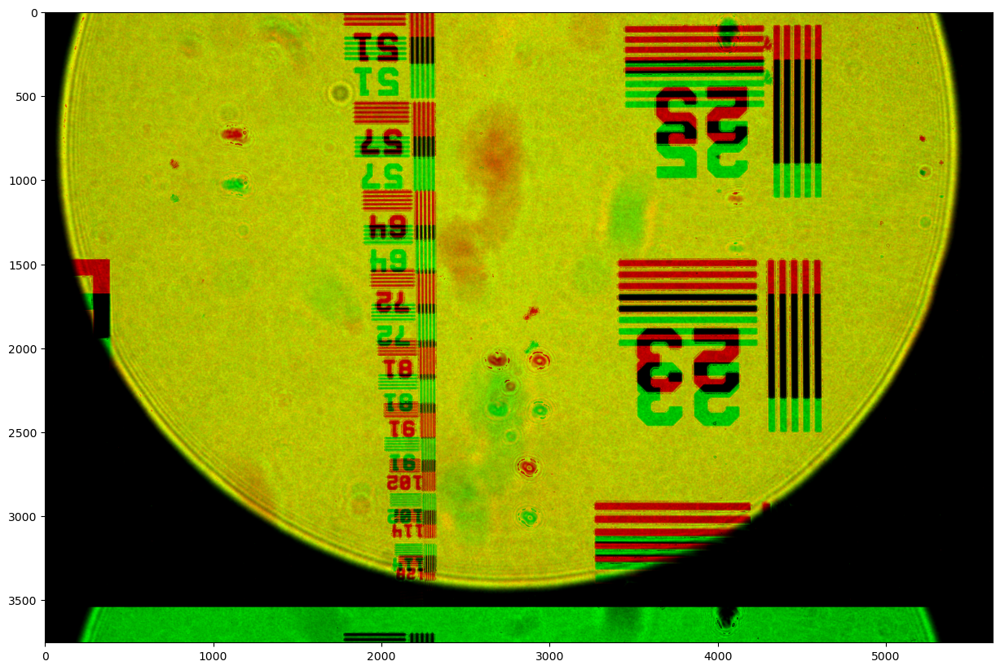

In [362]:
ch_img_1 = np.zeros_like(img)
ch_img_1[:, :, 0] = g_img

ch_img_2 = np.zeros_like(img)
ch_img_2[:, :, 1] = g_img_2

new_img = np.array((ch_img_1 + np.roll(ch_img_2, (-3, -210), axis=(1, 0)))*2, dtype=np.uint8)

fig, ax = plt.subplots(1,1, figsize=(15, 15))
ax.imshow(new_img)
plt.show()

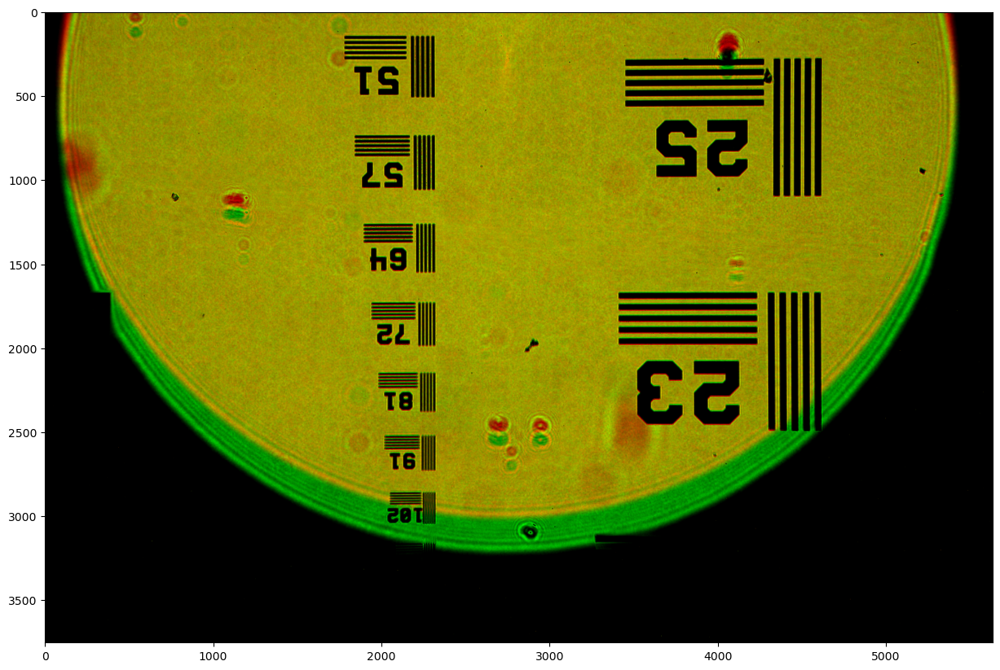

In [363]:
dir_path = "Z:/CSE\CSE-Research/Microscopy3D/CV_CSE_Collaboration/Results/CV_CSE/fpm_capture/output/2023_03_15/2023_03_15_16_02_07/"
file_path = "2023_03_15_16_02_07_img_shutter_05_x_15_y_19_r_0_g_1_b_0.tiff"

img = cv2.imread(dir_path + file_path)

_, g_img, _ = cv2.split(img)

dir_path = "Z:/CSE\CSE-Research/Microscopy3D/CV_CSE_Collaboration/Results/CV_CSE/fpm_capture/output/2023_03_15/2023_03_15_16_02_07/"
file_path = "2023_03_15_16_02_07_img_shutter_05_x_15_y_18_r_0_g_1_b_0.tiff"

img = cv2.imread(dir_path + file_path)

_, g_img_2, _ = cv2.split(img)

ch_img_1 = np.zeros_like(img)
ch_img_1[:, :, 0] = g_img

ch_img_2 = np.zeros_like(img)
ch_img_2[:, :, 1] = g_img_2

new_img = np.array((ch_img_1 + ch_img_2)*2, dtype=np.uint8)

fig, ax = plt.subplots(1,1, figsize=(15, 15))
ax.imshow(new_img)
plt.show()

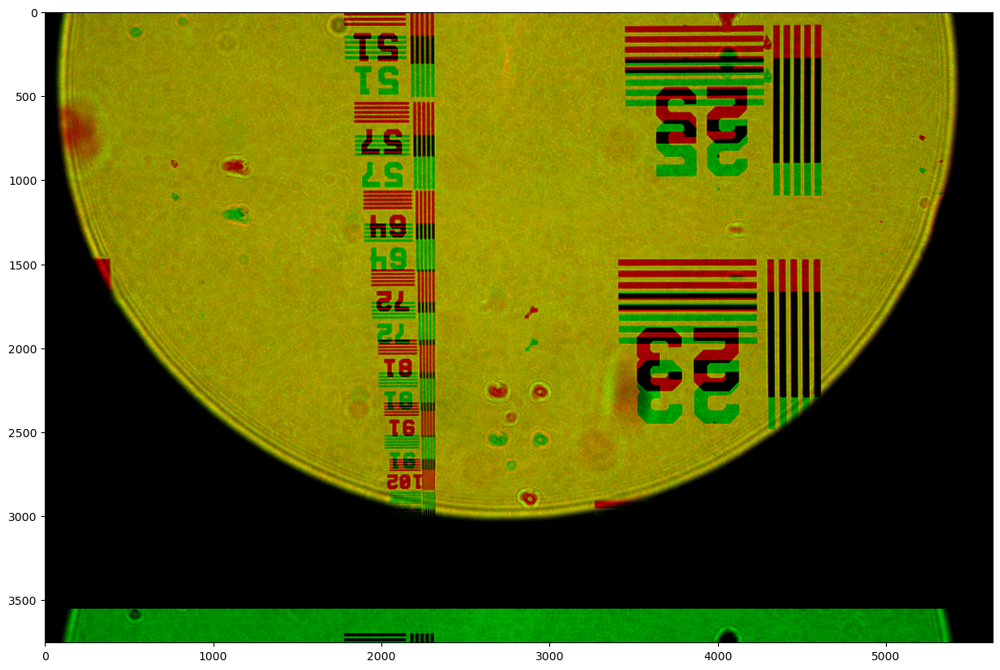

In [365]:
ch_img_1 = np.zeros_like(img)
ch_img_1[:, :, 0] = g_img

ch_img_2 = np.zeros_like(img)
ch_img_2[:, :, 1] = g_img_2

new_img = np.array((ch_img_1 + np.roll(ch_img_2, (-3, -200), axis=(1, 0)))*2, dtype=np.uint8)

fig, ax = plt.subplots(1,1, figsize=(15, 15))
ax.imshow(new_img)
plt.show()

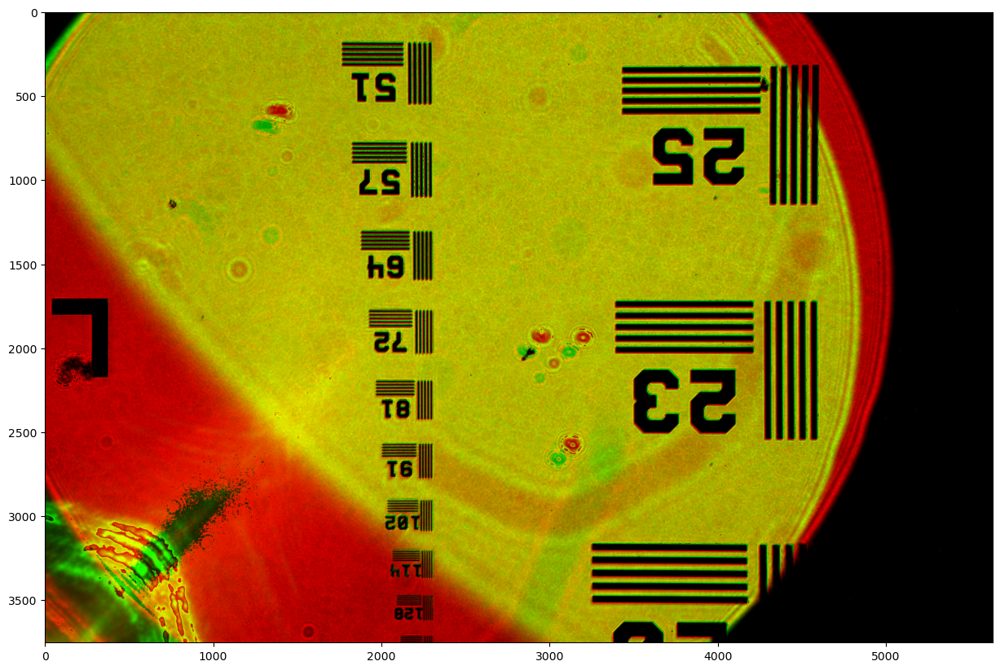

In [376]:
dir_path = "Z:/CSE\CSE-Research/Microscopy3D/CV_CSE_Collaboration/Results/CV_CSE/fpm_capture/output/2023_03_15/2023_03_15_16_02_07/"
file_path = "2023_03_15_16_02_07_img_shutter_05_x_13_y_13_r_0_g_1_b_0.tiff"

img = cv2.imread(dir_path + file_path)

_, g_img, _ = cv2.split(img)

dir_path = "Z:/CSE\CSE-Research/Microscopy3D/CV_CSE_Collaboration/Results/CV_CSE/fpm_capture/output/2023_03_15/2023_03_15_16_02_07/"
file_path = "2023_03_15_16_02_07_img_shutter_05_x_12_y_12_r_0_g_1_b_0.tiff"

img = cv2.imread(dir_path + file_path)

_, g_img_2, _ = cv2.split(img)

ch_img_1 = np.zeros_like(img)
ch_img_1[:, :, 0] = g_img

ch_img_2 = np.zeros_like(img)
ch_img_2[:, :, 1] = g_img_2

new_img = np.array((ch_img_1 + ch_img_2)*2, dtype=np.uint8)

fig, ax = plt.subplots(1,1, figsize=(15, 15))
ax.imshow(new_img)
plt.show()

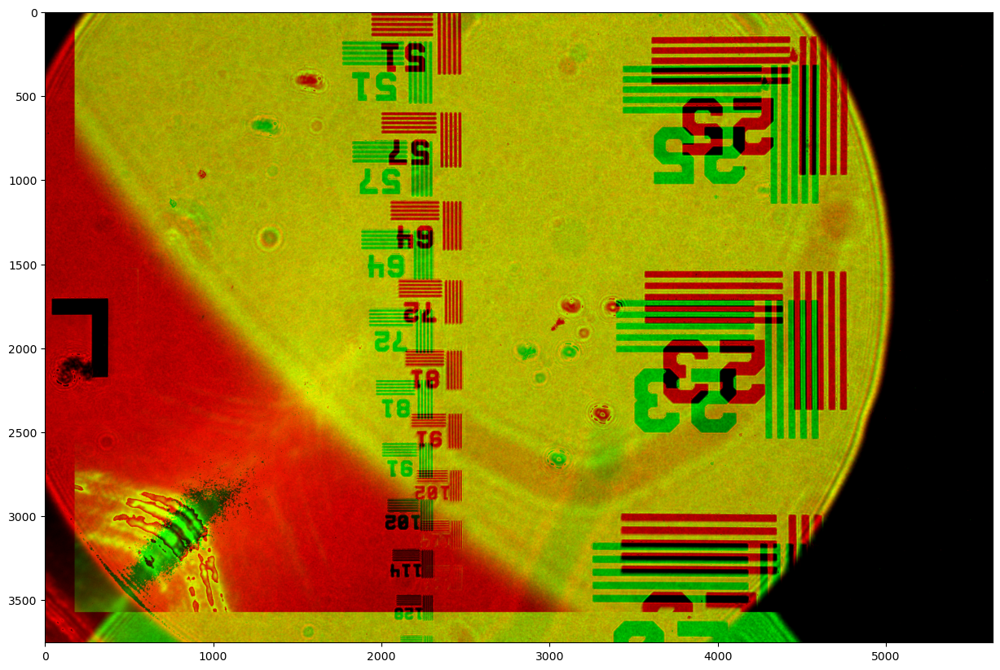

In [389]:
ch_img_1 = np.zeros_like(img)
ch_img_1[:, :, 0] = g_img

ch_img_2 = np.zeros_like(img)
ch_img_2[:, :, 1] = g_img_2

new_img = np.array((ch_img_1 + np.roll(ch_img_2, (177, -180), axis=(1, 0)))*2, dtype=np.uint8)

fig, ax = plt.subplots(1,1, figsize=(15, 15))
ax.imshow(new_img)
plt.show()

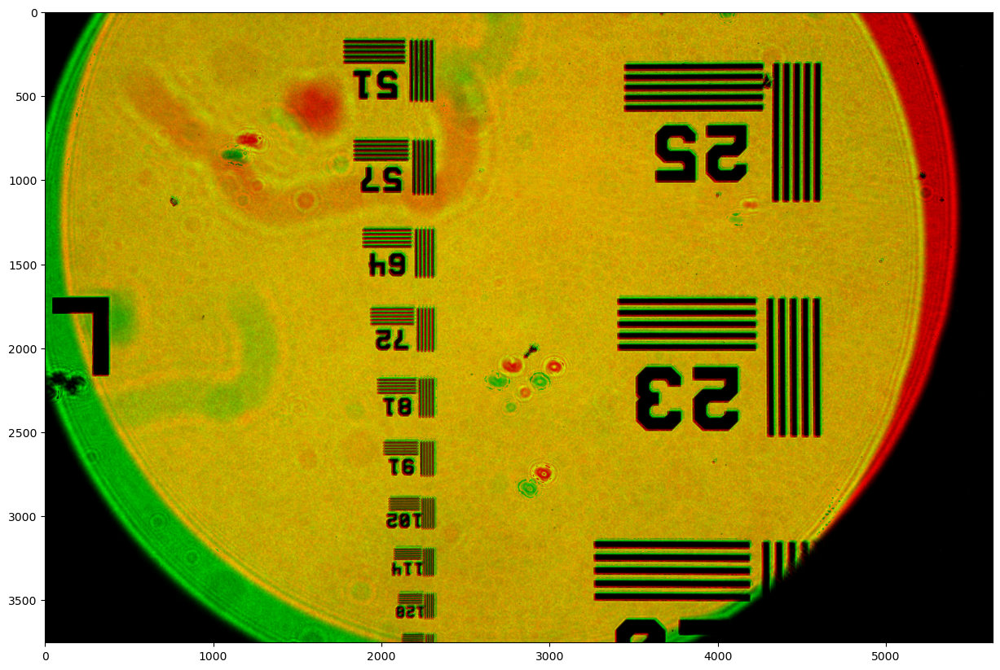

In [390]:
dir_path = "Z:/CSE\CSE-Research/Microscopy3D/CV_CSE_Collaboration/Results/CV_CSE/fpm_capture/output/2023_03_15/2023_03_15_16_02_07/"
file_path = "2023_03_15_16_02_07_img_shutter_05_x_15_y_15_r_0_g_1_b_0.tiff"

img = cv2.imread(dir_path + file_path)

_, g_img, _ = cv2.split(img)

dir_path = "Z:/CSE\CSE-Research/Microscopy3D/CV_CSE_Collaboration/Results/CV_CSE/fpm_capture/output/2023_03_15/2023_03_15_16_02_07/"
file_path = "2023_03_15_16_02_07_img_shutter_05_x_14_y_14_r_0_g_1_b_0.tiff"

img = cv2.imread(dir_path + file_path)

_, g_img_2, _ = cv2.split(img)

ch_img_1 = np.zeros_like(img)
ch_img_1[:, :, 0] = g_img

ch_img_2 = np.zeros_like(img)
ch_img_2[:, :, 1] = g_img_2

new_img = np.array((ch_img_1 + ch_img_2)*2, dtype=np.uint8)

fig, ax = plt.subplots(1,1, figsize=(15, 15))
ax.imshow(new_img)
plt.show()

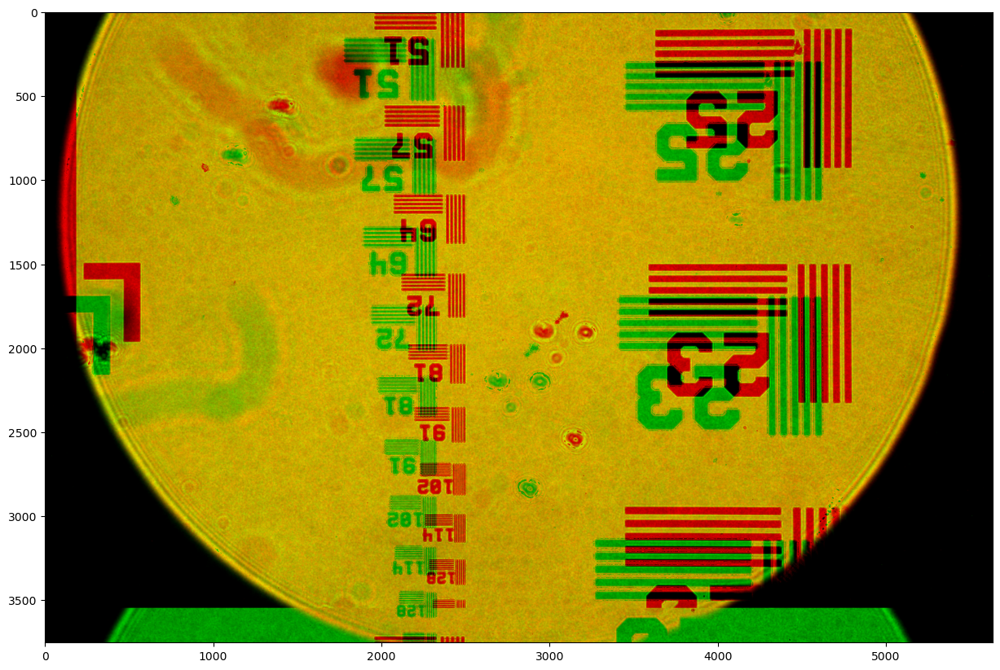

In [395]:
ch_img_1 = np.zeros_like(img)
ch_img_1[:, :, 0] = g_img

ch_img_2 = np.zeros_like(img)
ch_img_2[:, :, 1] = g_img_2

new_img = np.array((ch_img_1 + np.roll(ch_img_2, (187, -205), axis=(1, 0)))*2, dtype=np.uint8)

fig, ax = plt.subplots(1,1, figsize=(15, 15))
ax.imshow(new_img)
plt.show()

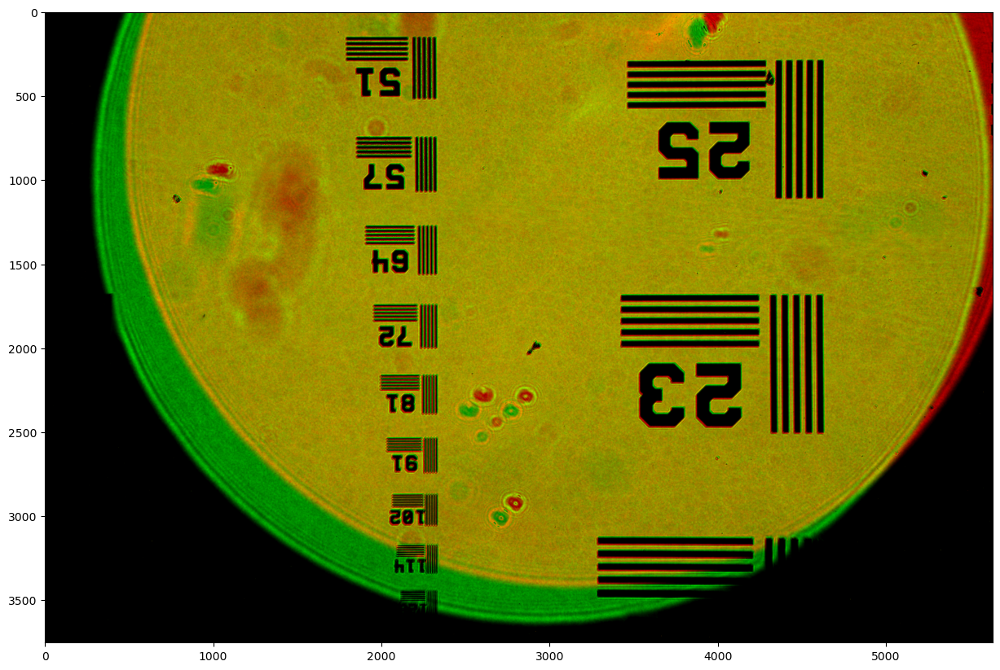

In [396]:
dir_path = "Z:/CSE\CSE-Research/Microscopy3D/CV_CSE_Collaboration/Results/CV_CSE/fpm_capture/output/2023_03_15/2023_03_15_16_02_07/"
file_path = "2023_03_15_16_02_07_img_shutter_05_x_17_y_17_r_0_g_1_b_0.tiff"

img = cv2.imread(dir_path + file_path)

_, g_img, _ = cv2.split(img)

dir_path = "Z:/CSE\CSE-Research/Microscopy3D/CV_CSE_Collaboration/Results/CV_CSE/fpm_capture/output/2023_03_15/2023_03_15_16_02_07/"
file_path = "2023_03_15_16_02_07_img_shutter_05_x_16_y_16_r_0_g_1_b_0.tiff"

img = cv2.imread(dir_path + file_path)

_, g_img_2, _ = cv2.split(img)

ch_img_1 = np.zeros_like(img)
ch_img_1[:, :, 0] = g_img

ch_img_2 = np.zeros_like(img)
ch_img_2[:, :, 1] = g_img_2

new_img = np.array((ch_img_1 + ch_img_2)*2, dtype=np.uint8)

fig, ax = plt.subplots(1,1, figsize=(15, 15))
ax.imshow(new_img)
plt.show()

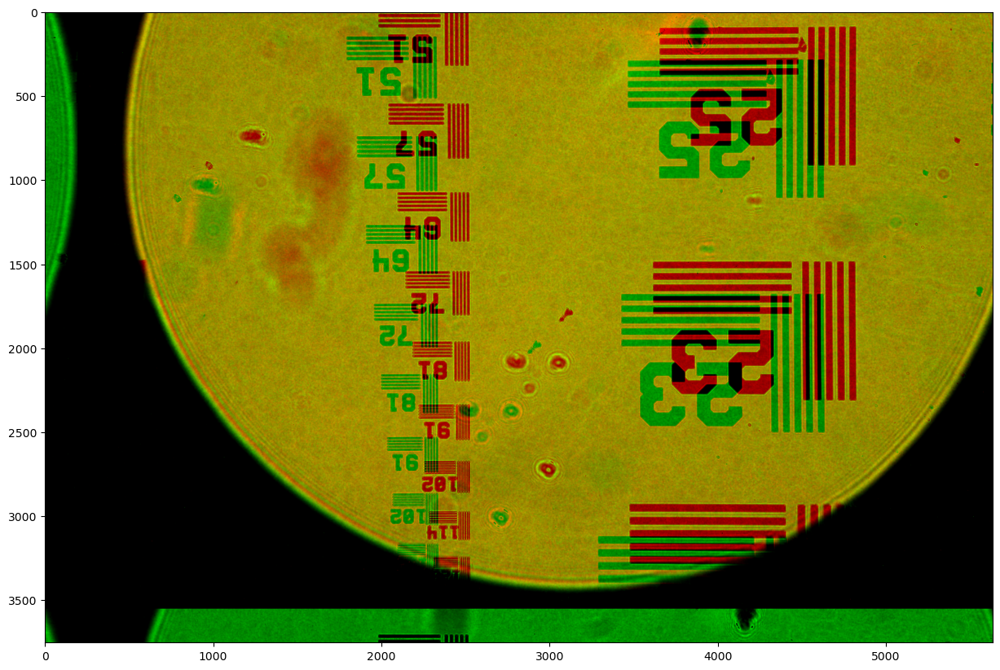

In [410]:
ch_img_1 = np.zeros_like(img)
ch_img_1[:, :, 0] = g_img

ch_img_2 = np.zeros_like(img)
ch_img_2[:, :, 1] = g_img_2

new_img = np.array((ch_img_1 + np.roll(ch_img_2, (195, -200), axis=(1, 0)))*2, dtype=np.uint8)

fig, ax = plt.subplots(1,1, figsize=(15, 15))
ax.imshow(new_img)
plt.show()

### Deductions: 
* Movement across x-axis is constant
* Movement accross y-axis seems to reduce as you go farther from it
* Movement diagonally is changing. Maybe the same as y-axis and because of it.

## Find optimal parameters for ellipses

In [492]:
dir_path = "Z:/CSE\CSE-Research/Microscopy3D/CV_CSE_Collaboration/Results/CV_CSE/fpm_capture/output/2023_03_15/2023_03_15_16_02_07/"
file_path = "2023_03_15_16_02_07_img_shutter_05_x_17_y_17_r_0_g_1_b_0.tiff"

img = cv2.imread(dir_path + file_path)

_, g_img, _ = cv2.split(img)

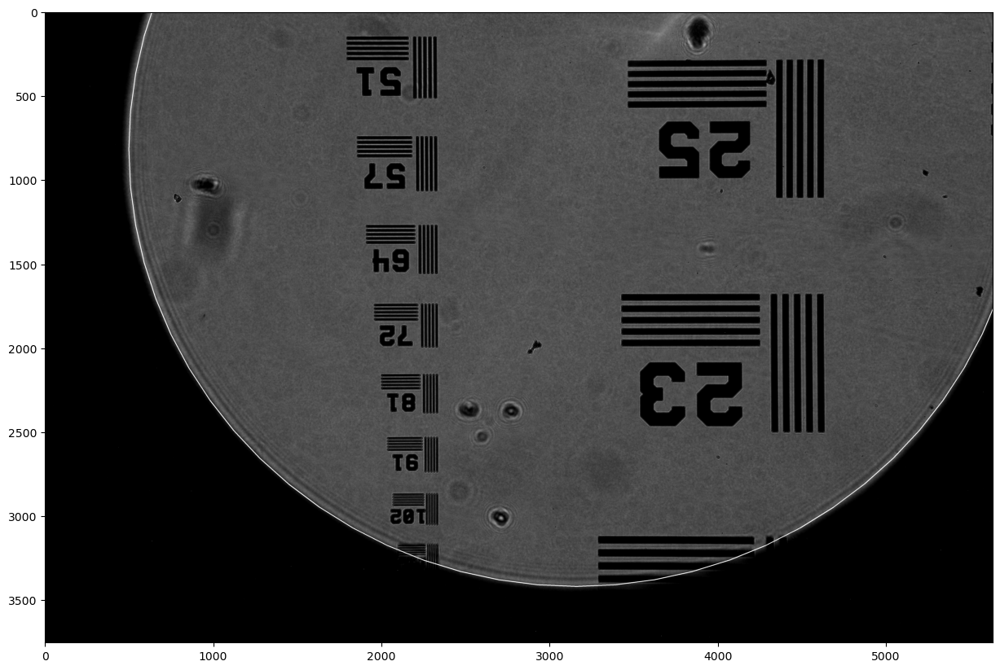

In [531]:
g_img_2 = g_img.copy()
ellipse = ((2755+390+15, 1210-390),
           (5322, 5200),
           0)

# 17,17 -> not a good fit: more elliptical
# ((2755+390+15, 1210-390),
#            (5322, 5200),
#            0)

# 13,13
# ((2755-390, 1210+390),
#            (5322, 5322),
#            0)

# 15, 17
# ((2755, 1210-380),
#            (5322, 5200),
#            0)

# 15, 13
# ((2755, 1210+400/390),
#            (5320, 5320),
#            0)

# 13,15: 
# ((2765-410, 1210-15),
#            (5320, 5320),
#            0)

# 15,15:
# ((2765, 1210),
#            (5320, 5320),
#            0)

# 17,15:
# ((2765+390, 1210-20),
#            (5320, 5320),
#            0)


cv2.ellipse(g_img_2, ellipse, 255, 4)
fig, ax = plt.subplots(1,1, figsize=(15, 15))
ax.imshow(g_img_2, cmap='gray')
plt.show()

## Observations:

* For many close to the center (that are tested), a circle seems to fit the boundary of the object well
* As the y index of the LEDs increases, it becomes tougher (impossible?) to fit a circle on the boundary of the object

In [8]:
def contour_points_v2(g_img):

    kernel = np.ones((15, 15), np.uint8)
    gradient = cv2.morphologyEx(g_img, cv2.MORPH_GRADIENT, kernel)
    
    blur = cv2.GaussianBlur(gradient + 20, (5, 5), 0)
    ret3, th3 = cv2.threshold(blur, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

    gradient_img = np.zeros_like(g_img, dtype=np.uint8)

    contours, _ = cv2.findContours(th3, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    if len(contours) < 1:
        return None
    
    cv2.drawContours(gradient_img, contours, -1, 255, 2)

    kernel = np.ones((25, 25),np.uint8)
    gradient_img = cv2.dilate(gradient_img, kernel, iterations = 1)    


    hull_img = np.zeros_like(g_img, dtype=np.uint8)

    blur = cv2.GaussianBlur(g_img, (3, 3), 0)
    ret3, th3 = cv2.threshold(blur, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

    contours, _ = cv2.findContours(th3, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    
    if len(contours) < 1:
        return None
    
    area_cntrs = [cv2.contourArea(cnt) for cnt in contours]
    max_cntr_index = np.argmax(area_cntrs)
    cnt = contours[max_cntr_index]

    hull = cv2.convexHull(cnt)
    cv2.drawContours(hull_img, [hull], 0, 125, 2)

    op = np.logical_and(gradient_img, hull_img).astype(np.uint8)*255

#     op[:10, :] = 0
#     op[-10:, :] = 0

#     kernel = np.ones((3, 3), np.uint8)
#     opening = cv2.morphologyEx(op, cv2.MORPH_OPEN, kernel)
    

#     final_cnt = np.take(final_cnt, list(set(np.random.randint(0, final_cnt.shape[0], size=int(final_cnt.shape[0]/10)))), axis=0)
#     imgs = np.hstack([gradient_img, hull_img, opening])
    
#     if final_cnt.shape[0] > 4:
#         return op
    
#     else:
#         return None
    return op

In [9]:

# Ivo's implemetation of Ellipse class

class Ellipse:

    C : np.array #homogeneous conic matrix x'*C*x=0

    def __init__( self, C : np.array ):

        self.C = C
        

    @classmethod
    def estimate_ellipsoid( cls, points : np.array ):
        """
        C = estimate_ellipsoid_2D ( points )
        ----------------------------------

        estimates a homogeneous ellipsoid C
        
        x'*C*x = 0
        
        from a number of point samples 
        (in a least squares sense)
        
        format of points

                [ x^1_1 . . . . .  x^N_1 ] 
                [  .                 .   ]
        points = [  .                 .   ]
                [  .                 .   ]
                [ x^1_n . . . . .  x^N_n ]
                [  1    . . . . .    1   ]

        where each point is element R^n
        and there are N points, the points  
        have to be in homogeneous coordinates.
        
        """

        n = points.shape[0]
        num_entries = int((n+1) * n/2)
        
        if points.shape[1] < num_entries-1:
            print('insufficient number of points, need at least {}'.format( num_entries-1 ) )
    
        # --------------  estimate ellipse ---------------

        # assemble linear system
        A = np.zeros( [points.shape[ 1 ], num_entries ] )

        #for all points
        for i in range( 0, points.shape[ 1 ] ):
        
            #extract point
            x = np.array([points[:, i]]).T
            #print(x)
            X  = np.matmul( x, x.T )
            #print(X)
            X2 = X.T + X - np.diag( np.diag( X ) )

            #print(X2)
            row = X2[ np.where( np.triu( np.ones( X2.shape ) ) ) ]
            #print(row)

            A[ i, : ] = row

        #print(A)

        #solve for null space 
        U,D,V = np.linalg.svd( A )

        ell = V[-1,:]


        #create conic matrix
        Cd = np.zeros( X2.shape )

        Cd[ np.where( np.triu( np.ones( X2.shape ) ) ) ] = ell

        C = Cd + Cd.T - np.diag( np.diag ( Cd ) )

        #detC =  np.linalg.det( C[0:-1,0:-1] )

        #print(detC)

        if Ellipse.is_hyperboloid( C ):
            print('Warning: result is a hyperboloid!')
        

        if Ellipse.is_paraboloid( C ):
            print('Warning: result is a paraboloid!')
        
        return C

    @classmethod
    def cov_mean_to_ellipsoid( cls, cov, mean, k ):
        """
            C = cov_mean_to_ellipsoid_homog ( Cov, Mean, k )
            ----------------------------------
        
            generates a homogeneous ellipsoid C
            
            x'*C*x = 0
        
            from covariance matrix and mean value
            of a gaussian distribution
            
            k is a confidence factor determibed by the chi^2 
            distribution. The probability that x is inside 
            the ellipsoid is P_{chi^2}(k,2). Some values 
            for k are 2.41 (70%) and k=5.99 (95%).
            
            cov  : np.array - covariance matrix (non-homogeneous)
            mean : np.array - mean value (vector)
            k : float - confidence factor, see above 

        """

        #column vector, assume we get a 1D array
        mean = np.array( [mean] ).T

        SIGMAinv = np.linalg.inv( cov )

        lastentry = np.matmul( mean.T, np.matmul( SIGMAinv, mean ) ) - k 
        C = np.vstack( [ np.hstack( [ SIGMAinv, -np.matmul(SIGMAinv, mean)] ), 
                         np.hstack( [ -np.matmul(mean.T,SIGMAinv), lastentry] ) ] )
        
        return C

    @classmethod
    def srt_to_ellipsoid( cls, S, R, T ): 
        """
         C = srt_to_ellipsoid_homog ( S, R, T )
         ----------------------------------
        
         generates a homogeneous ellipsoid C
         
         x'*C*x = 0
        
         from translation, rotation and scale parts as
        
         x'* (T^-1 * R^-1 * S^-1) ( S * R * T ) x = 0
        
         see: Ivo Ihrke: "Some Notes on Ellipses", TechReport, 2004
        """
        #function C = srt_to_ellipsoid_homog ( S, R, T )


        invT = np.linalg.inv( T )
        invR = R.T
        invS = np.linalg.inv( S )

        left  = np.matmul( invT.T, np.matmul( invR.T, invS.T ) )
        right = np.matmul( invS, np.matmul( invR, invT ) )

        C = np.matmul( left, right )
    
        return C



    @classmethod
    def decompose_ellipsoid( cls, C ):
        """
        
         [S,R,T] = decompose_ellipsoid_homog ( C )
         ----------------------------------
        
         decomposes a homogeneous ellipsoid C
         
         x'*C*x = 0
        
         into translation, rotation and scale parts
        
         x'* (T^-1 * R^-1 * S^-1) ( S * R * T ) x = 0
        
         Note that C \neq (T^-1 * R^-1 * S^-1) ( S * R * T )
         in some cases because the orientation of 
         the ellipsoid's major axis is not fixed.
         The function generates a right handed system.

        """

        #print(C)
        C_ih = C[0:-1,0:-1] 
        #print(C_ih)

        t = -np.matmul( np.linalg.pinv( C_ih ), C[0:-1,-1] )

        T = np.eye( C.shape[ 0 ] )
        T[0:-1, -1 ] = t

        U,D,V = np.linalg.svd( C_ih )

        R = np.eye( C.shape[ 0 ] )
        R[0:-1,0:-1] = V


        #S = R' * T' * C * T * R;
        S = np.matmul( R.T, np.matmul( T.T, np.matmul( C, np.matmul( T, R ) ) ) )

        S = S / S[-1,-1]

        S = np.sqrt( np.diag(1/abs(np.diag(S))))

        return S, R, T

    @classmethod
    def is_ellipsoid( cls, C ):
        """
         bool = is_ellipsoid_homog ( C )
         ----------------------------------
        
         determines whether homogeneous conic C
         
         x'*C*x = 0
         
         is an ellipsoid
        """

        #function val = conic_is_ellipsoid_homog ( C )

        detC =  np.linalg.det( C[0:-1,0:-1] )

        return detC > 0


    @classmethod
    def is_hyperboloid( cls, C ):
        """
         bool = is_hyperboloid_homog ( C )
         ----------------------------------
        
         determines whether homogeneous conic C
         
         x'*C*x = 0
         
         is a hyperboloid
        """

        
        detC =  np.linalg.det( C[0:-1,0:-1] )

        return detC < 0

    @classmethod
    def is_paraboloid( cls, C ):
        """
         bool = is_paraboloid_homog ( C )
         ----------------------------------
        
         determines whether homogeneous conic C
         
         x'*C*x = 0
         
         is a paraboloid
        """

        
        detC =  np.linalg.det( C[0:-1,0:-1] )

        #maybe with EPS ?
        return detC == 0


    def get_center( self ):
        
        S,R,T = self.decompose_ellipsoid( self.C )


        return [ T[2,0], T[2,1] ]


    def plot( self, ax, **kwargs ):
        """
        plot_ellipsoid_2D ( C, style, N )
        ----------------------------------
        
        plots a homogeneous ellipsoid C
        
        x'*C*x = 0
        
        style is a matlab plot style, e.g. 'b-' (default)
        N is the number of polygon segments to 
        approximate the ellipse
        """

        #function plot_ellipsoid_homog_2d ( C, style, N )

        if not 'style' in locals():
            style = 'b-'

        if not 'N' in locals():
            N = 100



        angles = np.linspace( -np.pi, np.pi, N )

        # generate a unit circle or a unit hyperbola
        if ( Ellipse.is_ellipsoid( self.C ) ):
            #uc  = [ cos(x); sin(x); ones(size(x)) ];
            x  = np.cos( angles )
            y  = np.sin( angles )
            w  = np.ones( angles.shape )

            uc = np.vstack([x,y,w])

        else:
            EPS = 0.1
            x   =  np.linspace( -np.pi/2+EPS, np.pi/2-EPS, int( N/2 ) )#-(pi/2-EPS):((pi-2*EPS)/(N/2)):(pi/2-EPS);
            x2  =  np.linspace( np.pi/2+EPS, 3*np.pi/2-EPS, int( N/2 ) )  #x2 =  (pi/2+EPS):((pi-2*EPS)/(N/2)):(3*pi/2-EPS);
            uc  = np.vstack( [ 1/np.cos(x), np.tan(x), np.ones( x.shape ) ] )
            uc2 = np.vstack( [ 1/np.cos(x2), np.tan(x2), np.ones( x2.shape ) ] )
        
        #decompose
        S,R,T = Ellipse.decompose_ellipsoid( self.C )

        #transform unit circle or parabola 
        transform = np.matmul( T, np.matmul( R, S ) )
        ell  =  np.matmul( transform, uc )

        if 'uc2' in locals():
            ell2  =  np.matmul( transform, uc2 )
            ax.plot( ell2[0,:], ell2[1,:], style )

   
        #plot conic
        ax.plot( ell[0,:], ell[1,:], style )

        #plot coordinate system
        tx = T[0,2]
        ty = T[1,2]
        
#         print(tx, ty)

        smin = S[0,0]
        smaj = S[1,1] 

        ax.plot( np.array( [ tx, tx+smin*R[0,0] ] ), np.array( [ ty, ty+smin*R[1,0] ] ), 'r' )
        ax.plot( np.array( [ tx, tx+smaj*R[0,1] ] ), np.array( [ ty, ty+smaj*R[1,1] ] ), 'b' )

        ax.set_aspect('equal', adjustable='box')
        return (tx, ty)

In [10]:
def fit_ellipse_3(img_name, img_8, g_img_8, ifHull=False, date_now="", method="ivo", save_path=None):
        """ Find and fit an ellipse in an image.
        it should be run on a normalized image I (normalization should exclude dead pixels which are artificially maximum)
        Parameters
        ----------
        path_dir_w_time : str
            _description_
        date_now : str
            _description_

        Returns
        -------
        Ellipse
            Ellipse in an image.
        """

        ellipsoid_points=[]
           
        img = np.array(g_img_8, dtype=np.uint8)
        op = contour_points_v2(img)
        
        op[:20, :] = 0
        op[-20:, :] = 0
        
        op[:, :20] = 0
        op[:, -20:] = 0
        
#         plt.imshow(op)
#         plt.show()
        
        x, y = np.where(op > 1)
        final_cnt = np.vstack([y, x]).T
        
        if final_cnt.shape[0] > 10000:
            final_cnt = np.take(final_cnt, list(set(np.random.randint(0, final_cnt.shape[0], size=10000))), axis=0)

        if final_cnt is None:
            return None, None, None
        else:
            ellipsoid_points = np.array(final_cnt).reshape([-1, 2])
            
        
        ellipsoid_points = np.array(ellipsoid_points).astype('float').T
        ellipsoid_points = np.vstack( [ellipsoid_points, np.ones(ellipsoid_points.shape[1])] )
#         print(ellipsoid_points)
            
        is_det_ellipse = True
        if method == "ivo":
            E = Ellipse( Ellipse.estimate_ellipsoid( ellipsoid_points ) )
            
            if Ellipse.is_ellipsoid( E.C ):
                S,R,T = Ellipse.decompose_ellipsoid(E.C)

                tx = T[0,2]
                ty = T[1,2]

                smin = S[0,0]
                smaj = S[1,1]
                
#                 f = E.C[-1, -1]
                f = np.arctan2(R[1,0], R[0, 0])
#                 print(theta)
#                 print(E.C)
            else:
                is_det_ellipse = False
        else:
            (tx, ty), (smin, smaj), f = cv2.fitEllipse(ellipsoid_points[:2, :].T.astype(np.int32))
            smin, smaj = smin/2, smaj/2


#         print((tx, ty), (smin, smaj), f)
        
        
#             
        if is_det_ellipse:
            for i in range( 0, ellipsoid_points.shape[1] ):
                draw_cross(img_8, (ellipsoid_points[0,i],ellipsoid_points[1,i]), (0, 0, 255), length=20, thickness=5)
        
            cv2.ellipse(img_8, (int(tx), int(ty)), (int(smin), int(smaj)), f, 0, 360, (255, 0, 0), 5)

            draw_cross(img_8, (tx, ty), (0, 255, 0))

#             plt.imshow(img_8)
#             plt.show()
            cv2.imshow('Resized Image', cv2.resize(img_8, (1080, 720), interpolation = cv2.INTER_LINEAR))
            cv2.waitKey(0)
            cv2.destroyAllWindows()
            
            if save_path is not None:
            
                cv2.imwrite(f'{save_path}/{img_name[:-5]}.png', img_8)
        
            return (int(tx), int(ty)), (int(smin), int(smaj)), f
        else:
            return None, None, None

In [906]:
cv2.fitEllipse(ellipsoid_points[:2, :].T.astype(np.int32))

((219.3291473388672, 104.70303344726562),
 (513.478759765625, 532.2569580078125),
 53.40561294555664)

In [1054]:
dir_path = "Z:/CSE\CSE-Research/Microscopy3D/CV_CSE_Collaboration/Results/CV_CSE/fpm_capture/output/2023_03_15/2023_03_15_16_02_07/"
file_path = f"2023_03_15_16_02_07_img_shutter_05_x_13_y_18_r_0_g_1_b_0.tiff"

        
img = cv2.imread(dir_path + file_path, cv2.IMREAD_UNCHANGED)
_, g_img, _ = cv2.split(img)
        
img_8 = cv2.convertScaleAbs(img, alpha=(255/65535))
g_img_8 = cv2.convertScaleAbs(g_img, alpha=(255/65535))

In [1055]:
center, axis, f = fit_ellipse_3(file_path, img_8, g_img_8, ifHull=True, method='ivo')

[[ 7.23449895e-07  7.32307094e-09 -1.69863270e-03]
 [ 7.32307094e-09  7.46098008e-07 -4.49513750e-04]
 [-1.69863270e-03 -4.49513750e-04 -9.99998456e-01]]


In [11]:
def draw_cross(img, cord, color, length=50, thickness=10):
    
    x, y = int(cord[0]), int(cord[1])
    cv2.line(img, (x-length, y-length), (x+length, y+length), color, thickness)
    cv2.line(img, (x+length, y-length), (x-length, y+length), color, thickness)
    
    return img

In [860]:
# # grid based on thumbnail images
# fit_range = np.zeros([7, 7], dtype=np.uint8)
# center_cords_ivo = np.zeros([7, 7, 2], dtype=np.float64)
# axis_lens_ivo = np.zeros([7, 7, 2], dtype=np.float64)

# for x in range(12, 19):
#     for y in range(12, 19):

#         dir_path = "Z:/CSE\CSE-Research/Microscopy3D/CV_CSE_Collaboration/Results/CV_CSE/fpm_capture/output/2023_03_15/2023_03_15_16_02_07/"
#         file_path = f"2023_03_15_16_02_07_img_shutter_05_x_{x}_y_{y}_r_0_g_1_b_0.tiff"
#         print('x:', x, 'y:', y, file_path)
        
#         img = cv2.imread(dir_path + file_path, cv2.IMREAD_UNCHANGED)
#         _, g_img, _ = cv2.split(img)

#         img_8 = cv2.convertScaleAbs(img, alpha=(255/65535))
#         g_img_8 = cv2.convertScaleAbs(g_img, alpha=(255/65535))
        
#         center, axis_size, f = fit_ellipse_3(file_path, img_8, g_img_8, ifHull=True)
        
#         if center is not None:
            
#             good_fit = input("Is it a good fit?")
#             fit_range[x-12, y-12] = int(good_fit)
#             center_cords_ivo[x-12, y-12] = center
#             axis_lens_ivo[x-12, y-12] = axis_size

x: 12 y: 12 2023_03_15_16_02_07_img_shutter_05_x_12_y_12_r_0_g_1_b_0.tiff
Is it a good fit?5
x: 12 y: 13 2023_03_15_16_02_07_img_shutter_05_x_12_y_13_r_0_g_1_b_0.tiff
Is it a good fit?3
x: 12 y: 14 2023_03_15_16_02_07_img_shutter_05_x_12_y_14_r_0_g_1_b_0.tiff
Is it a good fit?4
x: 12 y: 15 2023_03_15_16_02_07_img_shutter_05_x_12_y_15_r_0_g_1_b_0.tiff
Is it a good fit?2
x: 12 y: 16 2023_03_15_16_02_07_img_shutter_05_x_12_y_16_r_0_g_1_b_0.tiff
Is it a good fit?2
x: 12 y: 17 2023_03_15_16_02_07_img_shutter_05_x_12_y_17_r_0_g_1_b_0.tiff
Is it a good fit?2
x: 12 y: 18 2023_03_15_16_02_07_img_shutter_05_x_12_y_18_r_0_g_1_b_0.tiff
x: 13 y: 12 2023_03_15_16_02_07_img_shutter_05_x_13_y_12_r_0_g_1_b_0.tiff
Is it a good fit?1
x: 13 y: 13 2023_03_15_16_02_07_img_shutter_05_x_13_y_13_r_0_g_1_b_0.tiff
Is it a good fit?1
x: 13 y: 14 2023_03_15_16_02_07_img_shutter_05_x_13_y_14_r_0_g_1_b_0.tiff
Is it a good fit?3
x: 13 y: 15 2023_03_15_16_02_07_img_shutter_05_x_13_y_15_r_0_g_1_b_0.tiff
Is it a good fi

## Ivo's Fitting Method with fit_ellipse_3()

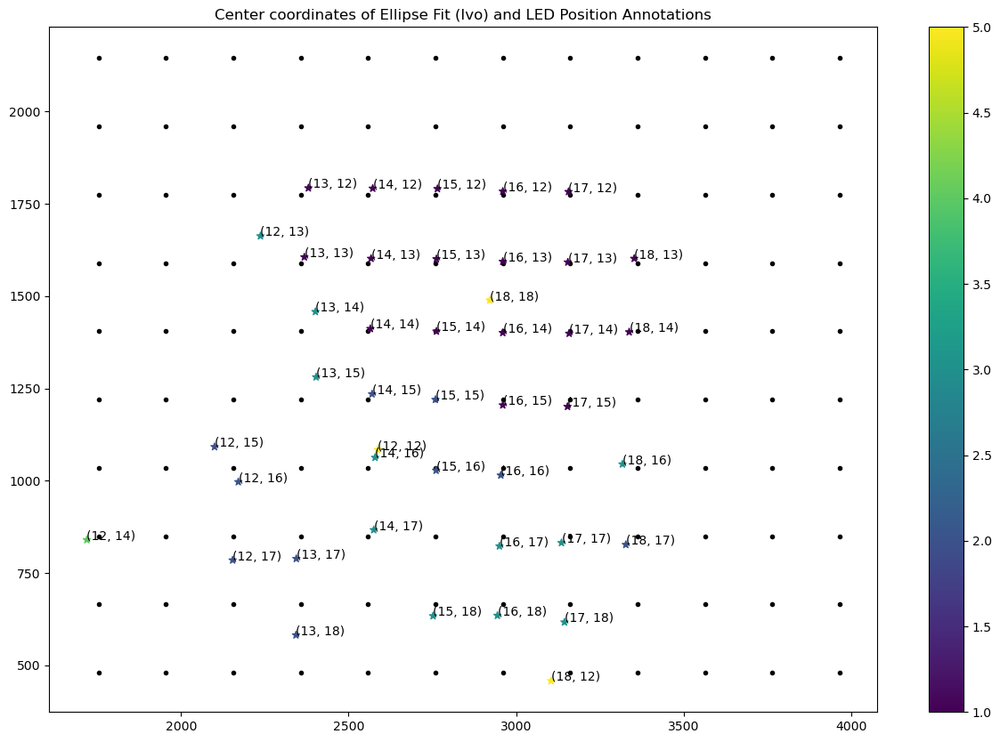

In [890]:
plt.figure(figsize=(15, 10))

center_leds = center_cords_ivo[3, 3]
y_unit_len = center_cords_ivo[3, 2][1] - center_cords_ivo[3, 3][1] 
x_unit_len = center_cords_ivo[4, 3][0] - center_cords_ivo[3, 3][0]

center_leds, y_unit_len, x_unit_len

x_axis = [center_leds[0] - i*x_unit_len for i in range(-6, 6)]
y_axis = [center_leds[1] - i*y_unit_len for i in range(-5, 5)]

xx, yy = np.meshgrid(x_axis, y_axis)
plt.scatter(xx, yy, marker=".", color='black')

x_cords = [x if x != 0.0 else np.nan for x in center_cords_ivo.reshape([-1, 2])[:, 0]]
y_cords = [y if y != 0.0 else np.nan for y in center_cords_ivo.reshape([-1, 2])[:, 1]]
fit_range_2 = [y if y != 0 else np.nan for y in fit_range.reshape(-1)]


plt.scatter(x_cords, y_cords, marker="*", c=fit_range_2)
# plt.grid()

count = 0
for x in range(12, 19):
    for y in range(12, 19):
        plt.annotate(f"({x}, {y})",(x_cords[count], y_cords[count]), fontsize=10)
        count += 1

plt.title("Center coordinates of Ellipse Fit (Ivo) and LED Position Annotations")
# plt.xlim(210, 350)
# plt.ylim(40, 200)
plt.colorbar()
plt.show()

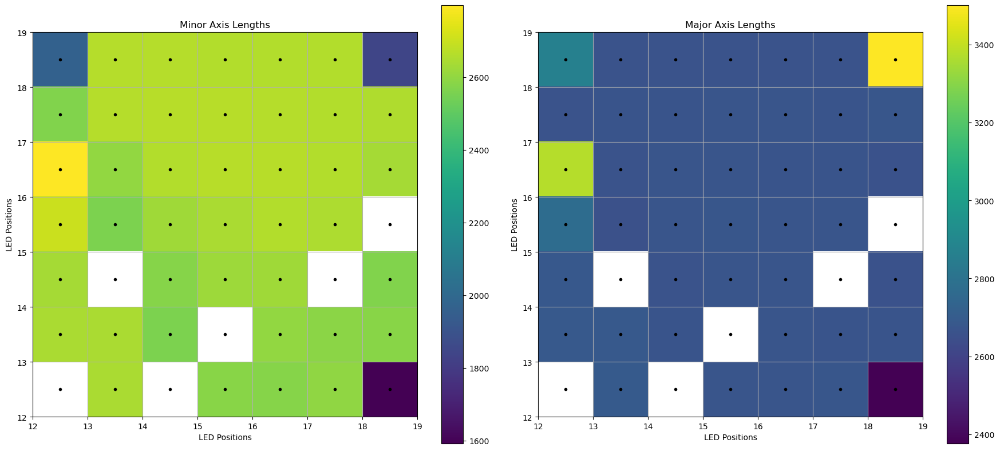

In [894]:
axis_lens_pro = axis_lens_ivo.copy()
axis_lens_pro[np.where(axis_lens_pro==0.)] = np.nan

fig, ax = plt.subplots(1, 2, figsize=(18, 8), layout='tight')

xx, yy = np.meshgrid([i for i in range(12, 19)], [i for i in range(12, 19)])

cp = ax[0].imshow(axis_lens_pro[:, :, 0].T, interpolation='none',
                  extent=[12, 19, 12, 19]
                 )
fig.colorbar(cp)
ax[0].grid()
ax[0].scatter(xx+0.5, yy+0.5, marker=".", color="black")
ax[0].set_title("Minor Axis Lengths")
ax[0].set_xlabel('LED Positions')
ax[0].set_ylabel('LED Positions')


cp = ax[1].imshow(axis_lens_pro[:, :, 1].T, interpolation='none', 
                 extent=[12, 19, 12, 19]
                 )
fig.colorbar(cp)
ax[1].grid()
ax[1].scatter(xx+0.5, yy+0.5, marker=".", color="black")
ax[1].set_title("Major Axis Lengths")
ax[1].set_xlabel('LED Positions')
ax[1].set_ylabel('LED Positions')

plt.show()

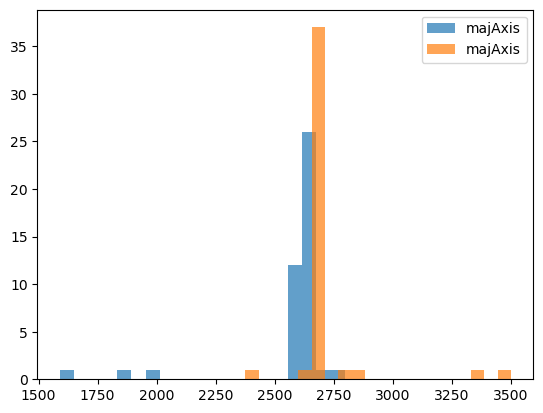

In [1178]:
axis_lens_pro = axis_lens_ivo.copy()
axis_lens_pro[np.where(axis_lens_pro==0.)] = np.nan

plt.hist(axis_lens_pro[:, :, 0].reshape(-1), label='majAxis', bins=20, alpha=0.7)
plt.hist(axis_lens_pro[:, :, 1].reshape(-1), label='majAxis', bins=20, alpha=0.7)
plt.legend()
plt.show()

In [970]:
# # grid based on thumbnail images
# fit_range_cv2 = np.zeros([7, 7], dtype=np.uint8)
# center_cords_cv2 = np.zeros([7, 7, 2], dtype=np.float64)
# axis_lens_cv2 = np.zeros([7, 7, 2], dtype=np.float64)

# save_dir = "C:/Users/Kazim/Desktop/Overall/VignettingCircleDetection/310823_ellipse_cv2_fit_tiff_size"
# for x in range(12, 19):
#     for y in range(12, 19):

#         dir_path = "Z:/CSE\CSE-Research/Microscopy3D/CV_CSE_Collaboration/Results/CV_CSE/fpm_capture/output/2023_03_15/2023_03_15_16_02_07/"
#         file_path = f"2023_03_15_16_02_07_img_shutter_05_x_{x}_y_{y}_r_0_g_1_b_0.tiff"
#         print('x:', x, 'y:', y, file_path)
        
#         img = cv2.imread(dir_path + file_path, cv2.IMREAD_UNCHANGED)
#         _, g_img, _ = cv2.split(img)

#         img_8 = cv2.convertScaleAbs(img, alpha=(255/65535))
#         g_img_8 = cv2.convertScaleAbs(g_img, alpha=(255/65535))
        
#         center, axis_size, f = fit_ellipse_3(file_path, img_8, g_img_8, ifHull=True, method='opencv', save_path=save_dir)
        
#         if center is not None:
            
#             good_fit = input("Is it a good fit?")
#             fit_range_cv2[x-12, y-12] = int(good_fit)
#             center_cords_cv2[x-12, y-12] = center
#             axis_lens_cv2[x-12, y-12] = axis_size

x: 12 y: 12 2023_03_15_16_02_07_img_shutter_05_x_12_y_12_r_0_g_1_b_0.tiff
Is it a good fit?5
x: 12 y: 13 2023_03_15_16_02_07_img_shutter_05_x_12_y_13_r_0_g_1_b_0.tiff
Is it a good fit?1
x: 12 y: 14 2023_03_15_16_02_07_img_shutter_05_x_12_y_14_r_0_g_1_b_0.tiff
Is it a good fit?1
x: 12 y: 15 2023_03_15_16_02_07_img_shutter_05_x_12_y_15_r_0_g_1_b_0.tiff
Is it a good fit?1
x: 12 y: 16 2023_03_15_16_02_07_img_shutter_05_x_12_y_16_r_0_g_1_b_0.tiff
Is it a good fit?1
x: 12 y: 17 2023_03_15_16_02_07_img_shutter_05_x_12_y_17_r_0_g_1_b_0.tiff
Is it a good fit?1
x: 12 y: 18 2023_03_15_16_02_07_img_shutter_05_x_12_y_18_r_0_g_1_b_0.tiff
Is it a good fit?2
x: 13 y: 12 2023_03_15_16_02_07_img_shutter_05_x_13_y_12_r_0_g_1_b_0.tiff
Is it a good fit?1
x: 13 y: 13 2023_03_15_16_02_07_img_shutter_05_x_13_y_13_r_0_g_1_b_0.tiff
Is it a good fit?1
x: 13 y: 14 2023_03_15_16_02_07_img_shutter_05_x_13_y_14_r_0_g_1_b_0.tiff
Is it a good fit?1
x: 13 y: 15 2023_03_15_16_02_07_img_shutter_05_x_13_y_15_r_0_g_1_b_0.t

## OpenCV Ellipse Fit using fit_ellipse_3()

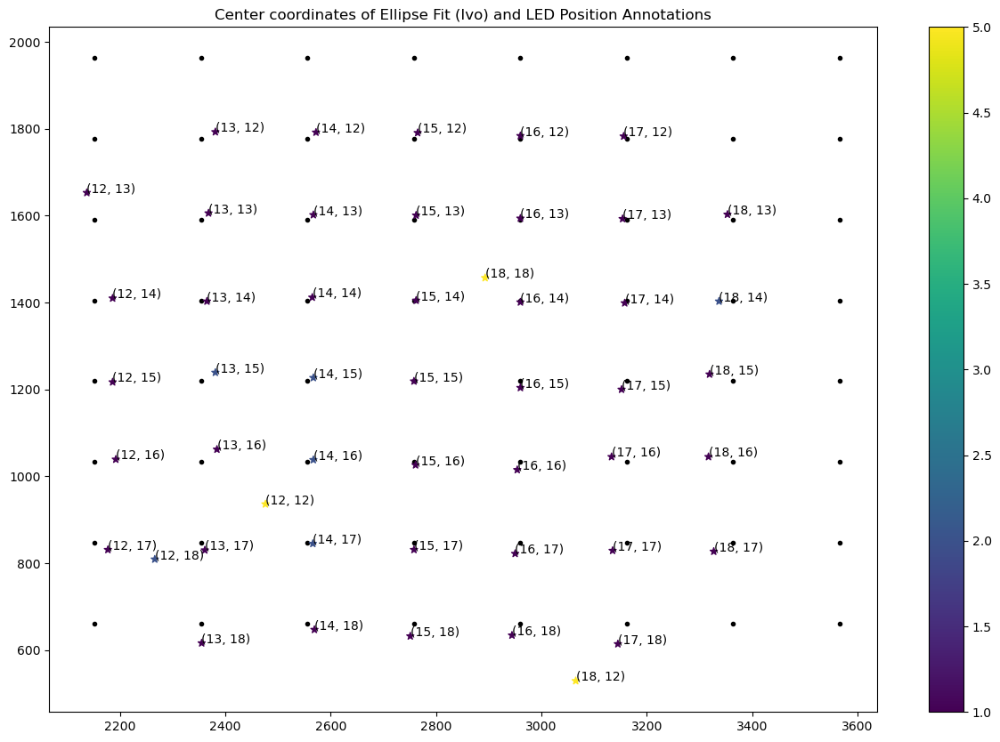

In [972]:
plt.figure(figsize=(15, 10))

center_leds = center_cords_cv2[3, 3]
y_unit_len = center_cords_cv2[3, 2][1] - center_cords_cv2[3, 3][1] 
x_unit_len = center_cords_cv2[4, 3][0] - center_cords_cv2[3, 3][0]

center_leds, y_unit_len, x_unit_len

x_axis = [center_leds[0] - i*x_unit_len for i in range(-4, 4)]
y_axis = [center_leds[1] - i*y_unit_len for i in range(-4, 4)]

xx, yy = np.meshgrid(x_axis, y_axis)
plt.scatter(xx, yy, marker=".", color='black')

x_cords = [x if x != 0.0 else np.nan for x in center_cords_cv2.reshape([-1, 2])[:, 0]]
y_cords = [y if y != 0.0 else np.nan for y in center_cords_cv2.reshape([-1, 2])[:, 1]]
fit_range_2 = [y if y != 0 else np.nan for y in fit_range_cv2.reshape(-1)]


plt.scatter(x_cords, y_cords, marker="*", c=fit_range_2)
# plt.grid()

count = 0
for x in range(12, 19):
    for y in range(12, 19):
        plt.annotate(f"({x}, {y})",(x_cords[count], y_cords[count]), fontsize=10)
        count += 1

plt.title("Center coordinates of Ellipse Fit (Ivo) and LED Position Annotations")
# plt.xlim(210, 350)
# plt.ylim(40, 200)
plt.colorbar()
plt.show()

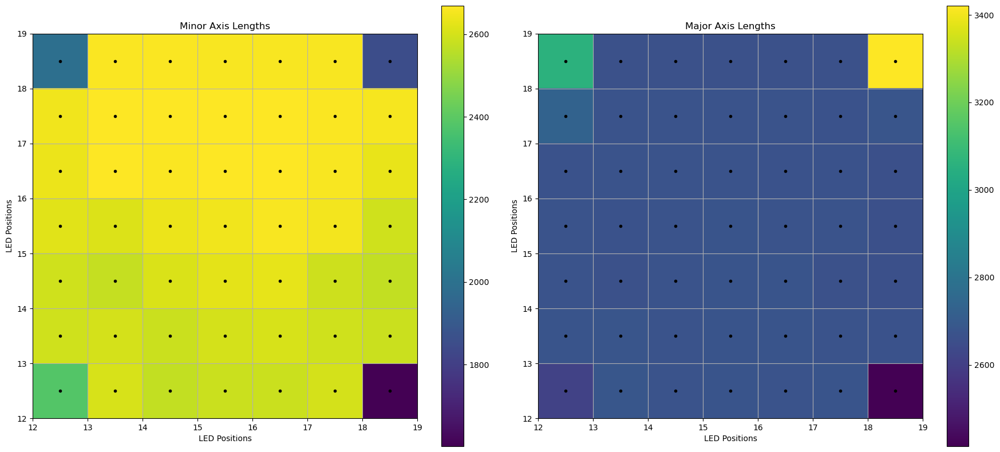

In [973]:
axis_lens_pro = axis_lens_cv2.copy()
axis_lens_pro[np.where(axis_lens_pro==0.)] = np.nan

fig, ax = plt.subplots(1, 2, figsize=(18, 8), layout='tight')

xx, yy = np.meshgrid([i for i in range(12, 19)], [i for i in range(12, 19)])

cp = ax[0].imshow(axis_lens_pro[:, :, 0].T, interpolation='none',
                  extent=[12, 19, 12, 19]
                 )
fig.colorbar(cp)
ax[0].grid()
ax[0].scatter(xx+0.5, yy+0.5, marker=".", color="black")
ax[0].set_title("Minor Axis Lengths")
ax[0].set_xlabel('LED Positions')
ax[0].set_ylabel('LED Positions')


cp = ax[1].imshow(axis_lens_pro[:, :, 1].T, interpolation='none', 
                 extent=[12, 19, 12, 19]
                 )
fig.colorbar(cp)
ax[1].grid()
ax[1].scatter(xx+0.5, yy+0.5, marker=".", color="black")
ax[1].set_title("Major Axis Lengths")
ax[1].set_xlabel('LED Positions')
ax[1].set_ylabel('LED Positions')

plt.show()

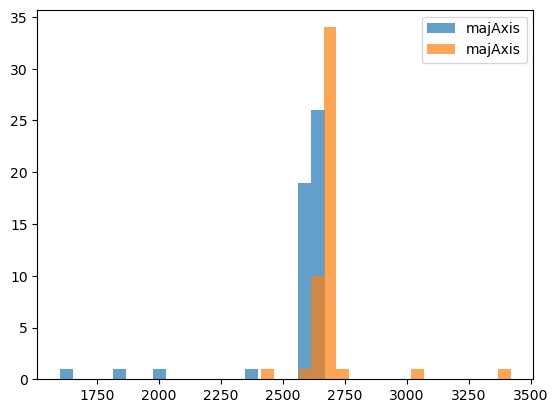

In [1179]:
axis_lens_pro = axis_lens_cv2.copy()
axis_lens_pro[np.where(axis_lens_pro==0.)] = np.nan

plt.hist(axis_lens_pro[:, :, 0].reshape(-1), label='majAxis', bins=20, alpha=0.7)
plt.hist(axis_lens_pro[:, :, 1].reshape(-1), label='majAxis', bins=20, alpha=0.7)
plt.legend()
plt.show()

In [ ]:
# fixing A, B, C, F

In [977]:
dir_path = "Z:/CSE\CSE-Research/Microscopy3D/CV_CSE_Collaboration/Results/CV_CSE/fpm_capture/output/2023_03_15/2023_03_15_16_02_07/"
file_path = f"2023_03_15_16_02_07_img_shutter_05_x_16_y_15_r_0_g_1_b_0.tiff"

        
img = cv2.imread(dir_path + file_path, cv2.IMREAD_UNCHANGED)
_, g_img, _ = cv2.split(img)
        
img_8 = cv2.convertScaleAbs(img, alpha=(255/65535))
g_img_8 = cv2.convertScaleAbs(g_img, alpha=(255/65535))

In [978]:
center, axis, f = fit_ellipse_3(file_path, img_8, g_img_8, ifHull=True, method='ivo') # good fit

[[-3.24326055e-07  4.75306325e-10  9.59646019e-04]
 [ 4.75306325e-10 -3.27813554e-07  3.93645616e-04]
 [ 9.59646019e-04  3.93645616e-04 -9.99999462e-01]]


In [ ]:
np.cos()

In [979]:
img = np.array(g_img_8, dtype=np.uint8)
op = contour_points_v2(img)
        
op[:20, :] = 0
op[-20:, :] = 0
        
op[:, :20] = 0
op[:, -20:] = 0

        
x, y = np.where(op > 1)
final_cnt = np.vstack([y, x]).T
        
if final_cnt.shape[0] > 10000:
    final_cnt = np.take(final_cnt, list(set(np.random.randint(0, final_cnt.shape[0], size=10000))), axis=0)

ellipsoid_points = np.array(final_cnt).reshape([-1, 2])
ellipsoid_points = np.array(ellipsoid_points).astype('float').T
ellipsoid_points

array([[ 529.,  530.,  531., ..., 2178., 2179., 2180.],
       [  93.,   93.,   93., ..., 3732., 3732., 3732.]])

In [987]:
b = -3.24326055e-07*x**2 + -3.27813554e-07*y**2 + f
A = np.array([x, y]).T
A, -b

(array([[  93,  529],
        [  93,  530],
        [  93,  531],
        ...,
        [3732, 2178],
        [3732, 2179],
        [3732, 2180]], dtype=int64),
 array([1.09454023, 1.09488739, 1.0952352 , ..., 7.07219959, 7.07362787,
        7.07505681]))

In [1012]:
np.linalg.lstsq(A, -b, rcond=None)

(array([0.00077151, 0.00194168]),
 array([0.65526845]),
 2,
 array([338927.99799414, 121566.05420793]))

In [991]:
9.59646019e-04*2, 3.93645616e-04*2

(0.001919292038, 0.000787291232)

In [1011]:
9.26610761e-04*2, -9.39963645e-04*2

(0.001853221522, -0.00187992729)

In [1072]:
b = 4.75306325e-10*x*y + -9.99999462e-01
A = np.array([x**2, y**2, x, y]).T
A, -b

(array([[    8649,   279841,       93,      529],
        [    8649,   280900,       93,      530],
        [    8649,   281961,       93,      531],
        ...,
        [13927824,  4743684,     3732,     2178],
        [13927824,  4748041,     3732,     2179],
        [13927824,  4752400,     3732,     2180]], dtype=int64),
 array([0.99997608, 0.99997603, 0.99997599, ..., 0.99613603, 0.99613426,
        0.99613248]))

In [1085]:
A, B, D, E = np.linalg.lstsq(A, -b, rcond=None)[0]

In [1087]:
A, B, D/2, E/2

(-3.268969844369404e-07,
 -3.236289044146954e-07,
 0.0003930310412070922,
 0.0009580904040238742)

In [12]:
def fit_ellipse_4(img_name, img_8, g_img_8, save_path=None):
        """ Find ellipse center position vector where A=-3.24326055e-07, B=0, C=-3.27813554e-07, F=-9.99999462e-01
        Parameters
        ----------
        Returns
        -------
        Ellipse
            Ellipse in an image.
        """

        ellipsoid_points=[]
           
        img = np.array(g_img_8, dtype=np.uint8)
        op = contour_points_v2(img)
        
        op[:20, :] = 0
        op[-20:, :] = 0
        
        op[:, :20] = 0
        op[:, -20:] = 0

        x, y = np.where(op > 0)
        final_cnt = np.vstack([y, x]).T

        if final_cnt is None:
            return None, None, None
        else:
            if final_cnt.shape[0] > 10000:
                final_cnt = np.take(final_cnt, list(set(np.random.randint(0, final_cnt.shape[0], size=10000))), axis=0)
            ellipsoid_points = np.array(final_cnt).reshape([-1, 2])
            
        
        ellipsoid_points = np.array(ellipsoid_points).astype('float').T
        ellipsoid_points = np.vstack( [ellipsoid_points, np.ones(ellipsoid_points.shape[1])] )
            
        is_det_ellipse = True
        
#         C = -3.24326055e-07
        B = 4.75306325e-10
#         A = -3.27813554e-07
        F = -9.99999462e-01*2
#         b = A*x**2 + B*x*y + C*y**2 + F
        b = B*x*y + F

#         eqs = np.array([x**2, y**2, x, y]).T
        
#         C, A, E, D = np.linalg.lstsq(eqs, -b, rcond=None)[0]/2
        
#         matC = np.array([[A, B, D/2], [B, C, E/2], [D/2, E/2, F]])

        eqs = np.array([x**2 + y**2, x, y]).T
        
        A, E, D = np.linalg.lstsq(eqs, -b, rcond=None)[0]/2
        
        matC = np.array([[A, B, D/2], [B, A, E/2], [D/2, E/2, F/2]])

        E = Ellipse( matC )
#         print(Ellipse.is_ellipsoid( E.C ))
        print(matC)
#         print(np.linalg.lstsq(eqs, -b, rcond=None))
            
        if Ellipse.is_ellipsoid( E.C ):
            S,R,T = Ellipse.decompose_ellipsoid(E.C)

            tx = T[0,2]
            ty = T[1,2]

            smin = S[0,0]
            smaj = S[1,1]
            
            theta = np.arctan2(R[1,0], R[0, 0])
#             print(theta)
            
                
#             f = E.C[-1, -1]
#             print(E.C)
        else:
            is_det_ellipse = False
             
        if is_det_ellipse:
            for i in range( 0, ellipsoid_points.shape[1] ):
                draw_cross(img_8, (ellipsoid_points[0,i],ellipsoid_points[1,i]), (0, 0, 255), length=20, thickness=5)
        
            cv2.ellipse(img_8, (int(tx), int(ty)), (int(smin), int(smaj)), theta, 0, 360, (255, 0, 0), 5)

            draw_cross(img_8, (tx, ty), (0, 255, 0))

#             plt.imshow(img_8)
#             plt.show()
            cv2.imshow('Resized Image', cv2.resize(img_8, (1080, 720), interpolation = cv2.INTER_LINEAR))
            cv2.waitKey(0)
            cv2.destroyAllWindows()
            
            if save_path is not None:
            
                cv2.imwrite(f'{save_path}/{img_name[:-5]}.png', img_8)
        
            return (int(tx), int(ty)), (int(smin), int(smaj)), theta
        else:
            return None, None, None

In [1166]:
dir_path = "Z:/CSE\CSE-Research/Microscopy3D/CV_CSE_Collaboration/Results/CV_CSE/fpm_capture/output/2023_03_15/2023_03_15_16_02_07/"
file_path = f"2023_03_15_16_02_07_img_shutter_05_x_15_y_17_r_0_g_1_b_0.tiff"

        
img = cv2.imread(dir_path + file_path, cv2.IMREAD_UNCHANGED)
_, g_img, _ = cv2.split(img)
        
img_8 = cv2.convertScaleAbs(img, alpha=(255/65535))
g_img_8 = cv2.convertScaleAbs(g_img, alpha=(255/65535))

In [1167]:
center, axis_size, f = fit_ellipse_4(file_path, img_8, g_img_8, save_path=None)

[[-9.96262090e-07  4.75306325e-10  2.74601838e-03]
 [ 4.75306325e-10 -9.96262090e-07  7.62551767e-04]
 [ 2.74601838e-03  7.62551767e-04 -9.99999462e-01]]


In [1169]:
# # grid based on thumbnail images
# fit_range_circle = np.zeros([7, 7], dtype=np.uint8)
# center_cords_circle = np.zeros([7, 7, 2], dtype=np.float64)
# axis_lens_circle = np.zeros([7, 7, 2], dtype=np.float64)

# save_dir = "C:/Users/Kazim/Desktop/Overall/VignettingCircleDetection/310823_circle_fit_tiff_size"
# for x in range(12, 19):
#     for y in range(12, 19):

#         dir_path = "Z:/CSE\CSE-Research/Microscopy3D/CV_CSE_Collaboration/Results/CV_CSE/fpm_capture/output/2023_03_15/2023_03_15_16_02_07/"
#         file_path = f"2023_03_15_16_02_07_img_shutter_05_x_{x}_y_{y}_r_0_g_1_b_0.tiff"
#         print('x:', x, 'y:', y, file_path)
        
#         img = cv2.imread(dir_path + file_path, cv2.IMREAD_UNCHANGED)
#         _, g_img, _ = cv2.split(img)

#         img_8 = cv2.convertScaleAbs(img, alpha=(255/65535))
#         g_img_8 = cv2.convertScaleAbs(g_img, alpha=(255/65535))
        
#         center, axis_size, f = fit_ellipse_4(file_path, img_8, g_img_8, save_path=save_dir)
        
#         if center is not None:
            
#             good_fit = input("Is it a good fit?")
#             fit_range_circle[x-12, y-12] = int(good_fit)
#             center_cords_circle[x-12, y-12] = center
#             axis_lens_circle[x-12, y-12] = axis_size

x: 12 y: 12 2023_03_15_16_02_07_img_shutter_05_x_12_y_12_r_0_g_1_b_0.tiff
[[-1.51944827e-07  4.75306325e-10  4.28640374e-04]
 [ 4.75306325e-10 -1.51944827e-07  2.64667160e-04]
 [ 4.28640374e-04  2.64667160e-04 -9.99999462e-01]]
Is it a good fit?5
x: 12 y: 13 2023_03_15_16_02_07_img_shutter_05_x_12_y_13_r_0_g_1_b_0.tiff
[[-8.05421194e-07  4.75306325e-10  1.84482464e-03]
 [ 4.75306325e-10 -8.05421194e-07  1.29403723e-03]
 [ 1.84482464e-03  1.29403723e-03 -9.99999462e-01]]
Is it a good fit?3
x: 12 y: 14 2023_03_15_16_02_07_img_shutter_05_x_12_y_14_r_0_g_1_b_0.tiff
[[ 1.82876905e-06  4.75306325e-10 -3.95544562e-03]
 [ 4.75306325e-10  1.82876905e-06 -2.53086219e-03]
 [-3.95544562e-03 -2.53086219e-03 -9.99999462e-01]]
Is it a good fit?1
x: 12 y: 15 2023_03_15_16_02_07_img_shutter_05_x_12_y_15_r_0_g_1_b_0.tiff
[[ 8.30978298e-07  4.75306325e-10 -1.78516376e-03]
 [ 4.75306325e-10  8.30978298e-07 -9.72636790e-04]
 [-1.78516376e-03 -9.72636790e-04 -9.99999462e-01]]
Is it a good fit?2
x: 12 y: 16 

[[-4.61463753e-07  4.75306325e-10  1.36490746e-03]
 [ 4.75306325e-10 -4.61463753e-07  3.52580456e-04]
 [ 1.36490746e-03  3.52580456e-04 -9.99999462e-01]]
Is it a good fit?2
x: 16 y: 18 2023_03_15_16_02_07_img_shutter_05_x_16_y_18_r_0_g_1_b_0.tiff
[[-5.47788559e-07  4.75306325e-10  1.61837109e-03]
 [ 4.75306325e-10 -5.47788559e-07  2.99621247e-04]
 [ 1.61837109e-03  2.99621247e-04 -9.99999462e-01]]
Is it a good fit?3
x: 17 y: 12 2023_03_15_16_02_07_img_shutter_05_x_17_y_12_r_0_g_1_b_0.tiff
[[-1.64699627e-07  4.75306325e-10  5.20141144e-04]
 [ 4.75306325e-10 -1.64699627e-07  2.94129674e-04]
 [ 5.20141144e-04  2.94129674e-04 -9.99999462e-01]]
Is it a good fit?2
x: 17 y: 13 2023_03_15_16_02_07_img_shutter_05_x_17_y_13_r_0_g_1_b_0.tiff
[[-1.84993418e-07  4.75306325e-10  5.83879266e-04]
 [ 4.75306325e-10 -1.84993418e-07  2.95225429e-04]
 [ 5.83879266e-04  2.95225429e-04 -9.99999462e-01]]
Is it a good fit?2
x: 17 y: 14 2023_03_15_16_02_07_img_shutter_05_x_17_y_14_r_0_g_1_b_0.tiff
[[-2.0792115

## Least Squraes Regression based Fit for A, E and D with fit_ellipse_4()

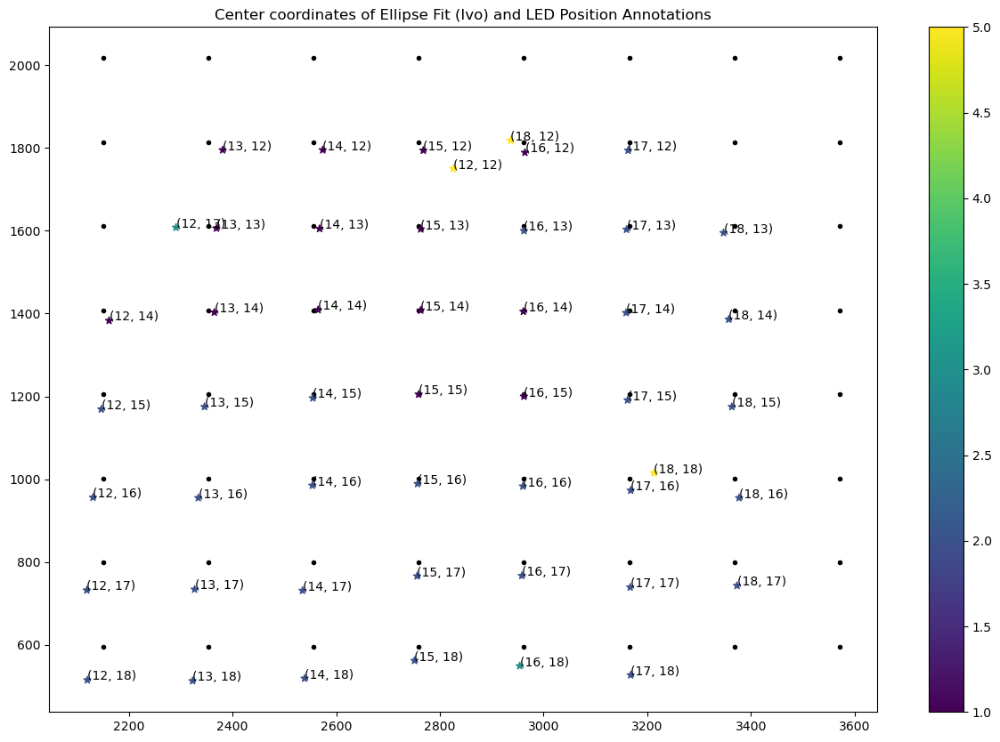

In [1170]:
plt.figure(figsize=(15, 10))

center_leds = center_cords_circle[3, 3]
y_unit_len = center_cords_circle[3, 2][1] - center_cords_circle[3, 3][1] 
x_unit_len = center_cords_circle[4, 3][0] - center_cords_circle[3, 3][0]

center_leds, y_unit_len, x_unit_len

x_axis = [center_leds[0] - i*x_unit_len for i in range(-4, 4)]
y_axis = [center_leds[1] - i*y_unit_len for i in range(-4, 4)]

xx, yy = np.meshgrid(x_axis, y_axis)
plt.scatter(xx, yy, marker=".", color='black')

x_cords = [x if x != 0.0 else np.nan for x in center_cords_circle.reshape([-1, 2])[:, 0]]
y_cords = [y if y != 0.0 else np.nan for y in center_cords_circle.reshape([-1, 2])[:, 1]]
fit_range_2 = [y if y != 0 else np.nan for y in fit_range_circle.reshape(-1)]


plt.scatter(x_cords, y_cords, marker="*", c=fit_range_2)
# plt.grid()

count = 0
for x in range(12, 19):
    for y in range(12, 19):
        plt.annotate(f"({x}, {y})",(x_cords[count], y_cords[count]), fontsize=10)
        count += 1

plt.title("Center coordinates of Ellipse Fit (Ivo) and LED Position Annotations")
# plt.xlim(210, 350)
# plt.ylim(40, 200)
plt.colorbar()
plt.show()

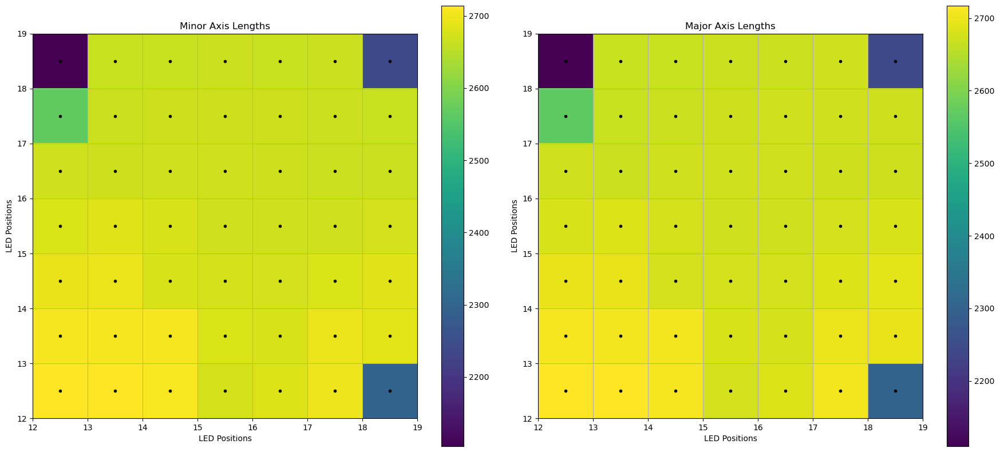

In [1171]:
axis_lens_pro = axis_lens_circle.copy()
axis_lens_pro[np.where(axis_lens_pro==0.)] = np.nan

fig, ax = plt.subplots(1, 2, figsize=(18, 8), layout='tight')

xx, yy = np.meshgrid([i for i in range(12, 19)], [i for i in range(12, 19)])

cp = ax[0].imshow(axis_lens_pro[:, :, 0].T, interpolation='none',
                  extent=[12, 19, 12, 19]
                 )
fig.colorbar(cp)
ax[0].grid()
ax[0].scatter(xx+0.5, yy+0.5, marker=".", color="black")
ax[0].set_title("Minor Axis Lengths")
ax[0].set_xlabel('LED Positions')
ax[0].set_ylabel('LED Positions')


cp = ax[1].imshow(axis_lens_pro[:, :, 1].T, interpolation='none', 
                 extent=[12, 19, 12, 19]
                 )
fig.colorbar(cp)
ax[1].grid()
ax[1].scatter(xx+0.5, yy+0.5, marker=".", color="black")
ax[1].set_title("Major Axis Lengths")
ax[1].set_xlabel('LED Positions')
ax[1].set_ylabel('LED Positions')

plt.show()

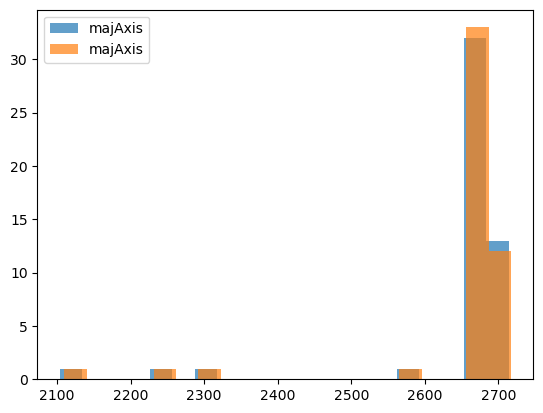

In [1180]:
axis_lens_pro = axis_lens_circle.copy()
axis_lens_pro[np.where(axis_lens_pro==0.)] = np.nan

plt.hist(axis_lens_pro[:, :, 0].reshape(-1), label='majAxis', bins=20, alpha=0.7)
plt.hist(axis_lens_pro[:, :, 1].reshape(-1), label='majAxis', bins=20, alpha=0.7)
plt.legend()
plt.show()

In [13]:
def fit_ellipse_4_stupid_ransac(img_name, img_8, g_img_8, num_points_to_sample=2000, iterations=10, save_path=None):
        """ Find ellipse center position vector where A=-3.24326055e-07, B=0, C=-3.27813554e-07, F=-9.99999462e-01
        Parameters
        ----------
        Returns
        -------
        Ellipse
            Ellipse in an image.
        """

        ellipsoid_points=[]
           
        img = np.array(g_img_8, dtype=np.uint8)
        op = contour_points_v2(img)
        
        op[:10, :] = 0
        op[-10:, :] = 0
        
        op[:, :10] = 0
        op[:, -10:] = 0

        x, y = np.where(op > 0)
        final_cnt = np.vstack([y, x]).T

        if final_cnt is None:
            return None, None, None
        else:
            if final_cnt.shape[0] > num_points_to_sample:
                final_cnt = np.take(final_cnt, list(set(np.random.randint(0, final_cnt.shape[0], size=num_points_to_sample))), axis=0)
#                 print(final_cnt.shape)
#                 print(final_cnt)
            ellipsoid_points = np.array(final_cnt).reshape([-1, 2])
#             print(ellipsoid_points.shape)
            
        
        ellipsoid_points = np.array(ellipsoid_points).astype('float').T
        ellipsoid_points = np.vstack( [ellipsoid_points, np.ones(ellipsoid_points.shape[1])] )
            
        is_det_ellipse = True
        
#         C = -3.24326055e-07
        B = 4.75306325e-10
#         A = -3.27813554e-07
        F = -9.99999462e-01*2
#         b = A*x**2 + B*x*y + C*y**2 + F
        
        x, y = final_cnt[:, 1], final_cnt[:, 0]
        b = B*x*y + F

        eqs = np.array([x**2 + y**2, x, y]).T
        
        sq_fit = np.linalg.lstsq(eqs, -b, rcond=None)
        A, E, D = sq_fit[0]/2

        residuals = np.matmul(np.array([x**2 + y**2, x, y]).T, [2*A, 2*E, 2*D]) + b
        print(f'0: {np.linalg.norm(residuals)}')
#         print(np.sort(residuals)[::-1][:15]**2)
        
        for i in range(iterations):        
            argmax = residuals.argsort()[-20:][::-1]
            final_cnt = np.delete(final_cnt, argmax, axis=0)

            x, y = final_cnt[:, 1], final_cnt[:, 0]
            b = B*x*y + F

            eqs = np.array([x**2 + y**2, x, y]).T

            sq_fit = np.linalg.lstsq(eqs, -b, rcond=None)
            A, E, D = sq_fit[0]/2

            residuals = np.matmul(np.array([x**2 + y**2, x, y]).T, [2*A, 2*E, 2*D]) + b

            print(f'{i+1}: {np.linalg.norm(residuals)}')
#             print(np.sort(residuals)[::-1][:15]**2)

        
        matC = np.array([[A, B, D/2], [B, A, E/2], [D/2, E/2, F/2]])

        E = Ellipse( matC )
#         print(Ellipse.is_ellipsoid( E.C ))
#         print(matC)
#         print(np.linalg.lstsq(eqs, -b, rcond=None))
            
        if Ellipse.is_ellipsoid( E.C ):
            S,R,T = Ellipse.decompose_ellipsoid(E.C)

            tx = T[0,2]
            ty = T[1,2]

            smin = S[0,0]
            smaj = S[1,1]
            
            theta = np.arctan2(R[1,0], R[0, 0])
#             print(theta)
            
                
#             f = E.C[-1, -1]
#             print(E.C)
        else:
            is_det_ellipse = False
             
        if is_det_ellipse:
            for i in range( 0, ellipsoid_points.shape[1] ):
                draw_cross(img_8, (ellipsoid_points[0,i],ellipsoid_points[1,i]), (0, 0, 255), length=20, thickness=5)
        
            cv2.ellipse(img_8, (int(tx), int(ty)), (int(smin), int(smaj)), theta, 0, 360, (255, 0, 0), 5)

            draw_cross(img_8, (tx, ty), (0, 255, 0))

#             plt.imshow(img_8)
#             plt.show()
            cv2.imshow('Resized Image', cv2.resize(img_8, (1080, 720), interpolation = cv2.INTER_LINEAR))
            cv2.waitKey(0)
            cv2.destroyAllWindows()
            
            if save_path is not None:
            
                cv2.imwrite(f'{save_path}/{img_name[:-5]}.png', img_8)
        
            return (int(tx), int(ty)), (int(smin), int(smaj)), theta
        else:
            return None, None, None

In [134]:
dir_path = "Z:/CSE\CSE-Research/Microscopy3D/CV_CSE_Collaboration/Results/CV_CSE/fpm_capture/output/2023_03_15/2023_03_15_16_02_07/"
file_path = f"2023_03_15_16_02_07_img_shutter_05_x_18_y_18_r_0_g_1_b_0.tiff"

        
img = cv2.imread(dir_path + file_path, cv2.IMREAD_UNCHANGED)
_, g_img, _ = cv2.split(img)

In [14]:
# np.random.seed(2)
    
# # grid based on thumbnail images
# fit_range_circle_iter = np.zeros([7, 7], dtype=np.uint8)
# center_cords_circle_iter = np.zeros([7, 7, 2], dtype=np.float64)
# axis_lens_circle_iter = np.zeros([7, 7, 2], dtype=np.float64)

# save_dir = "C:/Users/Kazim/Desktop/Overall/VignettingCircleDetection/310823_circle_iter_fit_tiff_size"
# for x in range(12, 19):
#     for y in range(12, 19):

#         dir_path = "Z:/CSE\CSE-Research/Microscopy3D/CV_CSE_Collaboration/Results/CV_CSE/fpm_capture/output/2023_03_15/2023_03_15_16_02_07/"
#         file_path = f"2023_03_15_16_02_07_img_shutter_05_x_{x}_y_{y}_r_0_g_1_b_0.tiff"
#         print('x:', x, 'y:', y, file_path)
        
#         img = cv2.imread(dir_path + file_path, cv2.IMREAD_UNCHANGED)
#         _, g_img, _ = cv2.split(img)

#         img_8 = cv2.convertScaleAbs(img, alpha=(255/65535))
#         g_img_8 = cv2.convertScaleAbs(g_img, alpha=(255/65535))
        
#         center, axis_size, f = fit_ellipse_4_stupid_ransac(file_path, img_8, g_img_8, num_points_to_sample=2000, 
#                                                            iterations=10, save_path=save_dir)
        
#         if center is not None:
            
#             good_fit = input("Is it a good fit?")
#             fit_range_circle_iter[x-12, y-12] = int(good_fit)
#             center_cords_circle_iter[x-12, y-12] = center
#             axis_lens_circle_iter[x-12, y-12] = axis_size

x: 12 y: 12 2023_03_15_16_02_07_img_shutter_05_x_12_y_12_r_0_g_1_b_0.tiff
0: 20.5704220924657
1: 20.411638772482917
2: 20.143170477624405
3: 19.643555622764538
4: 18.157343271262192
5: 12.29152406008125
6: 1.6314344090668467
7: 1.5779969524814406
8: 1.5397842754725057
9: 1.5057562645965468
10: 1.4750242120243569
Is it a good fit?1
x: 12 y: 13 2023_03_15_16_02_07_img_shutter_05_x_12_y_13_r_0_g_1_b_0.tiff
0: 5.8653172341717195
1: 5.582038242007653
2: 5.290316054749441
3: 4.99524088877848
4: 4.688428229662138
5: 4.384281332500998
6: 4.159156402148534
7: 3.9919146573340787
8: 3.896977109982126
9: 3.8100337626772114
10: 3.728288447442476
Is it a good fit?2
x: 12 y: 14 2023_03_15_16_02_07_img_shutter_05_x_12_y_14_r_0_g_1_b_0.tiff
0: 3.5902079940248495
1: 3.4591804994062274
2: 3.352404816533077
3: 3.252449759584019
4: 3.1566990197310405
5: 3.0652135186672074
6: 2.9752301506202152
7: 2.88882638793891
8: 2.805712317154255
9: 2.726922709902689
10: 2.6580234687286586
Is it a good fit?1
x: 12 y: 1

Is it a good fit?1
x: 15 y: 16 2023_03_15_16_02_07_img_shutter_05_x_15_y_16_r_0_g_1_b_0.tiff
0: 2.372760657014323
1: 2.309355794813653
2: 2.2557655129457825
3: 2.2073217712323303
4: 2.161690904703809
5: 2.116305573168592
6: 2.069990715554002
7: 2.02351681011232
8: 1.9761004745861885
9: 1.9286433096262847
10: 1.8808164720321137
Is it a good fit?2
x: 15 y: 17 2023_03_15_16_02_07_img_shutter_05_x_15_y_17_r_0_g_1_b_0.tiff
0: 4.422923530579537
1: 4.301079526438787
2: 4.1931284997878935
3: 4.0629489890794375
4: 3.8975941057304166
5: 3.6956071775516937
6: 3.4669724488683986
7: 3.281476693133121
8: 3.1331534541086836
9: 2.94223186108211
10: 2.7300502542821565
Is it a good fit?4
x: 15 y: 18 2023_03_15_16_02_07_img_shutter_05_x_15_y_18_r_0_g_1_b_0.tiff
0: 7.2196186072880915
1: 7.089296329189396
2: 6.961239330430815
3: 6.832470992590163
4: 6.702381550149271
5: 6.572596090852814
6: 6.44158949193341
7: 6.314016416593842
8: 6.201068447999578
9: 6.103637758183448
10: 6.007688289221982
Is it a good fi

## Iterative Least Squares Regression Fit for A, E and D with fit_ellipse_4_stupid_ransac()

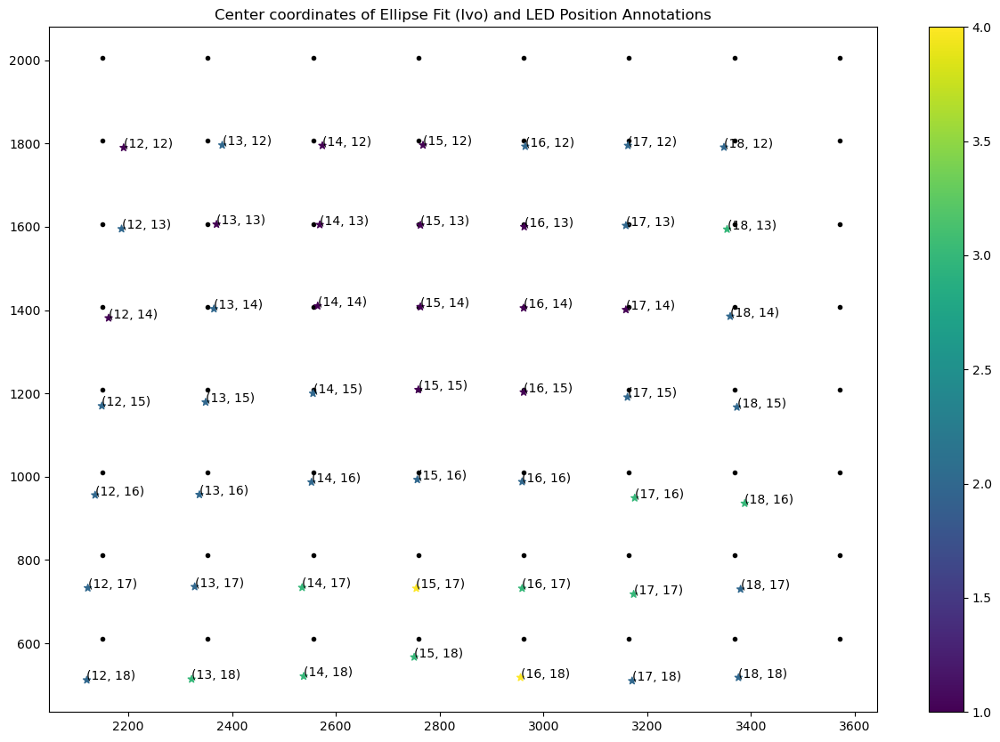

In [16]:
plt.figure(figsize=(15, 10))

center_leds = center_cords_circle_iter[3, 3]
y_unit_len = center_cords_circle_iter[3, 2][1] - center_cords_circle_iter[3, 3][1] 
x_unit_len = center_cords_circle_iter[4, 3][0] - center_cords_circle_iter[3, 3][0]

center_leds, y_unit_len, x_unit_len

x_axis = [center_leds[0] - i*x_unit_len for i in range(-4, 4)]
y_axis = [center_leds[1] - i*y_unit_len for i in range(-4, 4)]

xx, yy = np.meshgrid(x_axis, y_axis)
plt.scatter(xx, yy, marker=".", color='black')

x_cords = [x if x != 0.0 else np.nan for x in center_cords_circle_iter.reshape([-1, 2])[:, 0]]
y_cords = [y if y != 0.0 else np.nan for y in center_cords_circle_iter.reshape([-1, 2])[:, 1]]
fit_range_2 = [y if y != 0 else np.nan for y in fit_range_circle_iter.reshape(-1)]


plt.scatter(x_cords, y_cords, marker="*", c=fit_range_2)
# plt.grid()

count = 0
for x in range(12, 19):
    for y in range(12, 19):
        plt.annotate(f"({x}, {y})",(x_cords[count], y_cords[count]), fontsize=10)
        count += 1

plt.title("Center coordinates of Ellipse Fit (Ivo) and LED Position Annotations")
# plt.xlim(210, 350)
# plt.ylim(40, 200)
plt.colorbar()
plt.show()

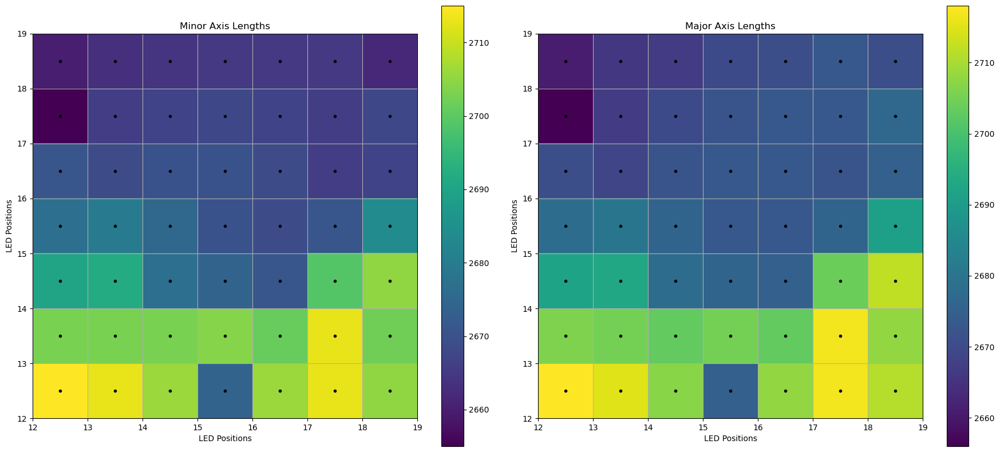

In [17]:
axis_lens_pro = axis_lens_circle_iter.copy()
axis_lens_pro[np.where(axis_lens_pro==0.)] = np.nan

fig, ax = plt.subplots(1, 2, figsize=(18, 8), layout='tight')

xx, yy = np.meshgrid([i for i in range(12, 19)], [i for i in range(12, 19)])

cp = ax[0].imshow(axis_lens_pro[:, :, 0].T, interpolation='none',
                  extent=[12, 19, 12, 19]
                 )
fig.colorbar(cp)
ax[0].grid()
ax[0].scatter(xx+0.5, yy+0.5, marker=".", color="black")
ax[0].set_title("Minor Axis Lengths")
ax[0].set_xlabel('LED Positions')
ax[0].set_ylabel('LED Positions')


cp = ax[1].imshow(axis_lens_pro[:, :, 1].T, interpolation='none', 
                 extent=[12, 19, 12, 19]
                 )
fig.colorbar(cp)
ax[1].grid()
ax[1].scatter(xx+0.5, yy+0.5, marker=".", color="black")
ax[1].set_title("Major Axis Lengths")
ax[1].set_xlabel('LED Positions')
ax[1].set_ylabel('LED Positions')

plt.show()

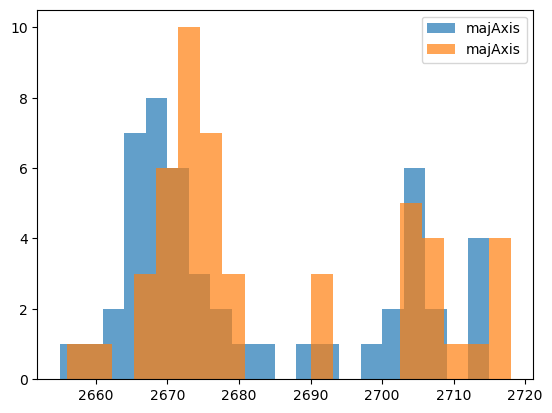

In [18]:
axis_lens_pro = axis_lens_circle_iter.copy()
axis_lens_pro[np.where(axis_lens_pro==0.)] = np.nan

plt.hist(axis_lens_pro[:, :, 0].reshape(-1), label='majAxis', bins=20, alpha=0.7)
plt.hist(axis_lens_pro[:, :, 1].reshape(-1), label='majAxis', bins=20, alpha=0.7)
plt.legend()
plt.show()

In [42]:
def fit_ellipse_5_stupid_ransac(img_name, img_8, g_img_8, num_points_to_sample=2000, iterations=10, save_path=None):
        """ Find ellipse center position vector where A=-3.24326055e-07, B=0, C=-3.27813554e-07, F=-9.99999462e-01
        Parameters
        ----------
        Returns
        -------
        Ellipse
            Ellipse in an image.
        """

        ellipsoid_points=[]
           
        img = np.array(g_img_8, dtype=np.uint8)
        op = contour_points_v2(img)
        
        op[:10, :] = 0
        op[-10:, :] = 0
        
        op[:, :10] = 0
        op[:, -10:] = 0

        x, y = np.where(op > 0)
        final_cnt = np.vstack([y, x]).T

        if final_cnt is None:
            return None, None, None
        else:
            if final_cnt.shape[0] > num_points_to_sample:
                final_cnt = np.take(final_cnt, list(set(np.random.randint(0, final_cnt.shape[0], size=num_points_to_sample))), axis=0)
#                 print(final_cnt.shape)
#                 print(final_cnt)
            ellipsoid_points = np.array(final_cnt).reshape([-1, 2])
#             print(ellipsoid_points.shape)
            
        
        ellipsoid_points = np.array(ellipsoid_points).astype('float').T
        ellipsoid_points = np.vstack( [ellipsoid_points, np.ones(ellipsoid_points.shape[1])] )
            
        is_det_ellipse = True
        
#         C = -3.24326055e-07
        B = 4.75306325e-10
        A = -5.178710794198162e-07
#         A = -3.27813554e-07
        F = -9.99999462e-01*2
#         b = A*x**2 + B*x*y + C*y**2 + F
        
        x, y = final_cnt[:, 1], final_cnt[:, 0]
        b = B*x*y + F + A*(x**2 + y**2)

        eqs = np.array([x, y]).T
        
        sq_fit = np.linalg.lstsq(eqs, -b, rcond=None)
        E, D = sq_fit[0]/2

        residuals = np.matmul(np.array([x, y]).T, [2*E, 2*D]) + b
        print(f'0: {np.linalg.norm(residuals)}')
#         print(np.sort(residuals)[::-1][:15]**2)
        
        for i in range(iterations):        
            argmax = residuals.argsort()[-20:][::-1]
            final_cnt = np.delete(final_cnt, argmax, axis=0)

            x, y = final_cnt[:, 1], final_cnt[:, 0]
            b = B*x*y + F + A*(x**2 + y**2)

            eqs = np.array([x, y]).T

            sq_fit = np.linalg.lstsq(eqs, -b, rcond=None)
            E, D = sq_fit[0]/2
#             print(A)
            residuals = np.matmul(np.array([x, y]).T, [2*E, 2*D]) + b

            print(f'{i+1}: {np.linalg.norm(residuals)}')
#             print(np.sort(residuals)[::-1][:15]**2)

        
        matC = np.array([[A/2, B, D/2], [B, A/2, E/2], [D/2, E/2, F/2]])

        E = Ellipse( matC )
#         print(Ellipse.is_ellipsoid( E.C ))
#         print(matC)
#         print(np.linalg.lstsq(eqs, -b, rcond=None))
            
        if Ellipse.is_ellipsoid( E.C ):
            S,R,T = Ellipse.decompose_ellipsoid(E.C)

            tx = T[0,2]
            ty = T[1,2]

            smin = S[0,0]
            smaj = S[1,1]
            
            theta = np.arctan2(R[1,0], R[0, 0])
#             print(theta)
            
                
#             f = E.C[-1, -1]
#             print(E.C)
        else:
            is_det_ellipse = False
             
        if is_det_ellipse:
            for i in range( 0, ellipsoid_points.shape[1] ):
                draw_cross(img_8, (ellipsoid_points[0,i],ellipsoid_points[1,i]), (0, 0, 255), length=20, thickness=5)
        
            cv2.ellipse(img_8, (int(tx), int(ty)), (int(smin), int(smaj)), theta, 0, 360, (255, 0, 0), 5)

            draw_cross(img_8, (tx, ty), (0, 255, 0))

#             plt.imshow(img_8)
#             plt.show()
            cv2.imshow('Resized Image', cv2.resize(img_8, (1080, 720), interpolation = cv2.INTER_LINEAR))
            cv2.waitKey(0)
            cv2.destroyAllWindows()
            
            if save_path is not None:
            
                cv2.imwrite(f'{save_path}/{img_name[:-5]}.png', img_8)
        
            return (int(tx), int(ty)), (int(smin), int(smaj)), theta
        else:
            return None, None, None

In [25]:
dir_path = "Z:/CSE\CSE-Research/Microscopy3D/CV_CSE_Collaboration/Results/CV_CSE/fpm_capture/output/2023_03_15/2023_03_15_16_02_07/"
file_path = f"2023_03_15_16_02_07_img_shutter_05_x_15_y_15_r_0_g_1_b_0.tiff"
        
img = cv2.imread(dir_path + file_path, cv2.IMREAD_UNCHANGED)
_, g_img, _ = cv2.split(img)

In [43]:
img_8 = cv2.convertScaleAbs(img, alpha=(255/65535))
g_img_8 = cv2.convertScaleAbs(g_img, alpha=(255/65535))
        
center, axis_size, f = fit_ellipse_5_stupid_ransac(file_path, img_8, g_img_8, num_points_to_sample=2000, 
                                                           iterations=1, save_path=save_dir)

0: 14.142050412148587
1: 14.073257721519221
